## 6ABOS EnMAP Atmospheric Correction Code

In [1]:
# Library:
from Py6S import *
import pandas as pd
import geopandas as gpd
import pandas_geojson as pdg
from IPython.display import display
import numpy as np
import csv
from osgeo import gdal
import numpy as np
import pandas as pd
import json
import os
import glob
from PIL import Image
import csv
import matplotlib.pyplot as plt
import rasterio
import math
import ee
import datetime
import re
import os
import glob

import xml.etree.ElementTree as ET
import xmltodict

from scipy.interpolate import interp1d
from scipy.signal import savgol_filter

In [27]:
# Configuration dictionary
conf = {"verbose":True, 
        "data exporting":False, 
        "data plotting":True, 
        "data storing": True, 
        "testing":True,
        "VNIR":False, 
        "GEE": False, 
        "max_wavelength": 2480,
        "min_wavelength": 379,
        "wavelength_step": 2.5,
        # Total transmissivity threshold of gases
        "tgas_threshold":0.75,
        # Replace with the actual path to the EnMAP L1 folder
        "input_dir": r'D:\EnMAP_L1\Lake_Constance\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z',
        # Replace with the actual path to the EnMAP L2 folder (6ABOS)
        "output_dir":'d:/6ABOS/',
        # Output: 1) Surface reflectance (output_rrs = False), 2) Remote sensing reflectance (output_rrs = True)
        "output_rrs":False}

In [3]:
# Google Earth Engine (GEE) Authentication & Initialization

# NOTE: Users must have a valid GEE account. 
# Replace the project ID below with your own Google Cloud Project ID.

if conf['GEE']:
    try:
        # Initial attempt using a specific User Project. 
        ee.Authenticate()
        ee.Initialize(project='abos-482615') #complete whit your personal/institutional project ID.
    except Exception as e:
        # Fallback mechanism: 
        # If the specific project initialization fails, it tries a default setup.
        # Check your GEE console if you encounter persistent permission errors.
        print(f"Warning: Project-specific GEE initialization failed: {e}")
        print("Attempting default GEE initialization...")
        ee.Authenticate()
        ee.Initialize()

### Functions definition

In [4]:
"""
atmospheric.py, Sam Murphy (2016-10-26)

Atmospheric water vapour, ozone and AOT from GEE

Usage
H2O = Atmospheric.water(geom,date)
O3 = Atmospheric.ozone(geom,date)
AOT = Atmospheric.aerosol(geom,date)

"""
import ee

class Atmospheric():

  def round_date(date,xhour):
    """
    rounds a date of to the closest 'x' hours
    """
    y = date.get('year')
    m = date.get('month')
    d = date.get('day')
    H = date.get('hour')
    HH = H.divide(xhour).round().multiply(xhour)
    return date.fromYMD(y,m,d).advance(HH,'hour')
  
  def round_month(date):
    """
    round date to closest month
    """
    # start of THIS month
    m1 = date.fromYMD(date.get('year'),date.get('month'),ee.Number(1))
    
    # start of NEXT month
    m2 = m1.advance(1,'month')
      
    # difference from date
    d1 = ee.Number(date.difference(m1,'day')).abs()
    d2 = ee.Number(date.difference(m2,'day')).abs()
    
    # return closest start of month
    return ee.Date(ee.Algorithms.If(d2.gt(d1),m1,m2))
  
  
  
  def water(geom,date):
    """
    Water vapour column above target at time of image aquisition.
    
    (Kalnay et al., 1996, The NCEP/NCAR 40-Year Reanalysis Project. Bull. 
    Amer. Meteor. Soc., 77, 437-471)
    """
    
    # Point geometry required
    centroid = geom.centroid()
    
    # H2O datetime is in 6 hour intervals
    H2O_date = Atmospheric.round_date(date,6)
    
    # filtered water collection
    water_ic = ee.ImageCollection('NCEP_RE/surface_wv').filterDate(H2O_date, H2O_date.advance(1,'month'))
    
    # water image
    water_img = ee.Image(water_ic.first())
    
    # water_vapour at target
    water = water_img.reduceRegion(reducer=ee.Reducer.mean(), geometry=centroid).get('pr_wtr')
                                        
    # convert to Py6S units (Google = kg/m^2, Py6S = g/cm^2)
    water_Py6S_units = ee.Number(water).divide(10)                                   
    
    return water_Py6S_units
  
  
  
  def ozone(geom,date):
    """
    returns ozone measurement from merged TOMS/OMI dataset
    
    OR
    
    uses our fill value (which is mean value for that latlon and day-of-year)
  
    """
    
    # Point geometry required
    centroid = geom.centroid()
       
    def ozone_measurement(centroid,O3_date):
      
      # filtered ozone collection
      ozone_ic = ee.ImageCollection('TOMS/MERGED').filterDate(O3_date, O3_date.advance(1,'month'))
      
      # ozone image
      ozone_img = ee.Image(ozone_ic.first())
      
      # ozone value IF TOMS/OMI image exists ELSE use fill value
      ozone = ee.Algorithms.If(ozone_img,\
      ozone_img.reduceRegion(reducer=ee.Reducer.mean(), geometry=centroid).get('ozone'),\
      ozone_fill(centroid,O3_date))
      
      return ozone
      
    def ozone_fill(centroid,O3_date):
      """
      Gets our ozone fill value (i.e. mean value for that doy and latlon)
      
      you can see it
      1) compared to LEDAPS: https://code.earthengine.google.com/8e62a5a66e4920e701813e43c0ecb83e
      2) as a video: https://www.youtube.com/watch?v=rgqwvMRVguI&feature=youtu.be
      
      """
      
      # ozone fills (i.e. one band per doy)
      ozone_fills = ee.ImageCollection('users/samsammurphy/public/ozone_fill').toList(366)
      
      # day of year index
      jan01 = ee.Date.fromYMD(O3_date.get('year'),1,1)
      doy_index = date.difference(jan01,'day').toInt()# (NB. index is one less than doy, so no need to +1)
      
      # day of year image
      fill_image = ee.Image(ozone_fills.get(doy_index))
      
      # return scalar fill value
      return fill_image.reduceRegion(reducer=ee.Reducer.mean(), geometry=centroid).get('ozone')
     
    # O3 datetime in 24 hour intervals
    O3_date = Atmospheric.round_date(date,24)
    
    # TOMS temporal gap
    TOMS_gap = ee.DateRange('1994-11-01','1996-08-01')  
    
    # avoid TOMS gap entirely
    ozone = ee.Algorithms.If(TOMS_gap.contains(O3_date),ozone_fill(centroid,O3_date),ozone_measurement(centroid,O3_date))
    
    # fix other data gaps (e.g. spatial, missing images, etc..)
    ozone = ee.Algorithms.If(ozone,ozone,ozone_fill(centroid,O3_date))
    
    #convert to Py6S units 
    ozone_Py6S_units = ee.Number(ozone).divide(1000)# (i.e. Dobson units are milli-atm-cm )                             
    
    return ozone_Py6S_units
 

  def aerosol(geom,date):
    """
    Aerosol Optical Thickness.
    
    try:
      MODIS Aerosol Product (monthly)
    except:
      fill value
    """
    
    def aerosol_fill(date):
      """
      MODIS AOT fill value for this month (i.e. no data gaps)
      """
      return ee.Image('users/samsammurphy/public/AOT_stack')\
               .select([ee.String('AOT_').cat(date.format('M'))])\
               .rename(['AOT_550'])
               
               
    def aerosol_this_month(date):
      """
      MODIS AOT original data product for this month (i.e. some data gaps)
      """
      # image for this month
      img =  ee.Image(\
                      ee.ImageCollection('MODIS/006/MOD08_M3')\
                        .filterDate(Atmospheric.round_month(date))\
                        .first()\
                     )
      
      # fill missing month (?)
      img = ee.Algorithms.If(img,\
                               # all good
                               img\
                               .select(['Aerosol_Optical_Depth_Land_Mean_Mean_550'])\
                               .divide(1000)\
                               .rename(['AOT_550']),\
                              # missing month
                                aerosol_fill(date))
                      
      return img    
        
  
    def get_AOT(AOT_band,geom):
      """
      AOT scalar value for target
      """  
      return ee.Image(AOT_band).reduceRegion(reducer=ee.Reducer.mean(),\
                                 geometry=geom.centroid())\
                                .get('AOT_550')
                                

    after_modis_start = date.difference(ee.Date('2000-03-01'),'month').gt(0)
    
    AOT_band = ee.Algorithms.If(after_modis_start, aerosol_this_month(date), aerosol_fill(date))
    
    AOT = get_AOT(AOT_band,geom)
    
    AOT = ee.Algorithms.If(AOT,AOT,get_AOT(aerosol_fill(date),geom))
    # i.e. check reduce region worked (else force fill value)
    
    return AOT

In [5]:
#
def parse_xml(xml_file):
  """Parses an XML file and prints its contents.

  Args:
    xml_file: Path to the XML file.
  """

  tree = ET.parse(xml_file)
  root = tree.getroot()
  startTime = root.find('.//startTime').text
  acquisition_date = startTime[0:10]
    
  for point in root.findall(".//spatialCoverage//boundingPolygon//point"):
            frame_element = point.find("frame")
            if frame_element is not None and frame_element.text == "center":
                latitude_element = float(point.find("latitude").text)
                longitude_element = float(point.find("longitude").text)

  scene_center_long = longitude_element
  scene_center_lat = latitude_element
    
  season = root.find('.//season').text
  ozoneValue = int(root.find('.//ozoneValue').text)
  sceneAOT = int(root.find('.//sceneAOT').text)
  sceneWV = int(root.find('.//sceneWV').text)
  sunElevationAngle = float(root.find('.//sunElevationAngle//center').text)
  sunAzimuthAngle = float(root.find('.//sunAzimuthAngle//center').text)
  viewingAzimuthAngle = float(root.find('.//viewingAzimuthAngle//center').text)
  viewingZenithAngle = float(root.find('.//viewingZenithAngle//center').text)
  meanGroundElevation  = float(root.find('.//meanGroundElevation').text)
  meanGroundElevation  = float(root.find('.//meanGroundElevation').text)
  
  # Dictionary with EnMAP scene parameters
  scene_parameters = {
        "startTime":  startTime,
        "acquisition_date" : acquisition_date,
        "scene_center_long" : scene_center_long ,
        "scene_center_lat" : scene_center_lat,
        "season" : season, 
        "meanGroundElevation" : meanGroundElevation,
        "ozoneValue": ozoneValue/1000,
        "sceneAOT": sceneAOT/1000,
        "sceneWV": sceneWV/1000, 
        "sunElevationAngle": sunElevationAngle, 
        "sunAzimuthAngle": sunAzimuthAngle,
        "viewingAzimuthAngle": viewingAzimuthAngle,
        "viewingZenithAngle": viewingZenithAngle
        }

  return scene_parameters

In [6]:
#
def get_enmap_band_parameters(xml_file):
    """
    Parses EnMAP L1C metadata to extract spectral characterization parameters.
    Returns a pandas DataFrame with band ID, center wavelength, FWHM, gain, and offset.
    """
    # Load and parse the XML file
    tree = ET.parse(xml_file)
    root = tree.getroot()
    
    bands_list = []
    
    # Locate the bandCharacterisation section which contains all bandID elements
    # Using findall with the specific path to ensure correct data retrieval
    for band in root.findall('.//bandCharacterisation/bandID'):
        # Extract the band number from the 'number' attribute
        band_id = int(band.get('number'))
        
        # Extract parameters using find().text and convert to float
        # These parameters are essential for Radiance conversion and 6S input
        band_data = {
            'band_id': band_id,
            'wavelength_center': float(band.find('wavelengthCenterOfBand').text),
            'fwhm': float(band.find('FWHMOfBand').text),
            'gain': float(band.find('GainOfBand').text),
            'offset': float(band.find('OffsetOfBand').text)
        }
        bands_list.append(band_data)
    
    # Convert the list of dictionaries into a structured DataFrame
    df = pd.DataFrame(bands_list)
    return df

In [7]:
def calculate_gaussian_srf(df_enmap, spectral_range):
    """
    Calculates the Gaussian Spectral Response Function for each band.
    Amplitude is normalized to 1 at the peak.
    """
    srf_results = []
    
    for index, row in df_enmap.iterrows():
        center = row['wavelength_center']
        fwhm = row['fwhm']
        
        # Calculate Sigma from FWHM
        sigma = fwhm / (2 * np.sqrt(2 * np.log(2)))
        
        # Apply Gaussian Formula: f(x) = a * exp(-(x-b)^2 / (2*sigma^2))
        # Amplitude (a) is set to 1
        gaussian_curve = np.exp(-((spectral_range - center)**2) / (2 * sigma**2))
        
        srf_results.append(gaussian_curve)
    
    # Create a DataFrame where columns are wavelengths and rows are bands
    df_srf = pd.DataFrame(srf_results, columns=spectral_range)
    df_srf.index = df_enmap['band_id']
    
    return df_srf

In [8]:
def atmospheric_correction(toa_radiance,ac_params,earth_sun_d,tgas_threshold):
    """
    Performs atmospheric correction to retrieve Bottom of Atmosphere (BOA) 
    reflectance and Remote Sensing Reflectance (Rrs).
    """
    # RTM Parameters
    
    # Solar irradiance: Direct and diffuse
    solar_diffuse_irrad = ac_params['diffuse_solar_irradiance']
    solar_direct_irrad = ac_params['direct_solar_irradiance']
    
    #Lpath is the radiance scattered by the atmosphere into the sensor’s field of view 
    L_path = ac_params['atmospheric_intrinsic_radiance']    

    # Total_gaseous_transmittance -> T_gT
    T_gT = float(ac_params['total_gaseous_transmittance'])
    
    # Total transmission of the Ozone -> Tg_O3:
    Tg_O3 = float(ac_params['ozone_transmittance_total'])
    
    # Total transmittance upward (Rayleigh + Aerosol) -> T_upward:
    T_upward = float(ac_params['total_scattering_transmittance_upward'])
    
    # Atmosphere spherical albedo -> s_atm:
    s_atm = float(ac_params['spherical_albedo'])
         
    #The solar constant integrated upon the filter response in [w/m2/sr/nm]
    Es = (solar_diffuse_irrad + solar_direct_irrad)
    
    # Top of Atmosphere radiance 
    l_toa_corrected = (toa_radiance * 1000.0) * (earth_sun_d**2)
    
    # Bottom of Atmosphere reflectance (Physical approach)
    if T_gT  > tgas_threshold:
        
        if conf['verbose']:
            print('Band with tgas > '+str(tgas_threshold)+' included from surface level reflectance ρs calculation')

        p_boa = (l_toa_corrected/Tg_O3 - L_path)/(Es*T_upward/np.pi + s_atm*(l_toa_corrected/Tg_O3 - L_path))
        
    else:
        if conf['verbose']:
            print('Band with tgas < '+str(tgas_threshold)+' excluded from surface level reflectance ρs calculation')
        p_boa = np.full(toa_radiance.shape, np.nan)
              
    # Rrs Calcutaions
    rrs = np.divide(p_boa, np.pi) # Calculate Rrs
        
    # Clean up edge cases (masking zeros or artifacts)
    #rrs[np.isnan(rrs)] = 0  
    
    # Convert variables to float 32 data format
    rrs = rrs.astype(np.float32)
    p_boa = p_boa.astype(np.float32)
    l_toa_corrected = l_toa_corrected.astype(np.float32)
                          
    return rrs,p_boa, l_toa_corrected

In [9]:
def save_enmap_cube_to_tiff(data_cube, output_path, reference_raster_path, metadata_df=None):
    """
    Saves a 3D NumPy EnMAP cube to a GeoTIFF, copying spatial metadata 
    from a reference file and injecting spectral metadata.

    Args:
        data_cube: NumPy array of shape [Bands, Rows, Cols]
        output_path: Path where the .tif will be saved.
        reference_raster_path: Path to one of the original EnMAP .tif files 
                               to copy the Geotransform and Projection.
        wavelengths: Optional list/array of wavelength centers for band metadata.
    """
    try:
        # Get dimensions from the data cube
        bands_count, rows, cols = data_cube.shape

        # Open reference raster to get spatial information
        ref_ds = gdal.Open(reference_raster_path)
        
        if ref_ds is None:
            raise Exception(f"Could not open reference raster: {reference_raster_path}")

        geotransform = ref_ds.GetGeoTransform()
        projection = ref_ds.GetProjection()
        ref_ds = None 

        # Create the output GeoTIFF
        # We use Float32 because Rrs data contains decimals and NaNs
        driver = gdal.GetDriverByName("GTiff")
        out_ds = driver.Create(output_path, cols, rows, bands_count, gdal.GDT_Float32)
        
        out_ds.SetGeoTransform(geotransform)
        out_ds.SetProjection(projection)

        # Get metada from metada dataframe
        wavelengths = metadata_df['wavelength_center'].values
        fwhms =  metadata_df['fwhm'].values
        gains =  metadata_df['gain'].values
        offsets =  metadata_df['offset'].values
        band_ids =  metadata_df['band_id'].values
        
        # Write data cube bands and metadata
        for i in range(bands_count):
            out_band = out_ds.GetRasterBand(i + 1)
            
            # Write the 2D array for the current band
            out_band.WriteArray(data_cube[i, :, :])

            # Set NoData Value as NaN
            out_band.SetNoDataValue(np.nan)

            # Inject Wavelength Metadata if provided
            if wavelengths is not None:
                wv = str(wavelengths[i])
                fw = str(fwhms[i])
                sc = str(gains[i])
                of = str(offsets[i])
                
                out_band.SetMetadataItem("WAVELENGTH", wv)
                out_band.SetMetadataItem("WAVELENGTH UNIT", "nm")
                out_band.SetMetadataItem("Offset", of)
                out_band.SetMetadataItem("Scale", sc)
                out_band.SetDescription(f"Band_{i+1}_{wv}nm")
            else:
                out_band.SetDescription(f"Band_{i+1}")

        # Finalize file
        out_ds.FlushCache()
        out_ds = None
        
        print(f"Successfully saved EnMAP cube to: {output_path}")

    except Exception as e:
        print(f"Failed to save raster: {e}")

### Metadata and atmospheric constituent preprocessing

In [10]:
# Path to TOA data definition
directory = conf['input_dir']

# Construct the search pattern

# L1 TOA data
path_to_toa_radiance = str(glob.glob(os.path.join(directory, f"*{'SPECTRAL_IMAGE.TIF'}"))[0])

# L1 metadata
path_to_xml_metadata =   str(glob.glob(os.path.join(directory,f"*{'METADATA.XML'}"))[0])

if conf['verbose']:
    print('Path_to_toa_radiance: ',path_to_toa_radiance)
    print('Metadata file: ',path_to_xml_metadata)

Path_to_toa_radiance:  D:\EnMAP_L1\Lake_Constance\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-SPECTRAL_IMAGE.TIF
Metadata file:  D:\EnMAP_L1\Lake_Constance\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-METADATA.XML


In [11]:
# EnMAP metadata file reading
scene_pam_dict = parse_xml(path_to_xml_metadata)

# 6S atmospheric constituents configuration
enmap_aod550 = scene_pam_dict['sceneAOT']
enmap_h2o = scene_pam_dict['sceneWV']
enmap_o3 = scene_pam_dict['ozoneValue']
alt  = scene_pam_dict['meanGroundElevation']

if conf['verbose']:
    print("The following metadata file is being read :",path_to_xml_metadata)
    print()
    print('\033[1m' + 'Metada of EnMAP-acquired scene'+ '\033[0m')
    print(scene_pam_dict)

if conf['GEE']:
    acquisition_date = ee.Date(scene_pam_dict['acquisition_date'])
    scene_center = ee.Geometry.Point(scene_pam_dict['scene_center_long'],scene_pam_dict['scene_center_lat'])

    enmap_h2o = Atmospheric.water(scene_center,acquisition_date).getInfo()
    enmap_o3 = Atmospheric.ozone(scene_center,acquisition_date).getInfo()
    enmap_aod550 = Atmospheric.aerosol(scene_center,acquisition_date).getInfo()

    SRTM = ee.Image('CGIAR/SRTM90_V4')# Shuttle Radar Topography mission covers *most* of the Earth
    alt = SRTM.reduceRegion(reducer = ee.Reducer.mean(),geometry = scene_center.centroid()).get('elevation').getInfo()
    
    print('\033[1m' + 'Atmospheric constituents retrieved from GEE catalogue' + '\033[0m')
    print('Target Altitude: '+ str(alt)+' km')
    print('H20: ', enmap_h2o)
    print('O3: ', enmap_o3) # cm-atm
    print('AOT 550 nm: ', enmap_aod550)

# Ground elevation compensation (Py6S requires altitude in kilometers)
if alt == None:
    target_alt = 0.0
else:
    if alt >= 0:
        target_alt = alt/1000.0
    else:
        target_alt = 0.0

The following metadata file is being read : D:\EnMAP_L1\Lake_Constance\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-METADATA.XML

Metada of EnMAP-acquired scene
{'startTime': '2025-04-03T10:57:53.536051Z', 'acquisition_date': '2025-04-03', 'scene_center_long': 9.543536975, 'scene_center_lat': 47.60896855, 'season': 'NA', 'meanGroundElevation': 599.09, 'ozoneValue': 0.33, 'sceneAOT': 0.029, 'sceneWV': 1.148, 'sunElevationAngle': 47.490074, 'sunAzimuthAngle': 169.983553, 'viewingAzimuthAngle': 275.043787884, 'viewingZenithAngle': 1.8451061519}


In [12]:
#Ozone Column: {200-500, AUT}: ozone value in Dobson units, AUT: Automatic

# Get the day and month as integers
date_obj = datetime.datetime.strptime(scene_pam_dict['acquisition_date'], '%Y-%m-%d')

acquisition_day = date_obj.day
acquisition_month = date_obj.month 

# Adquisition date
doy = date_obj.timetuple().tm_yday

# Earth-Sun distance (from day of year)
# http://physics.stackexchange.com/questions/177949/earth-sun-distance-on-a-given-day-of-the-year
earth_sun_d = 1 - 0.01672 * math.cos(0.9856 * (doy-4)) 

solar_Az =  scene_pam_dict['sunAzimuthAngle'] #Sun_Azimuth_angle 
solar_Zn =  90 - scene_pam_dict['sunElevationAngle'] #Sun_Zenith_angle = 90 - Sun_elevation_angle
view_Zn =   scene_pam_dict['viewingZenithAngle'] #View Zenith Angle 
view_Az =   scene_pam_dict['viewingAzimuthAngle'] #View Azimuth Angle

# Cosine of the solar azimuthal angle
cos_azs = math.cos(math.radians(solar_Zn))

if conf['verbose']:
    print('\033[1m' + '6S input parameters'+ '\033[0m')
    print('image acquisition date: ', date_obj)
    print('Sun-Earth distance in astronomic units: ',earth_sun_d**2)
    print('Day of the year', doy)
    print('EnMAP acquisition day ',acquisition_day)
    print('EnMAP acquisition month ',acquisition_month)
    print('Target Altitude: '+ str(target_alt)+' km')
    print('H20: ',enmap_h2o)
    print('O3: ',enmap_o3) # cm-atm
    print('AOT 550 nm: ',enmap_aod550)
    print('Sun_azimuth_angle: '+ str(solar_Az)+'°')
    print('Sun_zenith_angle: '+ str(solar_Zn)+'°')
    print('View Zenith Angle: ' + str(view_Zn)+'°')
    print('View Azimuth Angle: ' + str(view_Az)+'°')
    print('Cosine of the solar zenithal angle: ', cos_azs)
    print('Total transmissivity threshold of gases: ',conf['tgas_threshold'])

6S input parameters
image acquisition date:  2025-04-03 00:00:00
Sun-Earth distance in astronomic units:  0.9678312715566482
Day of the year 93
EnMAP acquisition day  3
EnMAP acquisition month  4
Target Altitude: 0.59909 km
H20:  1.148
O3:  0.33
AOT 550 nm:  0.029
Sun_azimuth_angle: 169.983553°
Sun_zenith_angle: 42.509926°
View Zenith Angle: 1.8451061519°
View Azimuth Angle: 275.043787884°
Cosine of the solar zenithal angle:  0.7371602855659823
Total transmissivity threshold of gases:  0.75


### 6S Radiative Transfer Model Execution

In [13]:
# ENMAP
# Instantiate
s = SixS()

###############################################################################################################
# Atmospheric constituents
s.atmos_profile = AtmosProfile.PredefinedType(AtmosProfile.MidlatitudeSummer)
s.aero_profile = AeroProfile.Continental
s.atmos_profile = AtmosProfile.UserWaterAndOzone(enmap_h2o,enmap_o3)
s.aot550 = enmap_aod550  

# Ground Reflectance-------------------------------------------------------------------------------------------:
s.ground_reflectance = GroundReflectance.HomogeneousLambertian(GroundReflectance.LakeWater)

# Earth-Sun-satellite geometry

# Geometries of view and illumination--------------------------------------------------------------------------:
s.geometry = Geometry.User()
s.geometry.day = acquisition_day
s.geometry.month = acquisition_month
s.geometry.solar_z = float(solar_Zn) # Solar zenith angle
s.geometry.solar_a = float(solar_Az) # Solar azimuth angle
s.geometry.view_z = float(view_Zn)   # View zenith angle
s.geometry.view_a = float(view_Az)   # View azimuth angle

# Altitudes---------------------------------------------------------------------------------------------------:
s.altitudes = Altitudes()
s.altitudes.set_sensor_satellite_level()  # Set the sensor altitude to be satellite level.
s.altitudes.set_target_custom_altitude(target_alt)  # The altitude of the target (in km).
###############################################################################################################

,band_id,wavelength_center,fwhm,gain,offset
0,1,418.416,6.99561,1.568445e-05,0.012318
1,2,424.043,6.66750,1.570222e-05,0.010041
2,3,429.457,6.42408,1.469639e-05,0.008886
3,4,434.686,6.25124,1.693228e-05,0.009232
4,5,439.757,6.13485,1.810620e-05,0.009411
...,...,...,...,...,...
219,220,2415.210,7.28832,4.695967e-07,-0.000691
220,221,2422.780,7.25659,6.575024e-07,-0.001006
221,222,2430.320,7.22434,6.760894e-07,-0.001067
222,223,2437.830,7.19152,5.700939e-07,-0.001006


SRF Matrix Shape (Bands x Wavelengths): (224, 841)


,379.0,381.5,384.0,386.5,389.0,391.5,394.0,396.5,399.0,401.5,...,2456.5,2459.0,2461.5,2464.0,2466.5,2469.0,2471.5,2474.0,2476.5,2479.0
band_id,,,,,,,,,,,,,,,,,,,,,
1,5.937111e-39,2.943714e-34,7.188807e-30,8.646872e-26,5.122738e-22,1.494810e-18,2.148379e-15,1.520816e-12,5.302532e-10,9.106067e-08,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,1.112049e-55,9.484052e-50,3.709283e-44,6.652915e-39,5.472173e-34,2.064114e-29,3.570535e-25,2.832428e-21,1.030411e-17,1.719047e-14,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,5.209283e-75,7.860695e-68,5.121832e-61,1.441024e-54,1.750646e-48,9.183475e-43,2.080162e-37,2.034551e-32,8.592537e-28,1.566952e-23,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,2.820136e-96,6.870980e-88,6.896072e-80,2.851145e-72,4.855918e-65,3.406888e-58,9.846429e-52,1.172288e-45,5.749419e-40,1.161578e-34,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5,7.920376e-119,2.617787e-109,3.445117e-100,1.805322e-91,3.766922e-83,3.129679e-75,1.035366e-67,1.363859e-60,7.153621e-54,1.494045e-47,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,2.259383e-39,3.407904e-44,2.676910e-49,1.095038e-54,2.332778e-60,2.588014e-66,1.495232e-72,4.498831e-79,7.049194e-86,5.752124e-93
221,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,9.991215e-27,1.003150e-30,5.215292e-35,1.403968e-39,1.957046e-44,1.412572e-49,5.279413e-55,1.021707e-60,1.023840e-66,5.312561e-73
222,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,1.538358e-16,1.053947e-19,3.716962e-23,6.747847e-27,6.305946e-31,3.033494e-35,7.511796e-40,9.575300e-45,6.283025e-50,2.122233e-55


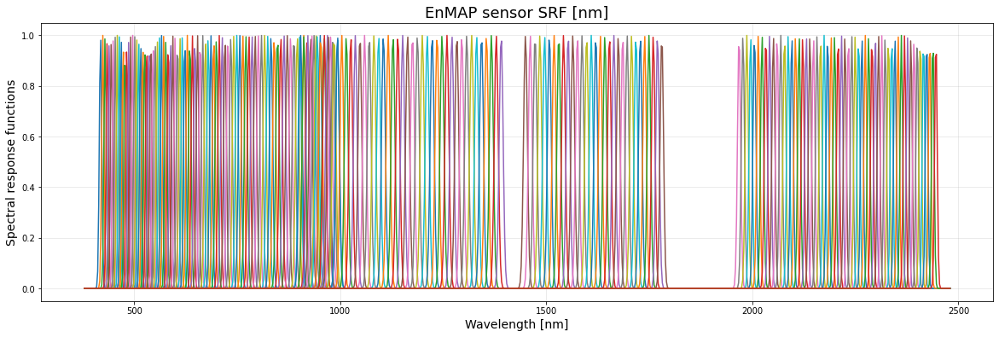

In [14]:
# Getting EnMAP's spectral configuration
enmap_spectral_conf_df = get_enmap_band_parameters(path_to_xml_metadata)

if conf['verbose']:
    display(enmap_spectral_conf_df)
    
# Definning the spectral range (379 to 1049 nm with 1nm step)

wv_min = conf['min_wavelength'] 
wv_max = conf['max_wavelength']  
wv_step = conf['wavelength_step']

spectral_range = np.arange(wv_min, wv_max, wv_step)

# Assuming df_enmap is the DataFrame from the previous step
df_srf_final = calculate_gaussian_srf(enmap_spectral_conf_df, spectral_range)

if conf['verbose']:
    print("SRF Matrix Shape (Bands x Wavelengths):", df_srf_final.shape)
    display(df_srf_final)

if conf['data plotting']:
    # Transpose the DataFrame so wavelengths are on the X-axis
    df_srf_final.T.plot(figsize=(20, 6), legend=None)
    
    plt.title('EnMAP sensor SRF [nm]', fontsize=18)
    plt.ylabel('Spectral response functions', fontsize=14)
    plt.xlabel('Wavelength [nm]', fontsize=14)
    plt.grid(True, alpha=0.3) # Added for better visualization of band overlaps

In [15]:
# Running 6S for EnMAP Hyperspectral Bands 

# Initialize results container
dictionary_enmap_6s = {}

for band_id in df_srf_final.index:
    
    # Get the SRF values for the current band (all wavelengths in the range)
    srf_values = df_srf_final.loc[band_id].values.tolist()
    
    # Define the wavelength range for 6S (Converting nm to micrometers)
    start_wv = wv_min / 1000.0
    end_wv = wv_max / 1000.0
    
    # Configure the 6S object with the custom Spectral Response Function
    s.wavelength = Wavelength(start_wv, end_wv, srf_values)
    
    # Run the atmospheric simulation
    s.run()
    
    # Extract and store the atmospheric parameters
    # We include all terms required by the 6ABOS physical inversion formula
    outputs = {
        # 1. Geometry & Albedo
        'spherical_albedo': s.outputs.spherical_albedo.total,
        
        # 2. Transmittances (Individual gases)
        'ozone_transmittance_total': s.outputs.transmittance_ozone.total,
        'water_transmittance_total': s.outputs.transmittance_water.total,
        
        # 3. Total Gaseous Transmittance (T_gT) - Product of all gas absorption
        'total_gaseous_transmittance': s.outputs.transmittance_global_gas.total,
        
        # 4. Scattering Transmittances
        'total_scattering_transmittance_upward': s.outputs.transmittance_total_scattering.upward,
        'total_scattering_transmittance_downward': s.outputs.transmittance_total_scattering.downward,
        
        # 5. Radiance & Irradiance (Crucial for the TOA to BOA equation)
        # We extract 'atmospheric_intrinsic_radiance' (L_path) 
        'atmospheric_intrinsic_radiance': s.outputs.atmospheric_intrinsic_radiance,
        'direct_solar_irradiance': s.outputs.direct_solar_irradiance,
        'diffuse_solar_irradiance': s.outputs.diffuse_solar_irradiance
    }
        
    # Save in the dictionary using the Band ID as key
    dictionary_enmap_6s[str(band_id)] = outputs

    if conf['verbose'] and int(band_id) % 20 == 0:
        print(f"6S simulation completed for Band {band_id}")

print(f"Total bands processed: {len(dictionary_enmap_6s)}")

6S simulation completed for Band 20
6S simulation completed for Band 40
6S simulation completed for Band 60
6S simulation completed for Band 80
6S simulation completed for Band 100
6S simulation completed for Band 120
6S simulation completed for Band 140
6S simulation completed for Band 160
6S simulation completed for Band 180
6S simulation completed for Band 200
6S simulation completed for Band 220
Total bands processed: 224


In [16]:
if conf['verbose']:
    display(dictionary_enmap_6s)

{'1': {'spherical_albedo': 0.19792,
  'ozone_transmittance_total': 1.0,
  'water_transmittance_total': 1.0,
  'total_gaseous_transmittance': 1.0,
  'total_scattering_transmittance_upward': 0.86997,
  'total_scattering_transmittance_downward': 0.83014,
  'atmospheric_intrinsic_radiance': 45.177,
  'direct_solar_irradiance': 833.592,
  'diffuse_solar_irradiance': 226.012},
 '2': {'spherical_albedo': 0.19018,
  'ozone_transmittance_total': 0.99991,
  'water_transmittance_total': 1.0,
  'total_gaseous_transmittance': 0.99991,
  'total_scattering_transmittance_upward': 0.87557,
  'total_scattering_transmittance_downward': 0.8371,
  'atmospheric_intrinsic_radiance': 41.195,
  'direct_solar_irradiance': 816.88,
  'diffuse_solar_irradiance': 208.897},
 '3': {'spherical_albedo': 0.18287,
  'ozone_transmittance_total': 0.99942,
  'water_transmittance_total': 1.0,
  'total_gaseous_transmittance': 0.99942,
  'total_scattering_transmittance_upward': 0.88112,
  'total_scattering_transmittance_downwa

### ATMOSPHERIC CORRECTION: TOA RADIANCE TO SURFACE REFLECTANCE

Total bands found: 224
Processing band # 1
Band ID  1.0
Band wavelength center 418.416
Band Gain  1.5684449211e-05
Band Offset  0.0123175726746
6S params for band 1: {'spherical_albedo': 0.19792, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 1.0, 'total_scattering_transmittance_upward': 0.86997, 'total_scattering_transmittance_downward': 0.83014, 'atmospheric_intrinsic_radiance': 45.177, 'direct_solar_irradiance': 833.592, 'diffuse_solar_irradiance': 226.012}
Performing 6ABOS atmospheric correction on EnMAP band: 418.416 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


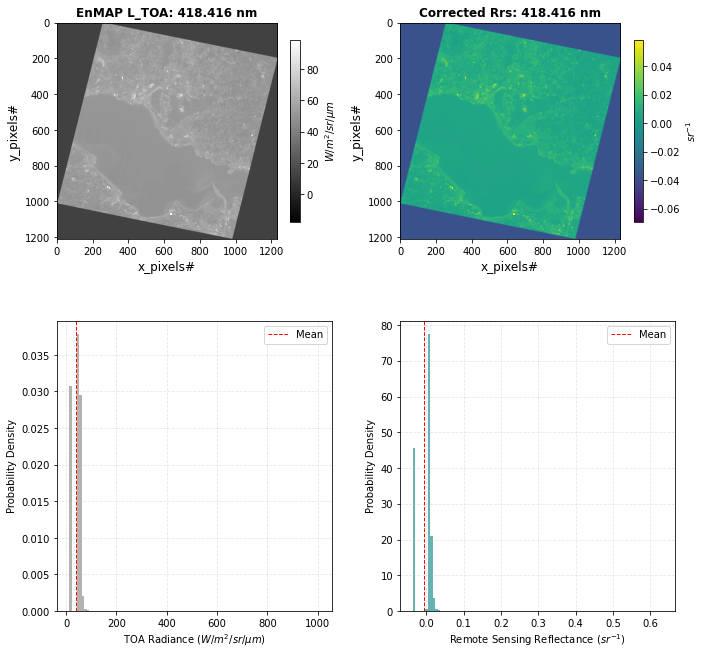

Processing band # 2
Band ID  2.0
Band wavelength center 424.043
Band Gain  1.57022176418e-05
Band Offset  0.010041446306
6S params for band 2: {'spherical_albedo': 0.19018, 'ozone_transmittance_total': 0.99991, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99991, 'total_scattering_transmittance_upward': 0.87557, 'total_scattering_transmittance_downward': 0.8371, 'atmospheric_intrinsic_radiance': 41.195, 'direct_solar_irradiance': 816.88, 'diffuse_solar_irradiance': 208.897}
Performing 6ABOS atmospheric correction on EnMAP band: 424.043 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


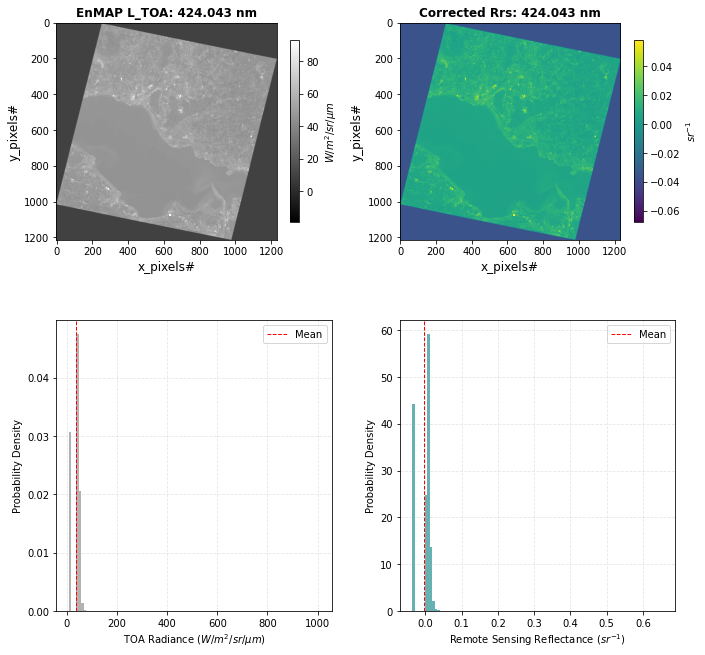

Processing band # 3
Band ID  3.0
Band wavelength center 429.457
Band Gain  1.46963940362e-05
Band Offset  0.0088859385504
6S params for band 3: {'spherical_albedo': 0.18287, 'ozone_transmittance_total': 0.99942, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99942, 'total_scattering_transmittance_upward': 0.88112, 'total_scattering_transmittance_downward': 0.844, 'atmospheric_intrinsic_radiance': 37.608, 'direct_solar_irradiance': 799.755, 'diffuse_solar_irradiance': 193.585}
Performing 6ABOS atmospheric correction on EnMAP band: 429.457 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


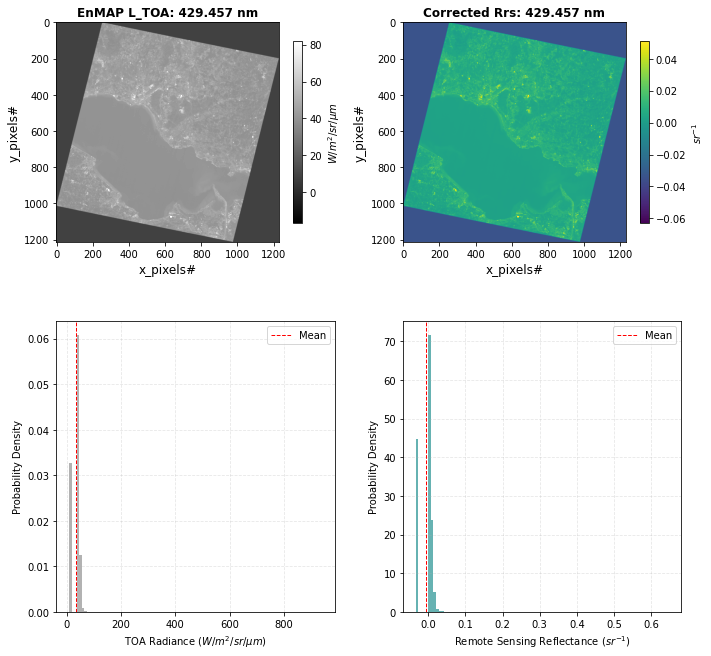

Processing band # 4
Band ID  4.0
Band wavelength center 434.686
Band Gain  1.69322758237e-05
Band Offset  0.00923161404885
6S params for band 4: {'spherical_albedo': 0.17627, 'ozone_transmittance_total': 0.9988, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.9988, 'total_scattering_transmittance_upward': 0.88634, 'total_scattering_transmittance_downward': 0.85051, 'atmospheric_intrinsic_radiance': 38.998, 'direct_solar_irradiance': 884.724, 'diffuse_solar_irradiance': 203.91}
Performing 6ABOS atmospheric correction on EnMAP band: 434.686 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


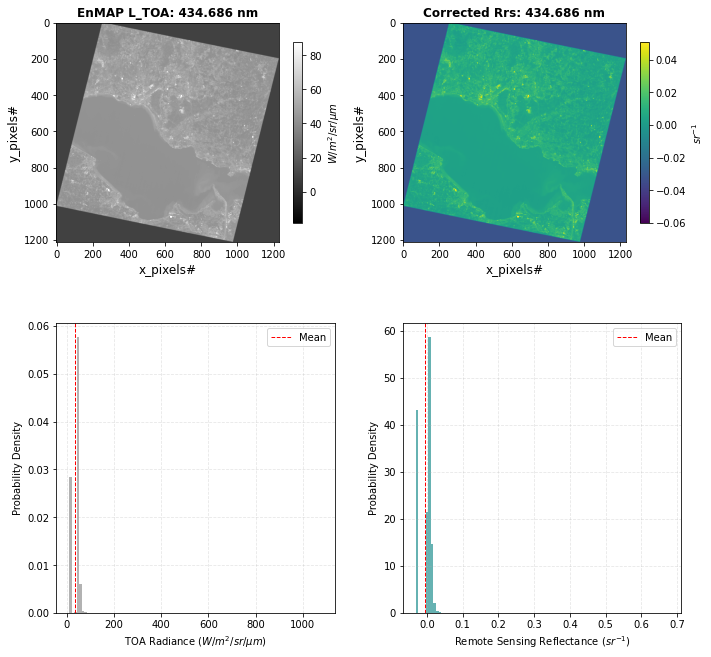

Processing band # 5
Band ID  5.0
Band wavelength center 439.757
Band Gain  1.81061982796e-05
Band Offset  0.00941135698709
6S params for band 5: {'spherical_albedo': 0.17024, 'ozone_transmittance_total': 0.99822, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99822, 'total_scattering_transmittance_upward': 0.89125, 'total_scattering_transmittance_downward': 0.85665, 'atmospheric_intrinsic_radiance': 39.188, 'direct_solar_irradiance': 944.404, 'diffuse_solar_irradiance': 208.189}
Performing 6ABOS atmospheric correction on EnMAP band: 439.757 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


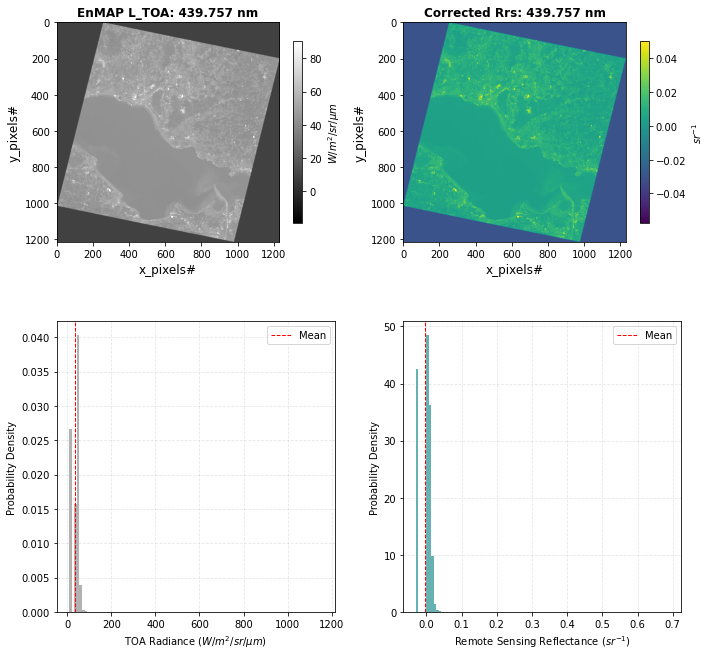

Processing band # 6
Band ID  6.0
Band wavelength center 444.699
Band Gain  1.86005728498e-05
Band Offset  0.00872269252965
6S params for band 6: {'spherical_albedo': 0.16451, 'ozone_transmittance_total': 0.99774, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99774, 'total_scattering_transmittance_upward': 0.89551, 'total_scattering_transmittance_downward': 0.86201, 'atmospheric_intrinsic_radiance': 39.966, 'direct_solar_irradiance': 1020.86, 'diffuse_solar_irradiance': 215.122}
Performing 6ABOS atmospheric correction on EnMAP band: 444.699 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


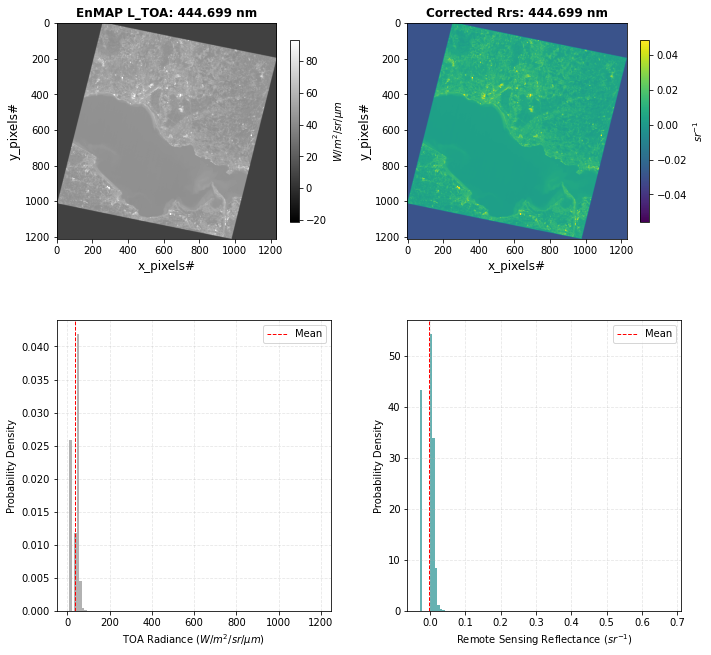

Processing band # 7
Band ID  7.0
Band wavelength center 449.539
Band Gain  1.92241596376e-05
Band Offset  0.00872122609594
6S params for band 7: {'spherical_albedo': 0.15915, 'ozone_transmittance_total': 0.99743, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99743, 'total_scattering_transmittance_upward': 0.89917, 'total_scattering_transmittance_downward': 0.86663, 'atmospheric_intrinsic_radiance': 40.008, 'direct_solar_irradiance': 1079.784, 'diffuse_solar_irradiance': 217.602}
Performing 6ABOS atmospheric correction on EnMAP band: 449.539 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


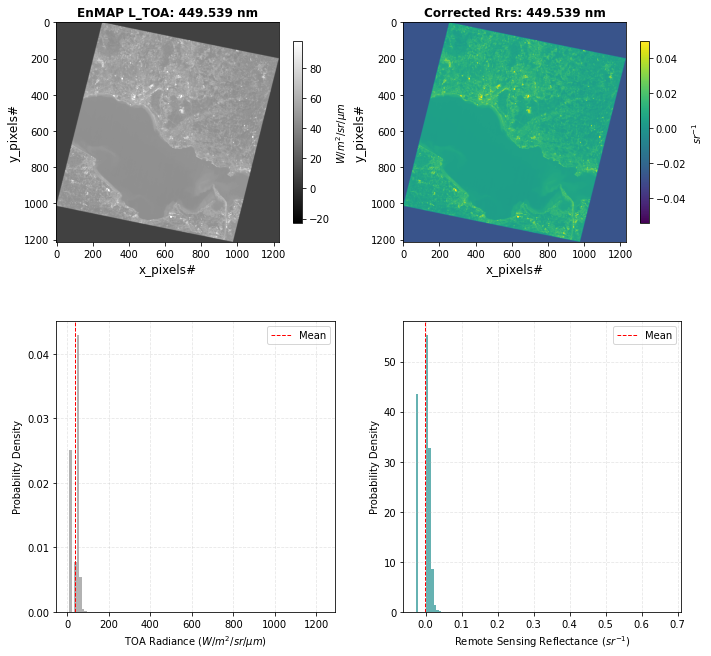

Processing band # 8
Band ID  8.0
Band wavelength center 454.306
Band Gain  1.93960775726e-05
Band Offset  0.0089908061738
6S params for band 8: {'spherical_albedo': 0.15405, 'ozone_transmittance_total': 0.99657, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99657, 'total_scattering_transmittance_upward': 0.90273, 'total_scattering_transmittance_downward': 0.87115, 'atmospheric_intrinsic_radiance': 38.348, 'direct_solar_irradiance': 1092.164, 'diffuse_solar_irradiance': 210.914}
Performing 6ABOS atmospheric correction on EnMAP band: 454.306 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


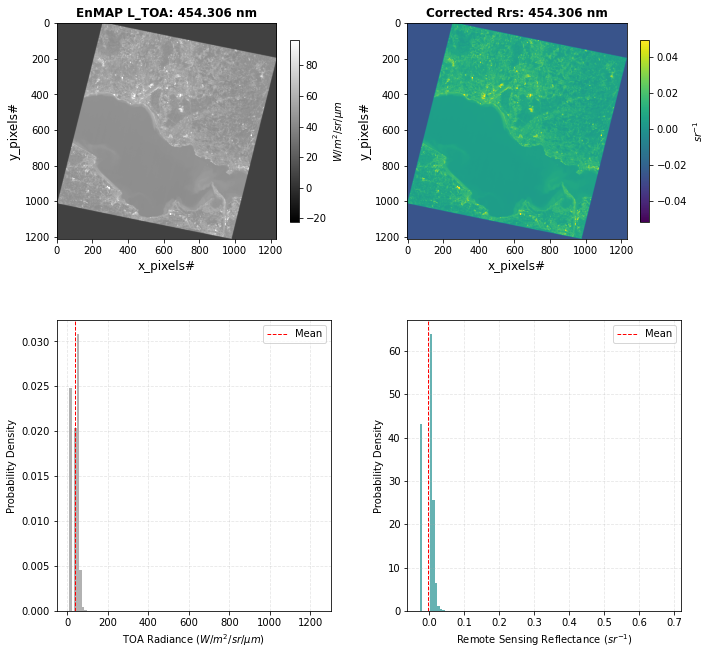

Processing band # 9
Band ID  9.0
Band wavelength center 459.031
Band Gain  1.87900245588e-05
Band Offset  0.00826093309071
6S params for band 9: {'spherical_albedo': 0.14919, 'ozone_transmittance_total': 0.99484, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99484, 'total_scattering_transmittance_upward': 0.90626, 'total_scattering_transmittance_downward': 0.87562, 'atmospheric_intrinsic_radiance': 36.781, 'direct_solar_irradiance': 1104.495, 'diffuse_solar_irradiance': 204.841}
Performing 6ABOS atmospheric correction on EnMAP band: 459.031 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


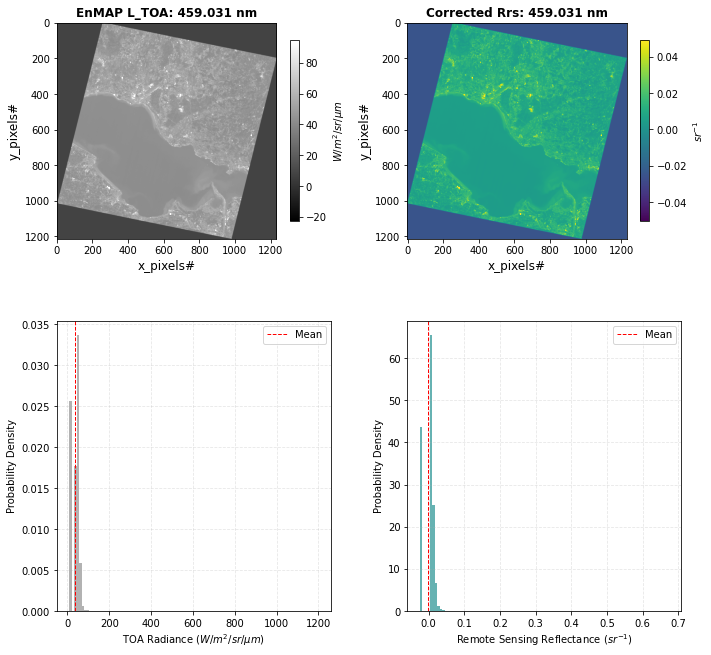

Processing band # 10
Band ID  10.0
Band wavelength center 463.73
Band Gain  1.88814406611e-05
Band Offset  0.00789056737671
6S params for band 10: {'spherical_albedo': 0.14456, 'ozone_transmittance_total': 0.99438, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99438, 'total_scattering_transmittance_upward': 0.90974, 'total_scattering_transmittance_downward': 0.88004, 'atmospheric_intrinsic_radiance': 35.021, 'direct_solar_irradiance': 1106.693, 'diffuse_solar_irradiance': 197.573}
Performing 6ABOS atmospheric correction on EnMAP band: 463.73 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


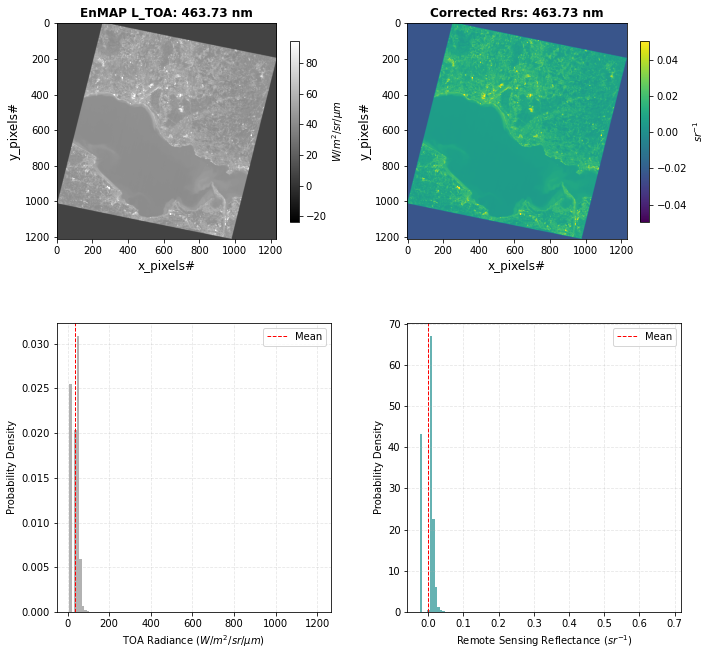

Processing band # 11
Band ID  11.0
Band wavelength center 468.411
Band Gain  1.86967493926e-05
Band Offset  0.00597054280173
6S params for band 11: {'spherical_albedo': 0.1401, 'ozone_transmittance_total': 0.99442, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99442, 'total_scattering_transmittance_upward': 0.91312, 'total_scattering_transmittance_downward': 0.88434, 'atmospheric_intrinsic_radiance': 33.375, 'direct_solar_irradiance': 1108.718, 'diffuse_solar_irradiance': 190.77}
Performing 6ABOS atmospheric correction on EnMAP band: 468.411 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


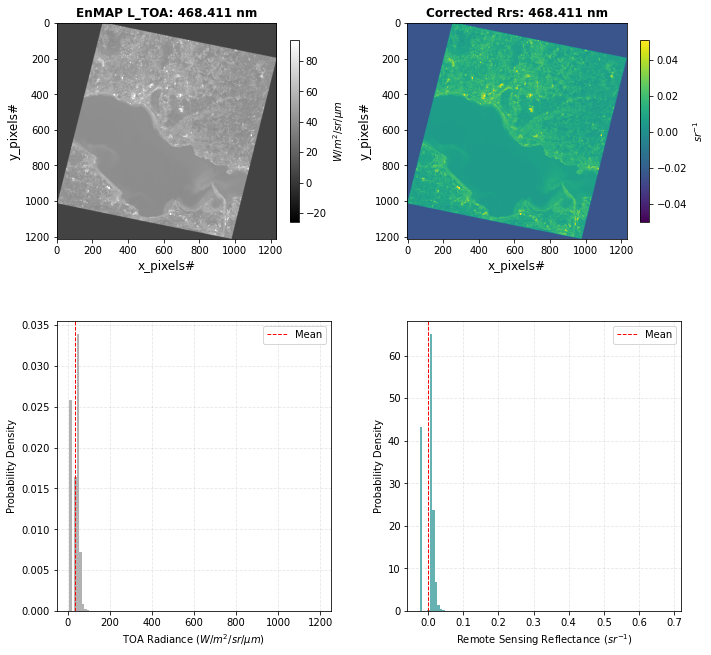

Processing band # 12
Band ID  12.0
Band wavelength center 473.08
Band Gain  1.81593707815e-05
Band Offset  0.00294456959152
6S params for band 12: {'spherical_albedo': 0.13578, 'ozone_transmittance_total': 0.99228, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.99228, 'total_scattering_transmittance_upward': 0.91613, 'total_scattering_transmittance_downward': 0.88819, 'atmospheric_intrinsic_radiance': 32.287, 'direct_solar_irradiance': 1127.757, 'diffuse_solar_irradiance': 186.764}
Performing 6ABOS atmospheric correction on EnMAP band: 473.08 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


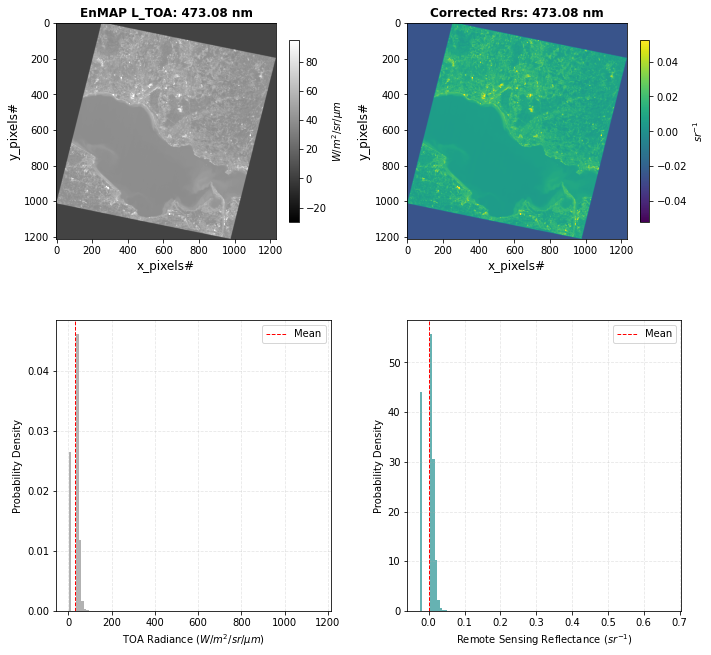

Processing band # 13
Band ID  13.0
Band wavelength center 477.744
Band Gain  1.74022970206e-05
Band Offset  0.000498807337932
6S params for band 13: {'spherical_albedo': 0.13167, 'ozone_transmittance_total': 0.98899, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.98899, 'total_scattering_transmittance_upward': 0.91894, 'total_scattering_transmittance_downward': 0.89178, 'atmospheric_intrinsic_radiance': 31.206, 'direct_solar_irradiance': 1145.085, 'diffuse_solar_irradiance': 182.67}
Performing 6ABOS atmospheric correction on EnMAP band: 477.744 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


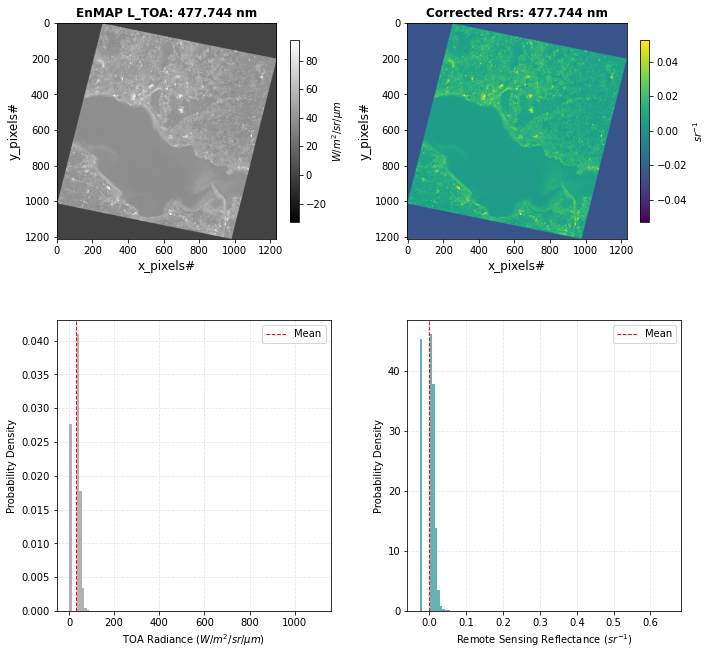

Processing band # 14
Band ID  14.0
Band wavelength center 482.411
Band Gain  1.69279155731e-05
Band Offset  -0.000622765997838
6S params for band 14: {'spherical_albedo': 0.12773, 'ozone_transmittance_total': 0.98642, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.98642, 'total_scattering_transmittance_upward': 0.92171, 'total_scattering_transmittance_downward': 0.89534, 'atmospheric_intrinsic_radiance': 28.74, 'direct_solar_irradiance': 1106.503, 'diffuse_solar_irradiance': 170.337}
Performing 6ABOS atmospheric correction on EnMAP band: 482.411 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


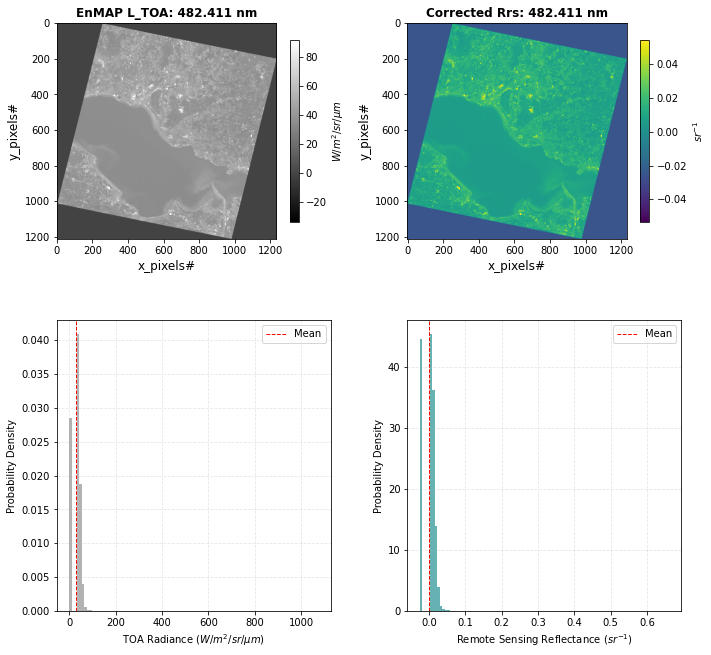

Processing band # 15
Band ID  15.0
Band wavelength center 487.087
Band Gain  1.67166898964e-05
Band Offset  -0.00314175305804
6S params for band 15: {'spherical_albedo': 0.12382, 'ozone_transmittance_total': 0.98576, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.98576, 'total_scattering_transmittance_upward': 0.92445, 'total_scattering_transmittance_downward': 0.89887, 'atmospheric_intrinsic_radiance': 27.173, 'direct_solar_irradiance': 1097.549, 'diffuse_solar_irradiance': 162.982}
Performing 6ABOS atmospheric correction on EnMAP band: 487.087 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


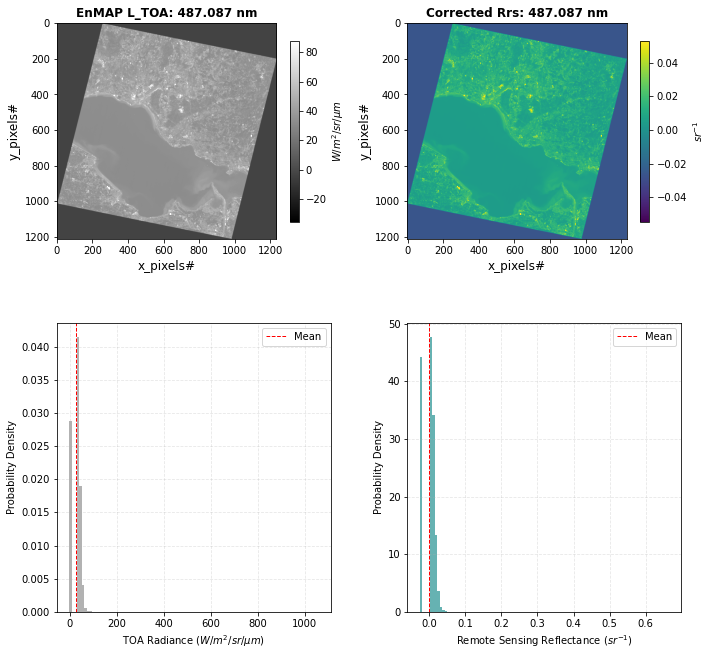

Processing band # 16
Band ID  16.0
Band wavelength center 491.78
Band Gain  1.64788297641e-05
Band Offset  -0.00539853610911
6S params for band 16: {'spherical_albedo': 0.12009, 'ozone_transmittance_total': 0.98472, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.98472, 'total_scattering_transmittance_upward': 0.92687, 'total_scattering_transmittance_downward': 0.90198, 'atmospheric_intrinsic_radiance': 26.62, 'direct_solar_irradiance': 1126.323, 'diffuse_solar_irradiance': 161.242}
Performing 6ABOS atmospheric correction on EnMAP band: 491.78 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


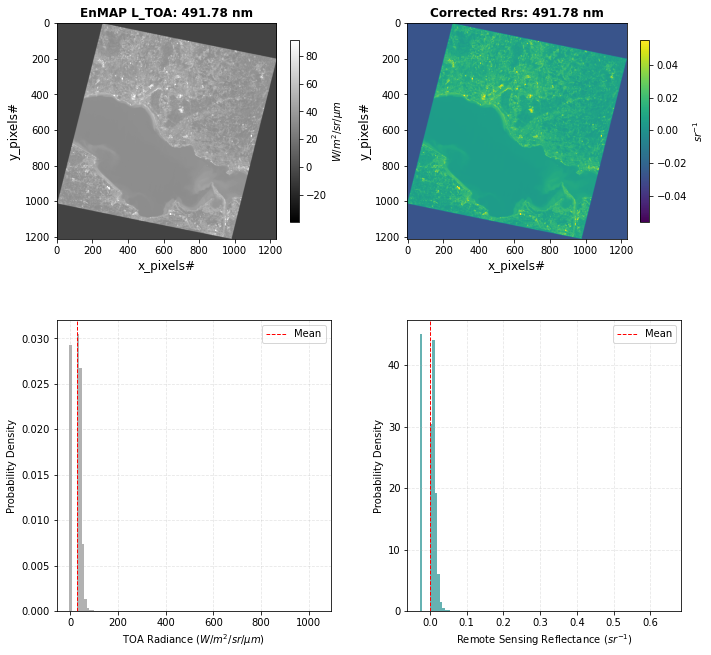

Processing band # 17
Band ID  17.0
Band wavelength center 496.497
Band Gain  1.60016178826e-05
Band Offset  -0.00653186916036
6S params for band 17: {'spherical_albedo': 0.11652, 'ozone_transmittance_total': 0.98066, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.98066, 'total_scattering_transmittance_upward': 0.92918, 'total_scattering_transmittance_downward': 0.90496, 'atmospheric_intrinsic_radiance': 25.334, 'direct_solar_irradiance': 1123.38, 'diffuse_solar_irradiance': 155.157}
Performing 6ABOS atmospheric correction on EnMAP band: 496.497 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


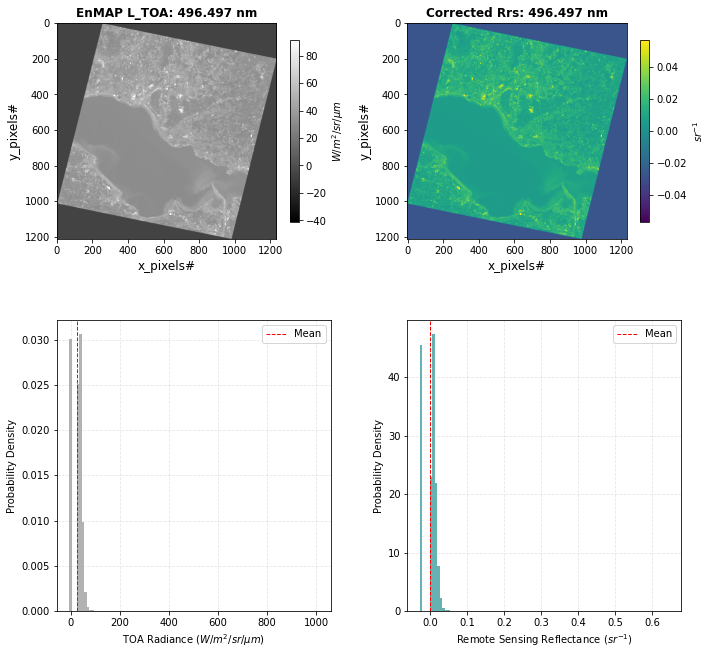

Processing band # 18
Band ID  18.0
Band wavelength center 501.243
Band Gain  1.55882581158e-05
Band Offset  -0.00705768378889
6S params for band 18: {'spherical_albedo': 0.11299, 'ozone_transmittance_total': 0.97469, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.97469, 'total_scattering_transmittance_upward': 0.93152, 'total_scattering_transmittance_downward': 0.90799, 'atmospheric_intrinsic_radiance': 24.024, 'direct_solar_irradiance': 1117.796, 'diffuse_solar_irradiance': 149.052}
Performing 6ABOS atmospheric correction on EnMAP band: 501.243 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


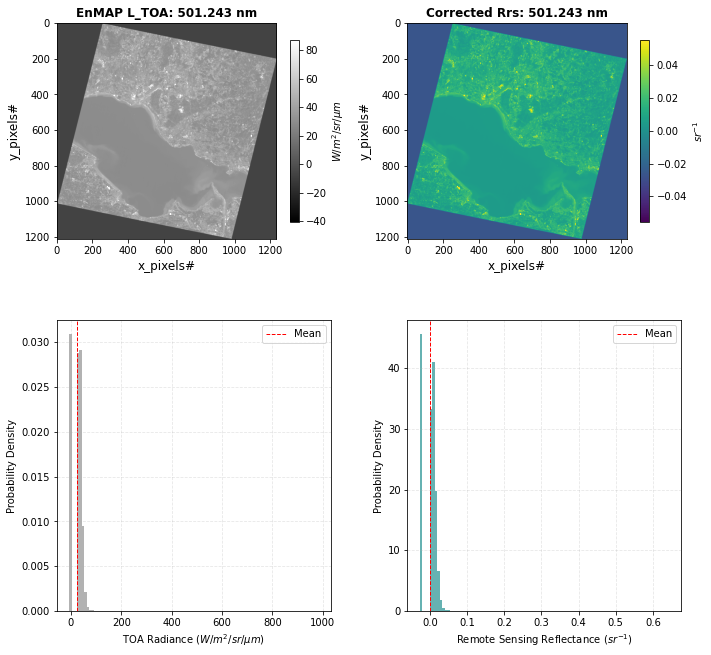

Processing band # 19
Band ID  19.0
Band wavelength center 506.02
Band Gain  1.53350234159e-05
Band Offset  -0.00898015020044
6S params for band 19: {'spherical_albedo': 0.10963, 'ozone_transmittance_total': 0.97102, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.97102, 'total_scattering_transmittance_upward': 0.93384, 'total_scattering_transmittance_downward': 0.91099, 'atmospheric_intrinsic_radiance': 23.23, 'direct_solar_irradiance': 1132.032, 'diffuse_solar_irradiance': 145.988}
Performing 6ABOS atmospheric correction on EnMAP band: 506.02 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


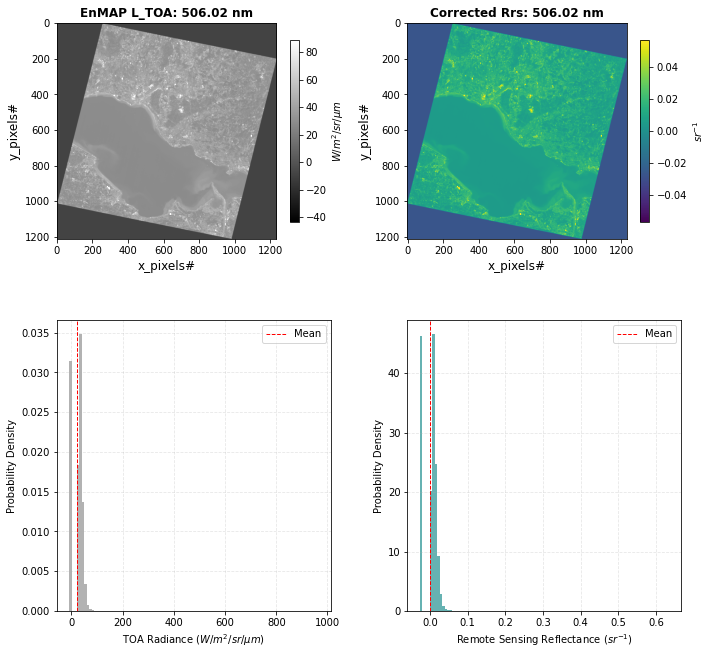

Processing band # 20
Band ID  20.0
Band wavelength center 510.828
Band Gain  1.48928536157e-05
Band Offset  -0.00953053224814
6S params for band 20: {'spherical_albedo': 0.10639, 'ozone_transmittance_total': 0.96995, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.96995, 'total_scattering_transmittance_upward': 0.93612, 'total_scattering_transmittance_downward': 0.91396, 'atmospheric_intrinsic_radiance': 21.886, 'direct_solar_irradiance': 1114.851, 'diffuse_solar_irradiance': 139.27}
Performing 6ABOS atmospheric correction on EnMAP band: 510.828 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


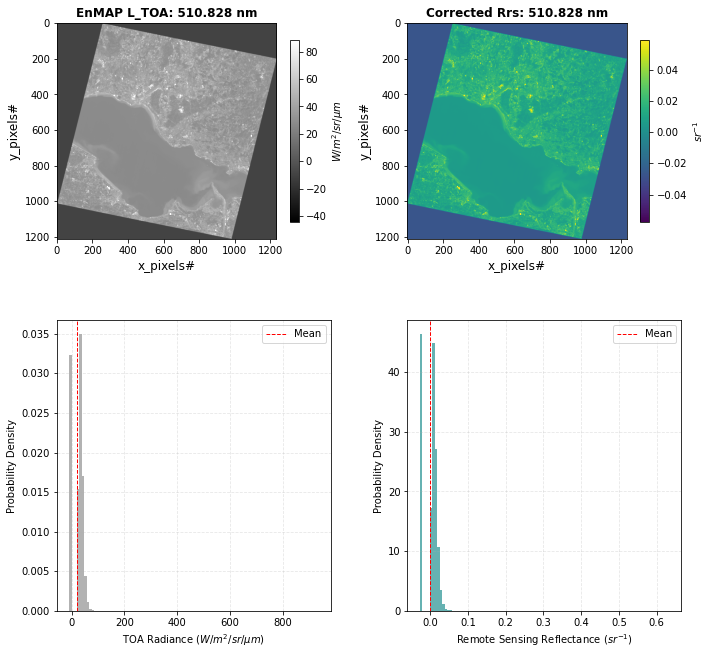

Processing band # 21
Band ID  21.0
Band wavelength center 515.672
Band Gain  1.46083968288e-05
Band Offset  -0.00894989971691
6S params for band 21: {'spherical_albedo': 0.1032, 'ozone_transmittance_total': 0.96751, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.96751, 'total_scattering_transmittance_upward': 0.93827, 'total_scattering_transmittance_downward': 0.91675, 'atmospheric_intrinsic_radiance': 20.279, 'direct_solar_irradiance': 1080.885, 'diffuse_solar_irradiance': 130.62}
Performing 6ABOS atmospheric correction on EnMAP band: 515.672 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


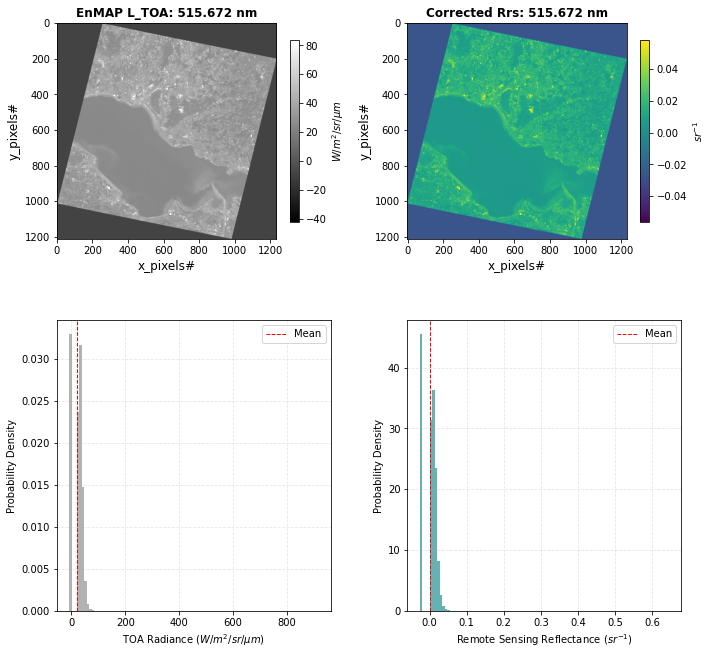

Processing band # 22
Band ID  22.0
Band wavelength center 520.55
Band Gain  1.46490988684e-05
Band Offset  -0.0107716232074
6S params for band 22: {'spherical_albedo': 0.10007, 'ozone_transmittance_total': 0.96288, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.96288, 'total_scattering_transmittance_upward': 0.94016, 'total_scattering_transmittance_downward': 0.91922, 'atmospheric_intrinsic_radiance': 19.458, 'direct_solar_irradiance': 1086.144, 'diffuse_solar_irradiance': 126.683}
Performing 6ABOS atmospheric correction on EnMAP band: 520.55 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


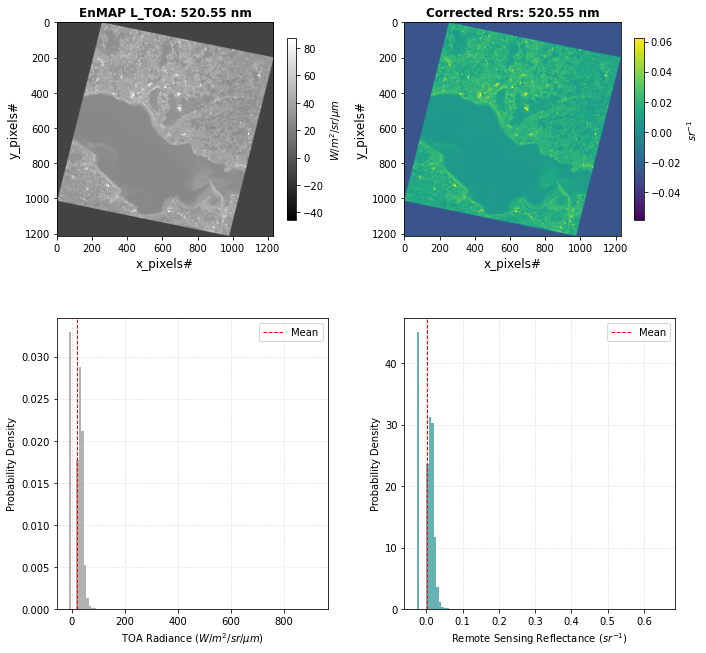

Processing band # 23
Band ID  23.0
Band wavelength center 525.467
Band Gain  1.43590848992e-05
Band Offset  -0.0101010333281
6S params for band 23: {'spherical_albedo': 0.09706, 'ozone_transmittance_total': 0.95738, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.95738, 'total_scattering_transmittance_upward': 0.94201, 'total_scattering_transmittance_downward': 0.92162, 'atmospheric_intrinsic_radiance': 19.122, 'direct_solar_irradiance': 1117.5, 'diffuse_solar_irradiance': 125.934}
Performing 6ABOS atmospheric correction on EnMAP band: 525.467 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


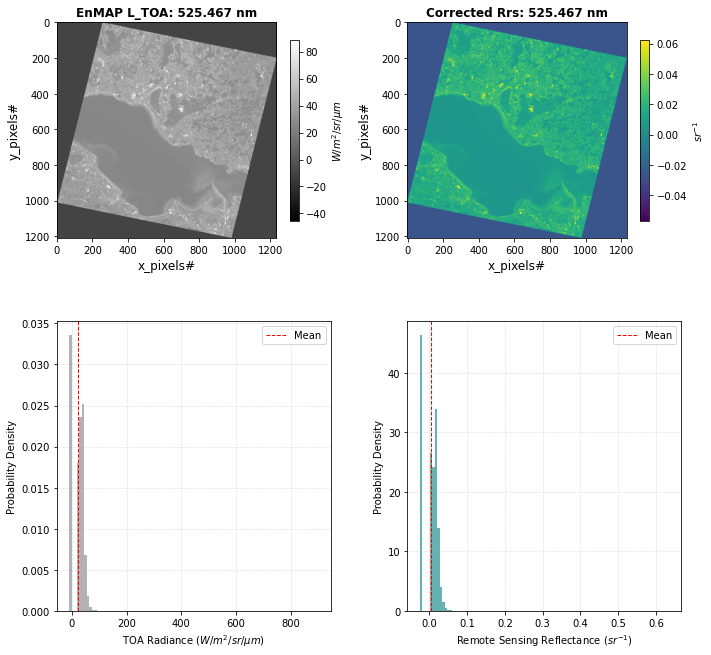

Processing band # 24
Band ID  24.0
Band wavelength center 530.424
Band Gain  1.37116604373e-05
Band Offset  -0.00955827886545
6S params for band 24: {'spherical_albedo': 0.09418, 'ozone_transmittance_total': 0.95159, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.95159, 'total_scattering_transmittance_upward': 0.94384, 'total_scattering_transmittance_downward': 0.92401, 'atmospheric_intrinsic_radiance': 18.586, 'direct_solar_irradiance': 1136.665, 'diffuse_solar_irradiance': 123.941}
Performing 6ABOS atmospheric correction on EnMAP band: 530.424 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


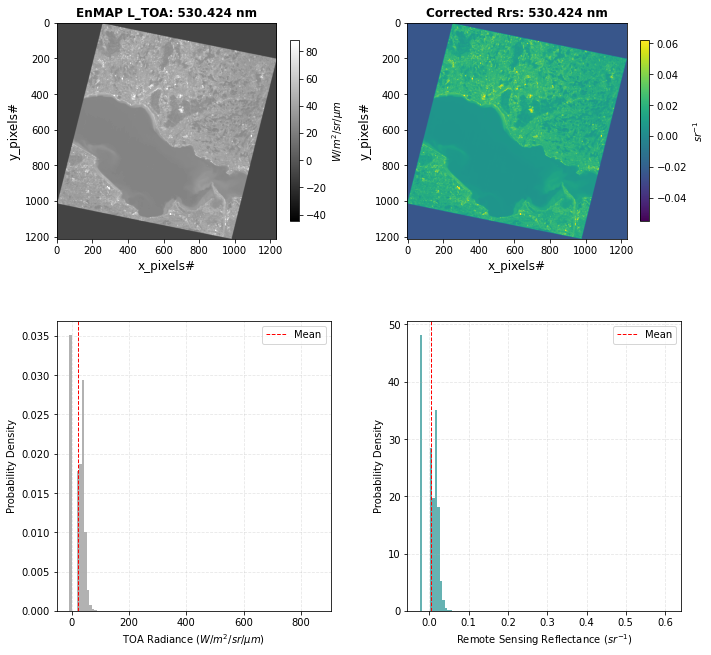

Processing band # 25
Band ID  25.0
Band wavelength center 535.422
Band Gain  1.33129558059e-05
Band Offset  -0.00943020608039
6S params for band 25: {'spherical_albedo': 0.09137, 'ozone_transmittance_total': 0.94757, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.94757, 'total_scattering_transmittance_upward': 0.94567, 'total_scattering_transmittance_downward': 0.92641, 'atmospheric_intrinsic_radiance': 17.667, 'direct_solar_irradiance': 1129.575, 'diffuse_solar_irradiance': 119.314}
Performing 6ABOS atmospheric correction on EnMAP band: 535.422 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


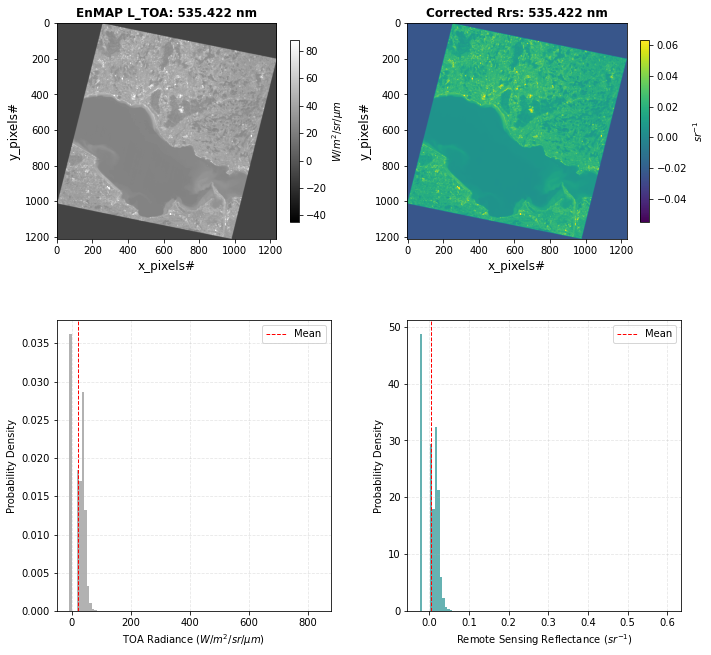

Processing band # 26
Band ID  26.0
Band wavelength center 540.463
Band Gain  1.2977934118e-05
Band Offset  -0.00876786089563
6S params for band 26: {'spherical_albedo': 0.08863, 'ozone_transmittance_total': 0.94428, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.94428, 'total_scattering_transmittance_upward': 0.94753, 'total_scattering_transmittance_downward': 0.92884, 'atmospheric_intrinsic_radiance': 16.797, 'direct_solar_irradiance': 1122.633, 'diffuse_solar_irradiance': 114.98}
Performing 6ABOS atmospheric correction on EnMAP band: 540.463 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


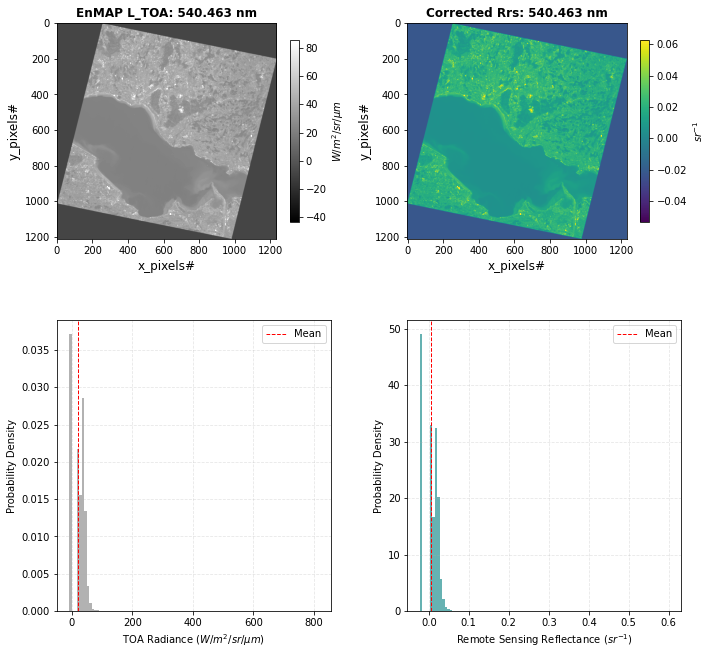

Processing band # 27
Band ID  27.0
Band wavelength center 545.551
Band Gain  1.28390991528e-05
Band Offset  -0.00855260237841
6S params for band 27: {'spherical_albedo': 0.08598, 'ozone_transmittance_total': 0.94034, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.94034, 'total_scattering_transmittance_upward': 0.94937, 'total_scattering_transmittance_downward': 0.93125, 'atmospheric_intrinsic_radiance': 16.188, 'direct_solar_irradiance': 1130.756, 'diffuse_solar_irradiance': 112.445}
Performing 6ABOS atmospheric correction on EnMAP band: 545.551 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


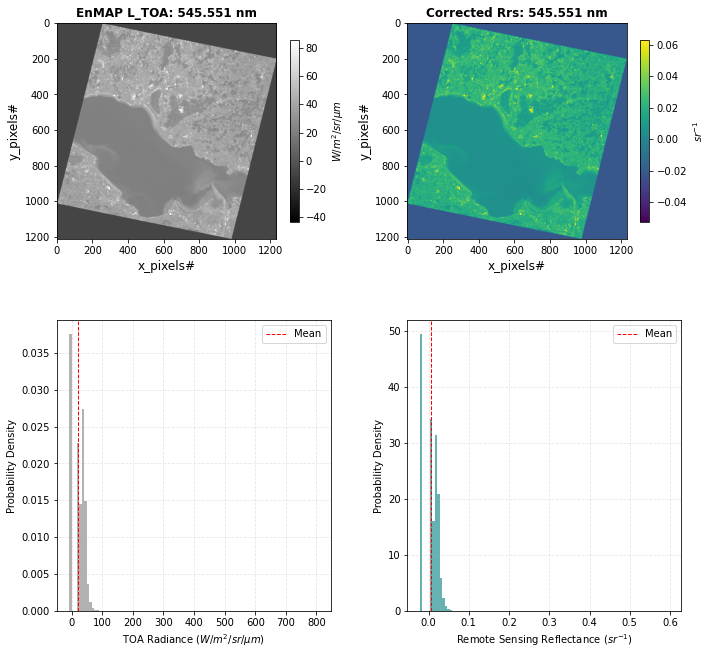

Processing band # 28
Band ID  28.0
Band wavelength center 550.687
Band Gain  1.26660370385e-05
Band Offset  -0.00868814816113
6S params for band 28: {'spherical_albedo': 0.08341, 'ozone_transmittance_total': 0.9353, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.9353, 'total_scattering_transmittance_upward': 0.95106, 'total_scattering_transmittance_downward': 0.93347, 'atmospheric_intrinsic_radiance': 15.499, 'direct_solar_irradiance': 1131.776, 'diffuse_solar_irradiance': 109.162}
Performing 6ABOS atmospheric correction on EnMAP band: 550.687 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


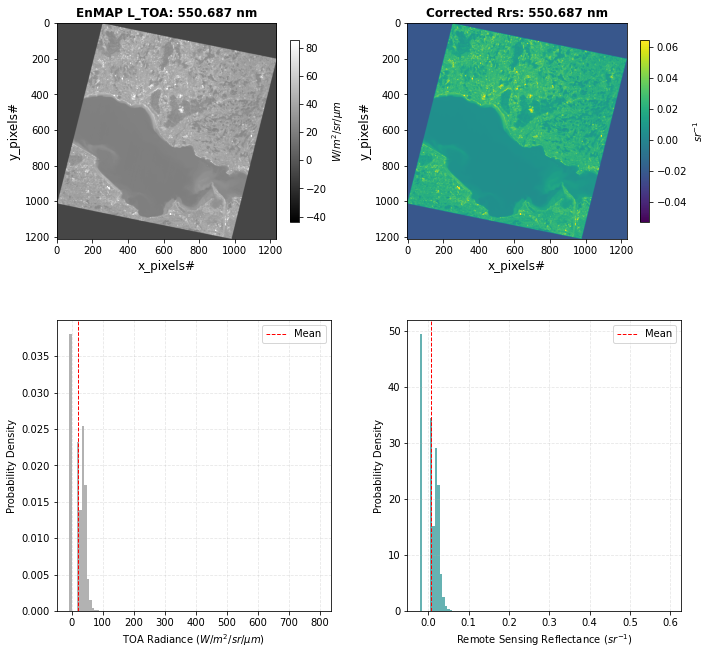

Processing band # 29
Band ID  29.0
Band wavelength center 555.873
Band Gain  1.23016377752e-05
Band Offset  -0.00884148365164
6S params for band 29: {'spherical_albedo': 0.08093, 'ozone_transmittance_total': 0.92937, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.92937, 'total_scattering_transmittance_upward': 0.95252, 'total_scattering_transmittance_downward': 0.9354, 'atmospheric_intrinsic_radiance': 14.708, 'direct_solar_irradiance': 1122.916, 'diffuse_solar_irradiance': 104.801}
Performing 6ABOS atmospheric correction on EnMAP band: 555.873 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


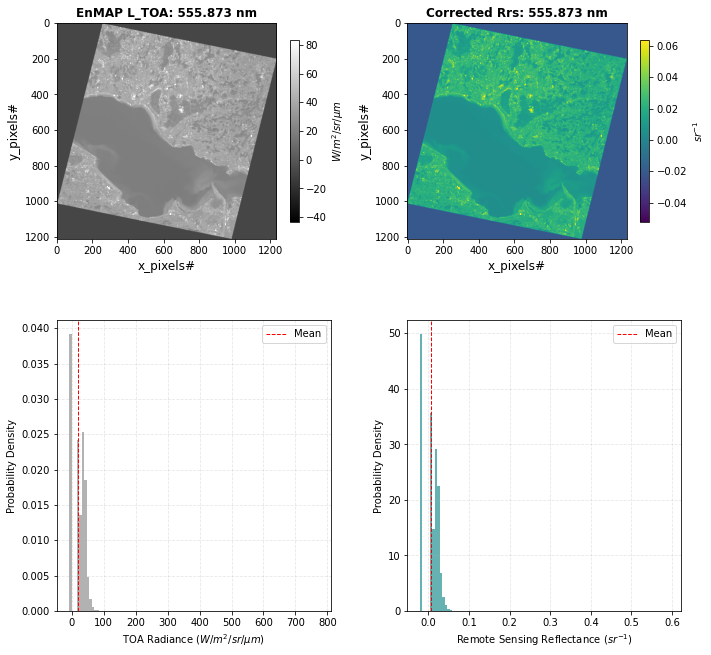

Processing band # 30
Band ID  30.0
Band wavelength center 561.112
Band Gain  1.18807207862e-05
Band Offset  -0.00913757442199
6S params for band 30: {'spherical_albedo': 0.07849, 'ozone_transmittance_total': 0.92314, 'water_transmittance_total': 0.99993, 'total_gaseous_transmittance': 0.92307, 'total_scattering_transmittance_upward': 0.95397, 'total_scattering_transmittance_downward': 0.93731, 'atmospheric_intrinsic_radiance': 13.952, 'direct_solar_irradiance': 1113.97, 'diffuse_solar_irradiance': 100.627}
Performing 6ABOS atmospheric correction on EnMAP band: 561.112 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


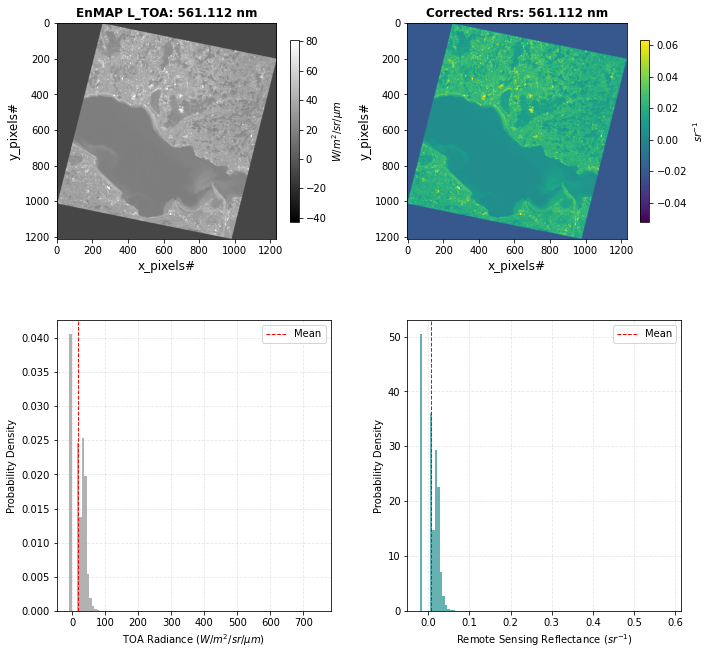

Processing band # 31
Band ID  31.0
Band wavelength center 566.405
Band Gain  1.19086667733e-05
Band Offset  -0.00945844020097
6S params for band 31: {'spherical_albedo': 0.07614, 'ozone_transmittance_total': 0.9175, 'water_transmittance_total': 0.99698, 'total_gaseous_transmittance': 0.91474, 'total_scattering_transmittance_upward': 0.95542, 'total_scattering_transmittance_downward': 0.93921, 'atmospheric_intrinsic_radiance': 13.385, 'direct_solar_irradiance': 1115.215, 'diffuse_solar_irradiance': 97.626}
Performing 6ABOS atmospheric correction on EnMAP band: 566.405 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


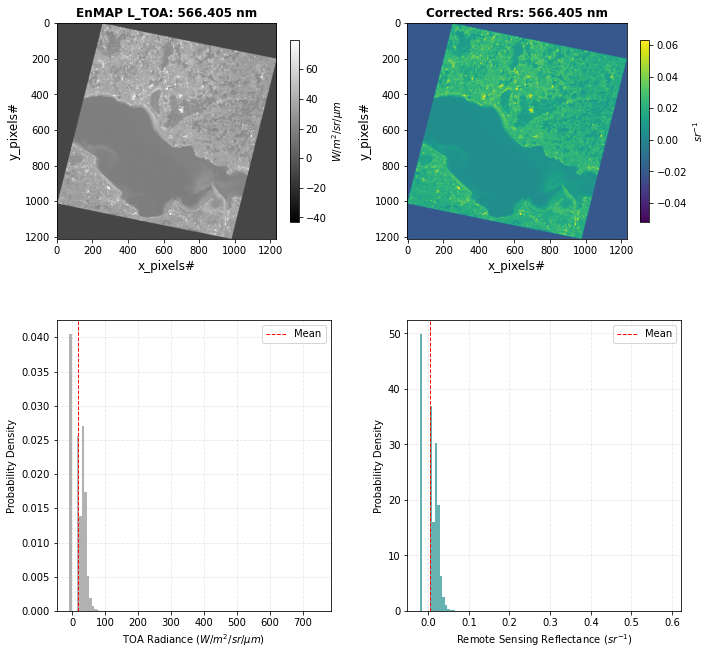

Processing band # 32
Band ID  32.0
Band wavelength center 571.756
Band Gain  1.1537608896e-05
Band Offset  -0.0103688635055
6S params for band 32: {'spherical_albedo': 0.07385, 'ozone_transmittance_total': 0.9137, 'water_transmittance_total': 0.99497, 'total_gaseous_transmittance': 0.90911, 'total_scattering_transmittance_upward': 0.95687, 'total_scattering_transmittance_downward': 0.94113, 'atmospheric_intrinsic_radiance': 12.898, 'direct_solar_irradiance': 1121.028, 'diffuse_solar_irradiance': 95.191}
Performing 6ABOS atmospheric correction on EnMAP band: 571.756 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


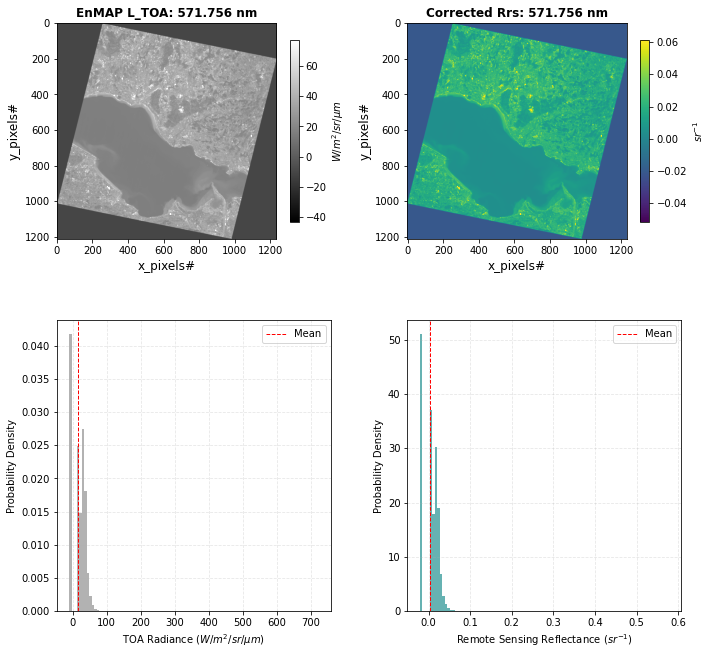

Processing band # 33
Band ID  33.0
Band wavelength center 577.166
Band Gain  1.14193564241e-05
Band Offset  -0.0113580594217
6S params for band 33: {'spherical_albedo': 0.07164, 'ozone_transmittance_total': 0.91331, 'water_transmittance_total': 0.99764, 'total_gaseous_transmittance': 0.91115, 'total_scattering_transmittance_upward': 0.95832, 'total_scattering_transmittance_downward': 0.94304, 'atmospheric_intrinsic_radiance': 12.416, 'direct_solar_irradiance': 1126.582, 'diffuse_solar_irradiance': 92.917}
Performing 6ABOS atmospheric correction on EnMAP band: 577.166 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


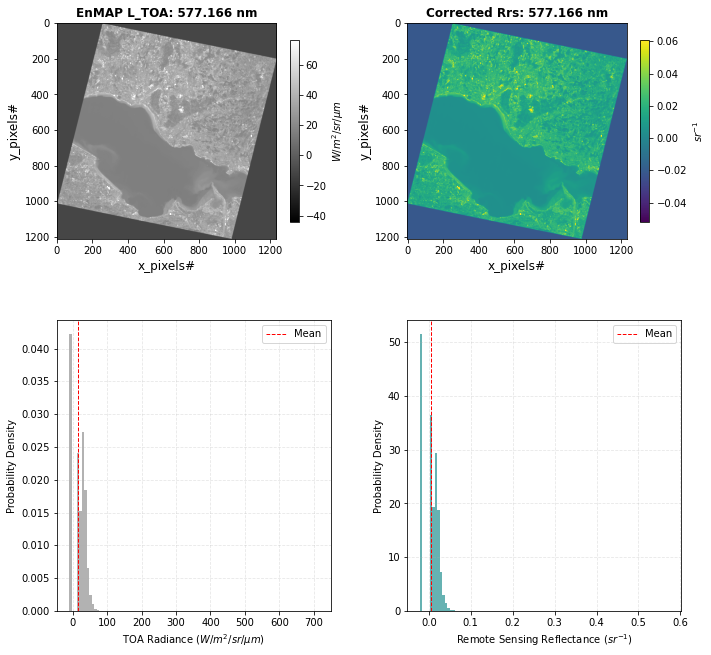

Processing band # 34
Band ID  34.0
Band wavelength center 582.636
Band Gain  1.1100914421e-05
Band Offset  -0.0112007637658
6S params for band 34: {'spherical_albedo': 0.06949, 'ozone_transmittance_total': 0.91536, 'water_transmittance_total': 0.99641, 'total_gaseous_transmittance': 0.91207, 'total_scattering_transmittance_upward': 0.95977, 'total_scattering_transmittance_downward': 0.94496, 'atmospheric_intrinsic_radiance': 11.896, 'direct_solar_irradiance': 1122.965, 'diffuse_solar_irradiance': 90.067}
Performing 6ABOS atmospheric correction on EnMAP band: 582.636 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


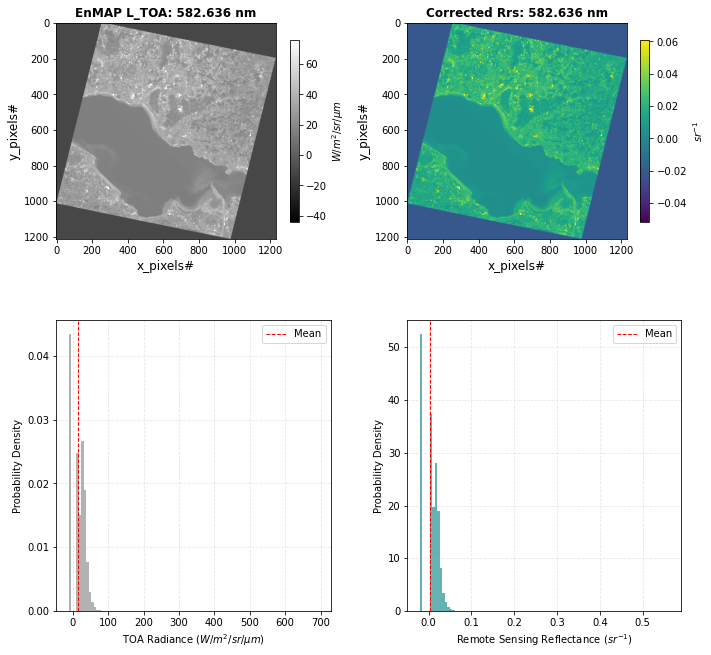

Processing band # 35
Band ID  35.0
Band wavelength center 588.171
Band Gain  1.06925552087e-05
Band Offset  -0.0106147481536
6S params for band 35: {'spherical_albedo': 0.0674, 'ozone_transmittance_total': 0.91712, 'water_transmittance_total': 0.96623, 'total_gaseous_transmittance': 0.88613, 'total_scattering_transmittance_upward': 0.96119, 'total_scattering_transmittance_downward': 0.94684, 'atmospheric_intrinsic_radiance': 11.202, 'direct_solar_irradiance': 1081.708, 'diffuse_solar_irradiance': 84.404}
Performing 6ABOS atmospheric correction on EnMAP band: 588.171 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


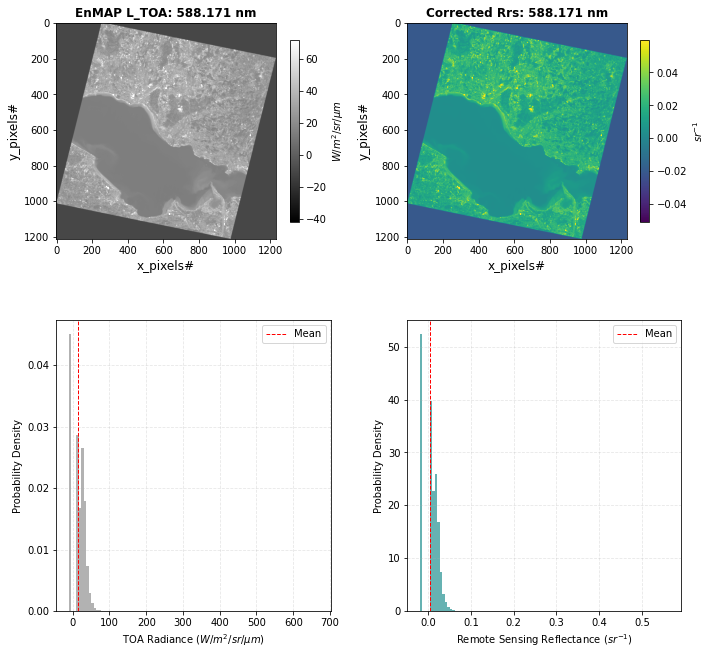

Processing band # 36
Band ID  36.0
Band wavelength center 593.773
Band Gain  1.06234360495e-05
Band Offset  -0.0115092870105
6S params for band 36: {'spherical_albedo': 0.06535, 'ozone_transmittance_total': 0.91571, 'water_transmittance_total': 0.96932, 'total_gaseous_transmittance': 0.88758, 'total_scattering_transmittance_upward': 0.9624, 'total_scattering_transmittance_downward': 0.94845, 'atmospheric_intrinsic_radiance': 10.722, 'direct_solar_irradiance': 1081.965, 'diffuse_solar_irradiance': 81.836}
Performing 6ABOS atmospheric correction on EnMAP band: 593.773 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


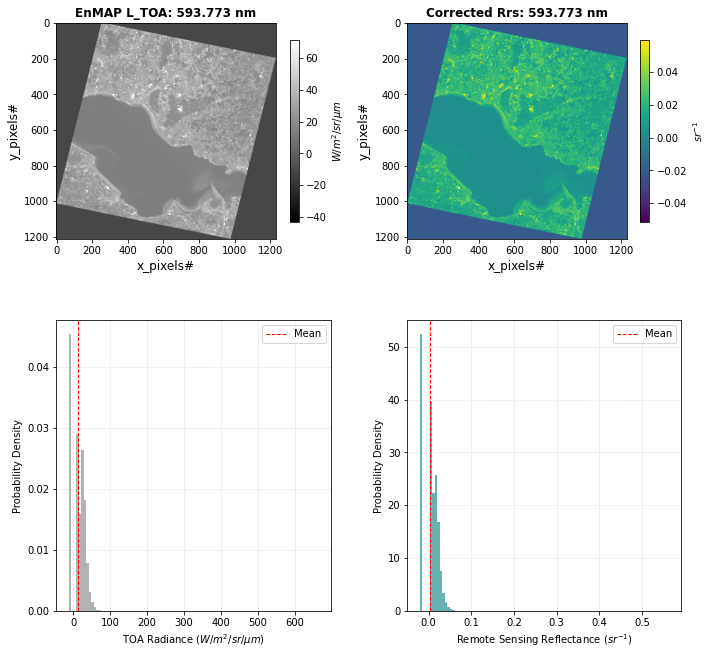

Processing band # 37
Band ID  37.0
Band wavelength center 599.446
Band Gain  1.05710257274e-05
Band Offset  -0.0120140887354
6S params for band 37: {'spherical_albedo': 0.06336, 'ozone_transmittance_total': 0.90966, 'water_transmittance_total': 0.99526, 'total_gaseous_transmittance': 0.90532, 'total_scattering_transmittance_upward': 0.96352, 'total_scattering_transmittance_downward': 0.94994, 'atmospheric_intrinsic_radiance': 10.19, 'direct_solar_irradiance': 1090.642, 'diffuse_solar_irradiance': 79.939}
Performing 6ABOS atmospheric correction on EnMAP band: 599.446 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


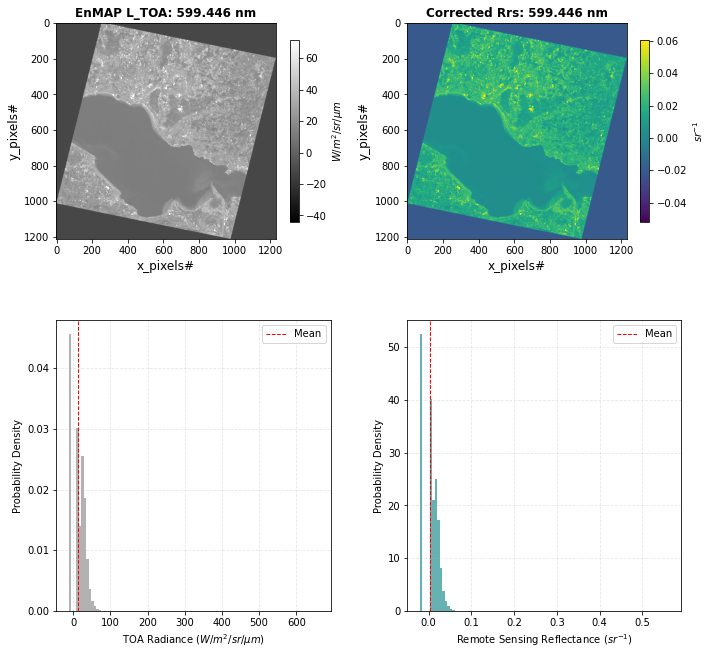

Processing band # 38
Band ID  38.0
Band wavelength center 605.193
Band Gain  1.04258213764e-05
Band Offset  -0.0121029202272
6S params for band 38: {'spherical_albedo': 0.06143, 'ozone_transmittance_total': 0.90891, 'water_transmittance_total': 0.99994, 'total_gaseous_transmittance': 0.90885, 'total_scattering_transmittance_upward': 0.96464, 'total_scattering_transmittance_downward': 0.95143, 'atmospheric_intrinsic_radiance': 9.746, 'direct_solar_irradiance': 1090.099, 'diffuse_solar_irradiance': 77.488}
Performing 6ABOS atmospheric correction on EnMAP band: 605.193 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


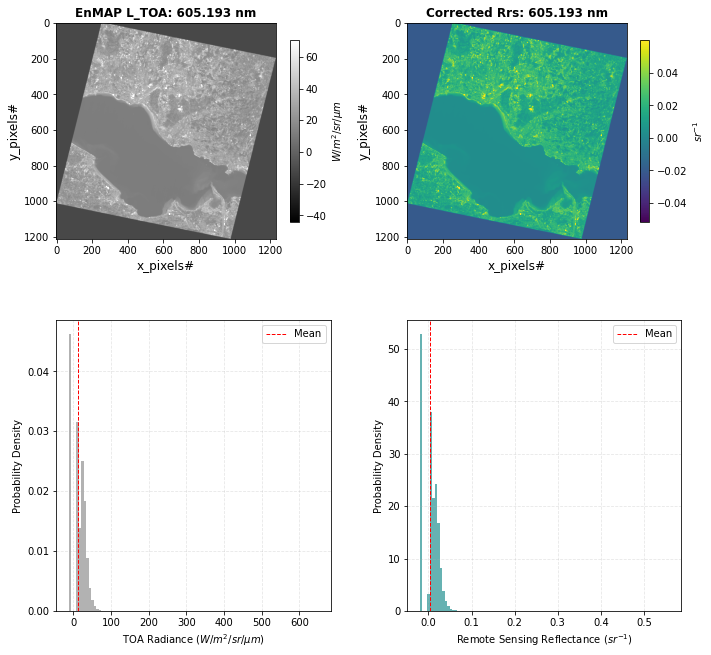

Processing band # 39
Band ID  39.0
Band wavelength center 611.017
Band Gain  1.02496941715e-05
Band Offset  -0.0122314789568
6S params for band 39: {'spherical_albedo': 0.05956, 'ozone_transmittance_total': 0.91374, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.91374, 'total_scattering_transmittance_upward': 0.96577, 'total_scattering_transmittance_downward': 0.95292, 'atmospheric_intrinsic_radiance': 9.239, 'direct_solar_irradiance': 1074.263, 'diffuse_solar_irradiance': 74.128}
Performing 6ABOS atmospheric correction on EnMAP band: 611.017 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


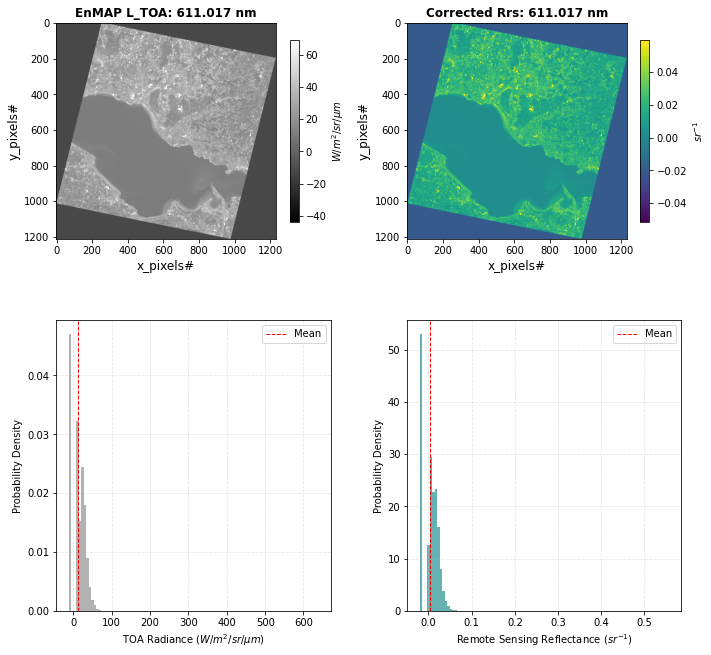

Processing band # 40
Band ID  40.0
Band wavelength center 616.923
Band Gain  1.00105206887e-05
Band Offset  -0.0126857736285
6S params for band 40: {'spherical_albedo': 0.05771, 'ozone_transmittance_total': 0.91949, 'water_transmittance_total': 0.99999, 'total_gaseous_transmittance': 0.91948, 'total_scattering_transmittance_upward': 0.96691, 'total_scattering_transmittance_downward': 0.95444, 'atmospheric_intrinsic_radiance': 8.866, 'direct_solar_irradiance': 1071.606, 'diffuse_solar_irradiance': 71.837}
Performing 6ABOS atmospheric correction on EnMAP band: 616.923 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


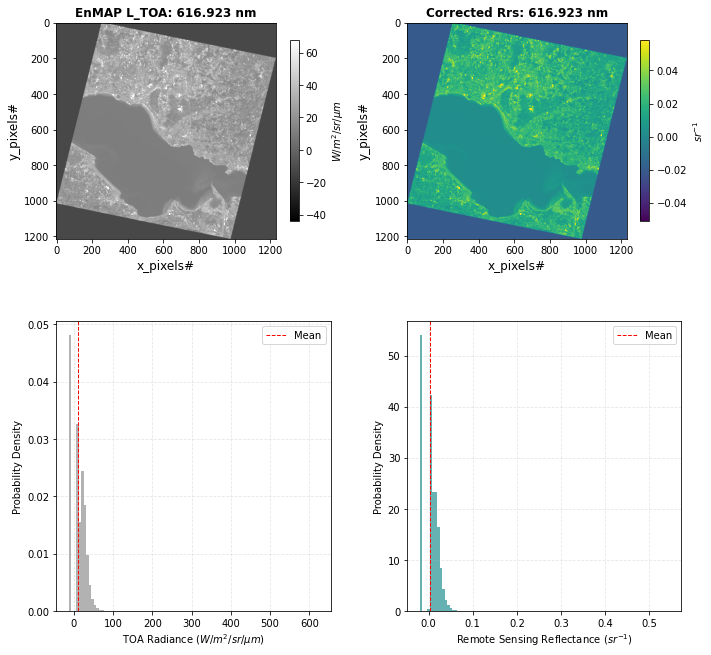

Processing band # 41
Band ID  41.0
Band wavelength center 622.92
Band Gain  1.0005429182e-05
Band Offset  -0.0129843654556
6S params for band 41: {'spherical_albedo': 0.05594, 'ozone_transmittance_total': 0.9246, 'water_transmittance_total': 0.99884, 'total_gaseous_transmittance': 0.92263, 'total_scattering_transmittance_upward': 0.96804, 'total_scattering_transmittance_downward': 0.95595, 'atmospheric_intrinsic_radiance': 8.496, 'direct_solar_irradiance': 1067.112, 'diffuse_solar_irradiance': 69.59}
Performing 6ABOS atmospheric correction on EnMAP band: 622.92 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


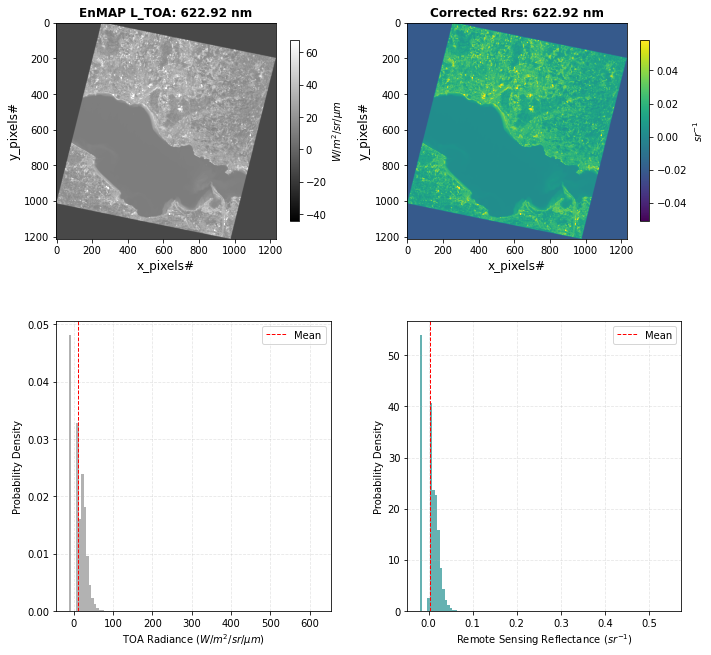

Processing band # 42
Band ID  42.0
Band wavelength center 628.987
Band Gain  1.01532793338e-05
Band Offset  -0.0137665821246
6S params for band 42: {'spherical_albedo': 0.0542, 'ozone_transmittance_total': 0.92956, 'water_transmittance_total': 0.99522, 'total_gaseous_transmittance': 0.91833, 'total_scattering_transmittance_upward': 0.96918, 'total_scattering_transmittance_downward': 0.95747, 'atmospheric_intrinsic_radiance': 8.075, 'direct_solar_irradiance': 1054.839, 'diffuse_solar_irradiance': 66.965}
Performing 6ABOS atmospheric correction on EnMAP band: 628.987 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


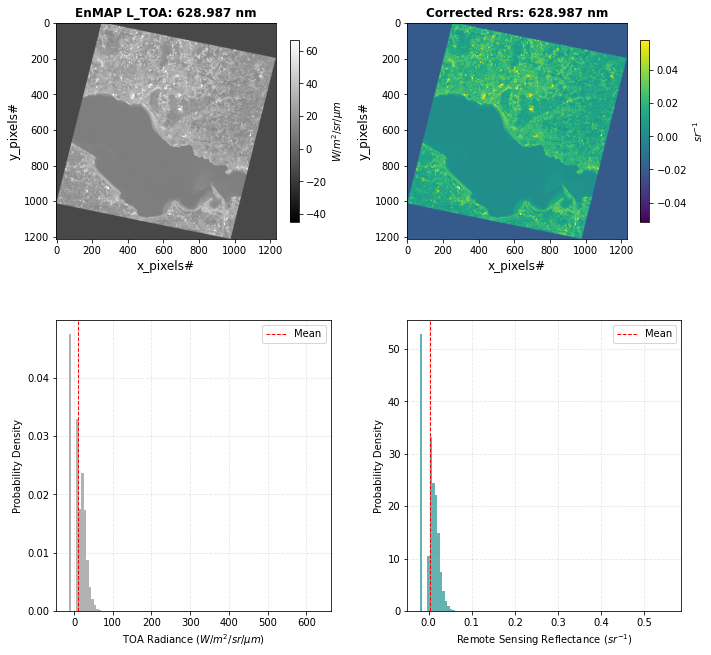

Processing band # 43
Band ID  43.0
Band wavelength center 635.112
Band Gain  9.94405278747e-06
Band Offset  -0.0138753655789
6S params for band 43: {'spherical_albedo': 0.05253, 'ozone_transmittance_total': 0.93613, 'water_transmittance_total': 0.99719, 'total_gaseous_transmittance': 0.9323, 'total_scattering_transmittance_upward': 0.9702, 'total_scattering_transmittance_downward': 0.95883, 'atmospheric_intrinsic_radiance': 7.803, 'direct_solar_irradiance': 1057.753, 'diffuse_solar_irradiance': 65.277}
Performing 6ABOS atmospheric correction on EnMAP band: 635.112 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


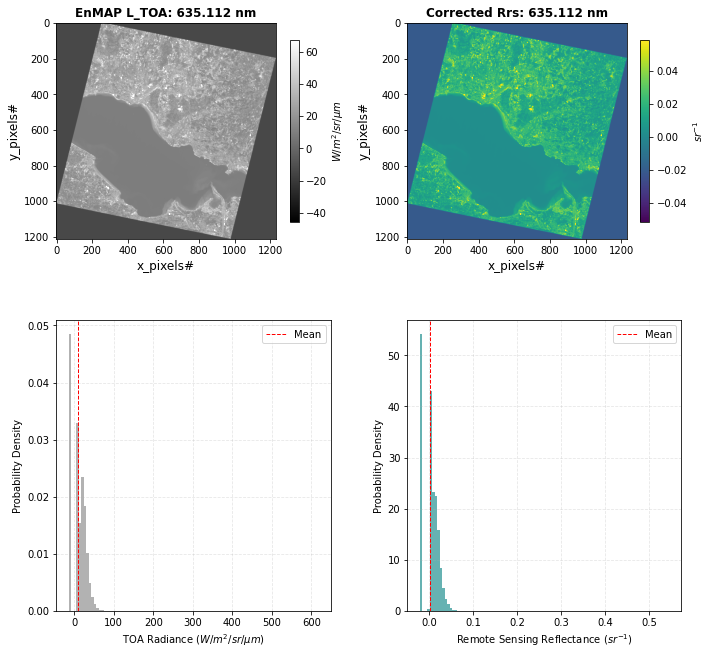

Processing band # 44
Band ID  44.0
Band wavelength center 641.294
Band Gain  9.70463828128e-06
Band Offset  -0.013552338142
6S params for band 44: {'spherical_albedo': 0.05092, 'ozone_transmittance_total': 0.94363, 'water_transmittance_total': 0.99631, 'total_gaseous_transmittance': 0.94013, 'total_scattering_transmittance_upward': 0.97111, 'total_scattering_transmittance_downward': 0.96005, 'atmospheric_intrinsic_radiance': 7.482, 'direct_solar_irradiance': 1051.689, 'diffuse_solar_irradiance': 63.002}
Performing 6ABOS atmospheric correction on EnMAP band: 641.294 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


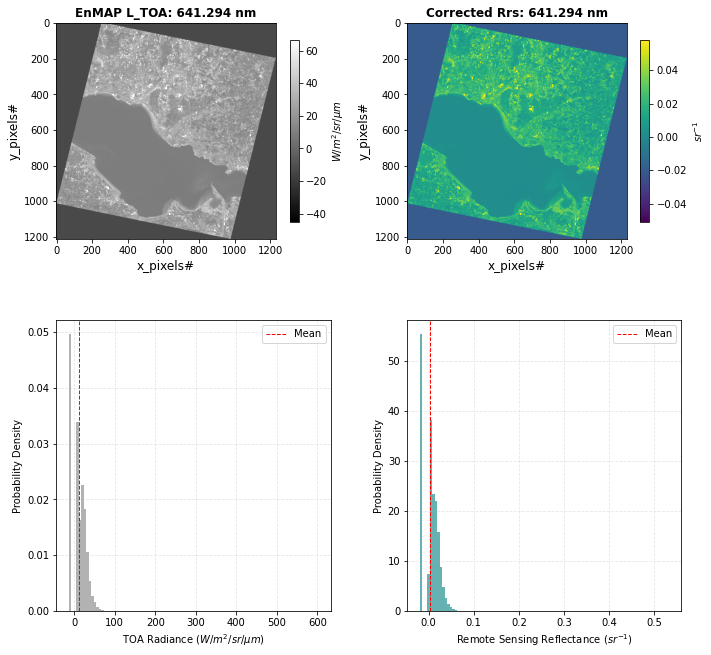

Processing band # 45
Band ID  45.0
Band wavelength center 647.537
Band Gain  9.50079337938e-06
Band Offset  -0.0137132512398
6S params for band 45: {'spherical_albedo': 0.04936, 'ozone_transmittance_total': 0.94967, 'water_transmittance_total': 0.98704, 'total_gaseous_transmittance': 0.93735, 'total_scattering_transmittance_upward': 0.97201, 'total_scattering_transmittance_downward': 0.96125, 'atmospheric_intrinsic_radiance': 7.09, 'direct_solar_irradiance': 1029.404, 'diffuse_solar_irradiance': 59.908}
Performing 6ABOS atmospheric correction on EnMAP band: 647.537 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


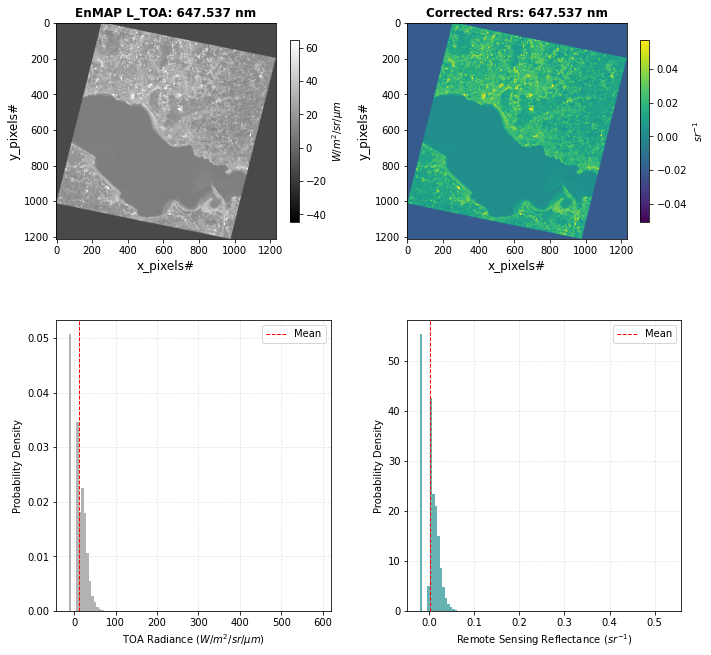

Processing band # 46
Band ID  46.0
Band wavelength center 653.841
Band Gain  9.44378996883e-06
Band Offset  -0.0145995115789
6S params for band 46: {'spherical_albedo': 0.04784, 'ozone_transmittance_total': 0.95476, 'water_transmittance_total': 0.98466, 'total_gaseous_transmittance': 0.94012, 'total_scattering_transmittance_upward': 0.97291, 'total_scattering_transmittance_downward': 0.96246, 'atmospheric_intrinsic_radiance': 6.63, 'direct_solar_irradiance': 998.867, 'diffuse_solar_irradiance': 56.519}
Performing 6ABOS atmospheric correction on EnMAP band: 653.841 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


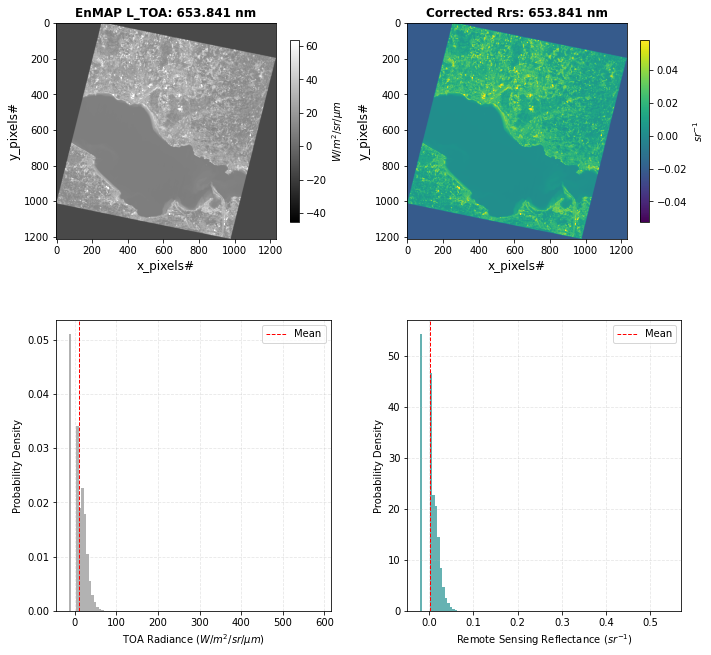

Processing band # 47
Band ID  47.0
Band wavelength center 660.207
Band Gain  9.42882286726e-06
Band Offset  -0.0155695119141
6S params for band 47: {'spherical_albedo': 0.04636, 'ozone_transmittance_total': 0.9596, 'water_transmittance_total': 0.99529, 'total_gaseous_transmittance': 0.9551, 'total_scattering_transmittance_upward': 0.97382, 'total_scattering_transmittance_downward': 0.96368, 'atmospheric_intrinsic_radiance': 6.431, 'direct_solar_irradiance': 1013.019, 'diffuse_solar_irradiance': 55.784}
Performing 6ABOS atmospheric correction on EnMAP band: 660.207 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


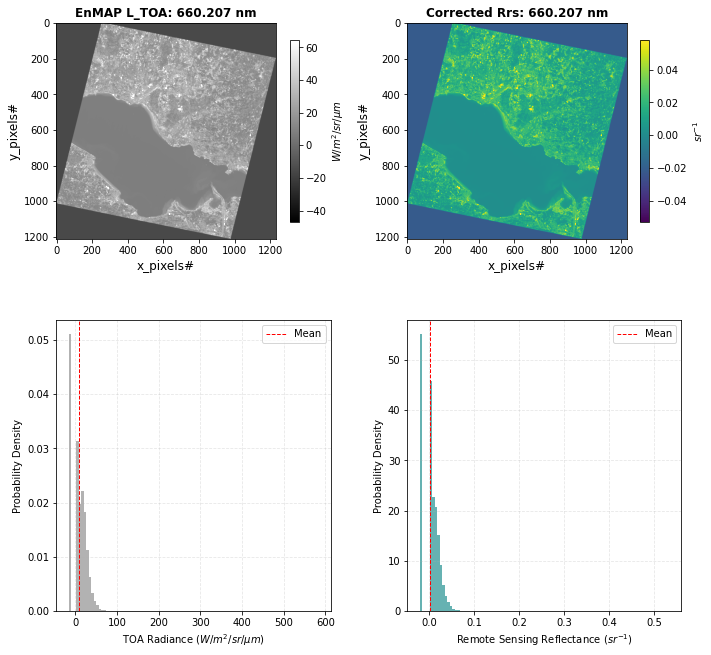

Processing band # 48
Band ID  48.0
Band wavelength center 666.637
Band Gain  9.14357570536e-06
Band Offset  -0.0145279093084
6S params for band 48: {'spherical_albedo': 0.04495, 'ozone_transmittance_total': 0.96447, 'water_transmittance_total': 0.99982, 'total_gaseous_transmittance': 0.9643, 'total_scattering_transmittance_upward': 0.97471, 'total_scattering_transmittance_downward': 0.96487, 'atmospheric_intrinsic_radiance': 6.223, 'direct_solar_irradiance': 1020.619, 'diffuse_solar_irradiance': 54.77}
Performing 6ABOS atmospheric correction on EnMAP band: 666.637 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


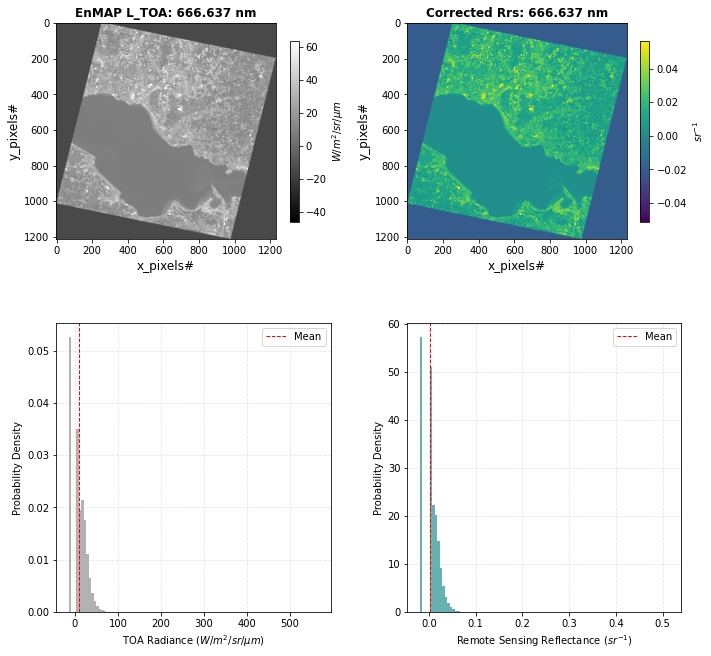

Processing band # 49
Band ID  49.0
Band wavelength center 673.131
Band Gain  9.09431414998e-06
Band Offset  -0.0154289537533
6S params for band 49: {'spherical_albedo': 0.04358, 'ozone_transmittance_total': 0.96941, 'water_transmittance_total': 0.99998, 'total_gaseous_transmittance': 0.96937, 'total_scattering_transmittance_upward': 0.97553, 'total_scattering_transmittance_downward': 0.96597, 'atmospheric_intrinsic_radiance': 5.938, 'direct_solar_irradiance': 1011.458, 'diffuse_solar_irradiance': 52.834}
Performing 6ABOS atmospheric correction on EnMAP band: 673.131 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


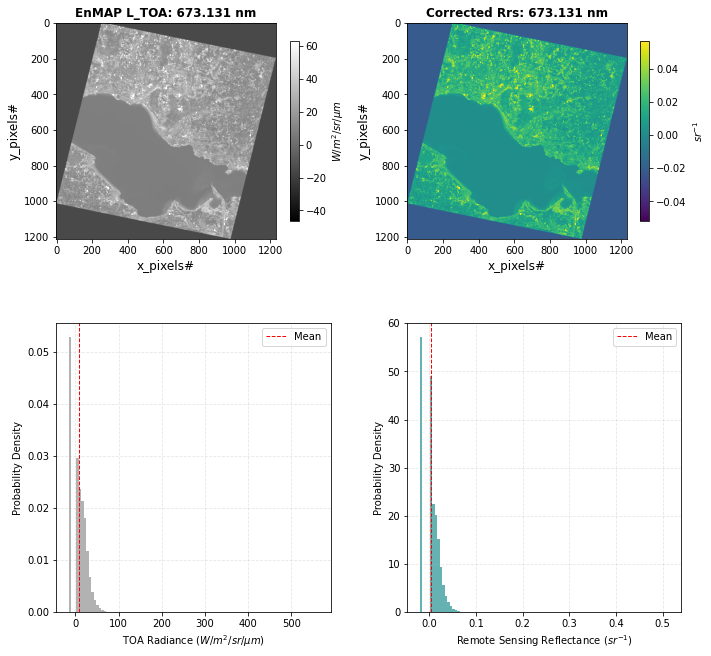

Processing band # 50
Band ID  50.0
Band wavelength center 679.691
Band Gain  9.21969636845e-06
Band Offset  -0.0152711193763
6S params for band 50: {'spherical_albedo': 0.04225, 'ozone_transmittance_total': 0.97383, 'water_transmittance_total': 0.99974, 'total_gaseous_transmittance': 0.96216, 'total_scattering_transmittance_upward': 0.9763, 'total_scattering_transmittance_downward': 0.96701, 'atmospheric_intrinsic_radiance': 5.583, 'direct_solar_irradiance': 989.669, 'diffuse_solar_irradiance': 50.307}
Performing 6ABOS atmospheric correction on EnMAP band: 679.691 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


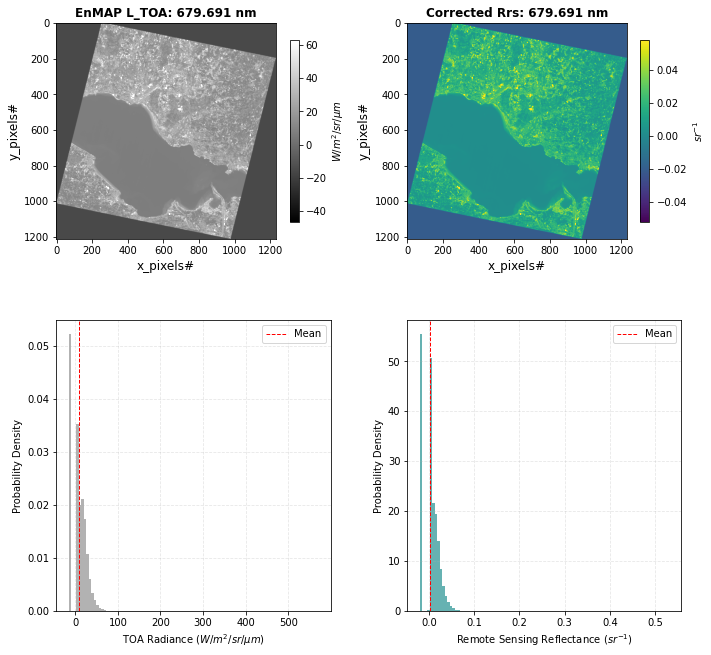

Processing band # 51
Band ID  51.0
Band wavelength center 686.319
Band Gain  9.01823805348e-06
Band Offset  -0.0137385067152
6S params for band 51: {'spherical_albedo': 0.04097, 'ozone_transmittance_total': 0.97764, 'water_transmittance_total': 0.99698, 'total_gaseous_transmittance': 0.85982, 'total_scattering_transmittance_upward': 0.97706, 'total_scattering_transmittance_downward': 0.96804, 'atmospheric_intrinsic_radiance': 4.732, 'direct_solar_irradiance': 894.428, 'diffuse_solar_irradiance': 44.276}
Performing 6ABOS atmospheric correction on EnMAP band: 686.319 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


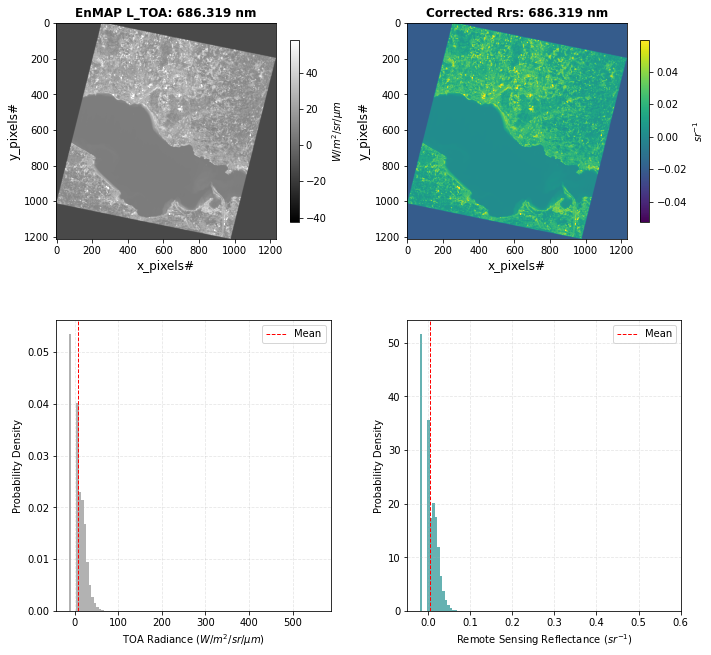

Processing band # 52
Band ID  52.0
Band wavelength center 693.014
Band Gain  9.01234980509e-06
Band Offset  -0.0135932610714
6S params for band 52: {'spherical_albedo': 0.03972, 'ozone_transmittance_total': 0.98084, 'water_transmittance_total': 0.96769, 'total_gaseous_transmittance': 0.9092, 'total_scattering_transmittance_upward': 0.97779, 'total_scattering_transmittance_downward': 0.96903, 'atmospheric_intrinsic_radiance': 4.871, 'direct_solar_irradiance': 922.922, 'diffuse_solar_irradiance': 44.453}
Performing 6ABOS atmospheric correction on EnMAP band: 693.014 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


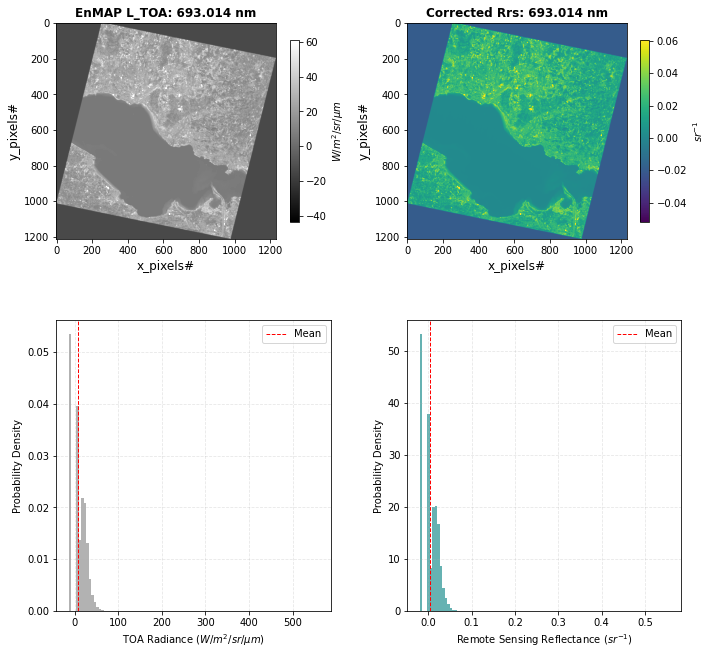

Processing band # 53
Band ID  53.0
Band wavelength center 699.78
Band Gain  8.8080719705e-06
Band Offset  -0.00861647873676
6S params for band 53: {'spherical_albedo': 0.03851, 'ozone_transmittance_total': 0.9834, 'water_transmittance_total': 0.9693, 'total_gaseous_transmittance': 0.95225, 'total_scattering_transmittance_upward': 0.97842, 'total_scattering_transmittance_downward': 0.96988, 'atmospheric_intrinsic_radiance': 4.811, 'direct_solar_irradiance': 938.017, 'diffuse_solar_irradiance': 43.907}
Performing 6ABOS atmospheric correction on EnMAP band: 699.78 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


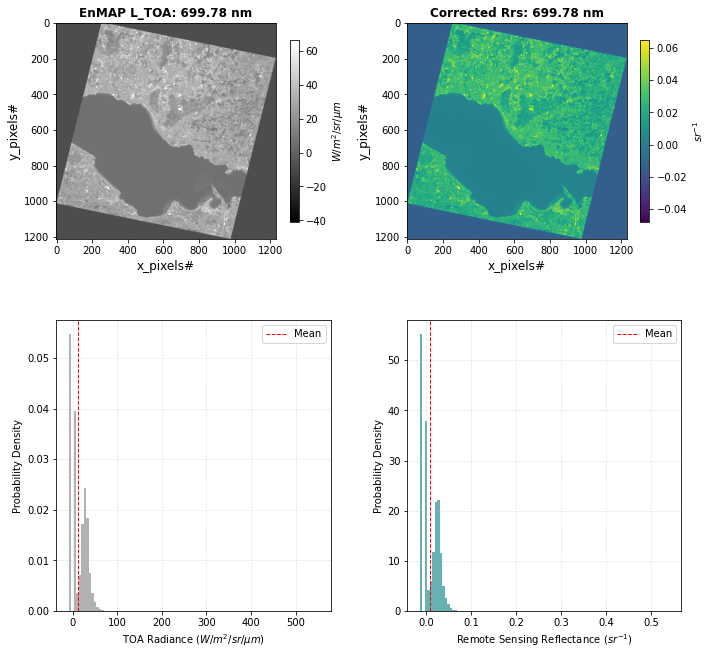

Processing band # 54
Band ID  54.0
Band wavelength center 706.617
Band Gain  8.8031878349e-06
Band Offset  -0.00449616215281
6S params for band 54: {'spherical_albedo': 0.03734, 'ozone_transmittance_total': 0.98535, 'water_transmittance_total': 0.98307, 'total_gaseous_transmittance': 0.96867, 'total_scattering_transmittance_upward': 0.97901, 'total_scattering_transmittance_downward': 0.97068, 'atmospheric_intrinsic_radiance': 4.597, 'direct_solar_irradiance': 938.909, 'diffuse_solar_irradiance': 42.694}
Performing 6ABOS atmospheric correction on EnMAP band: 706.617 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


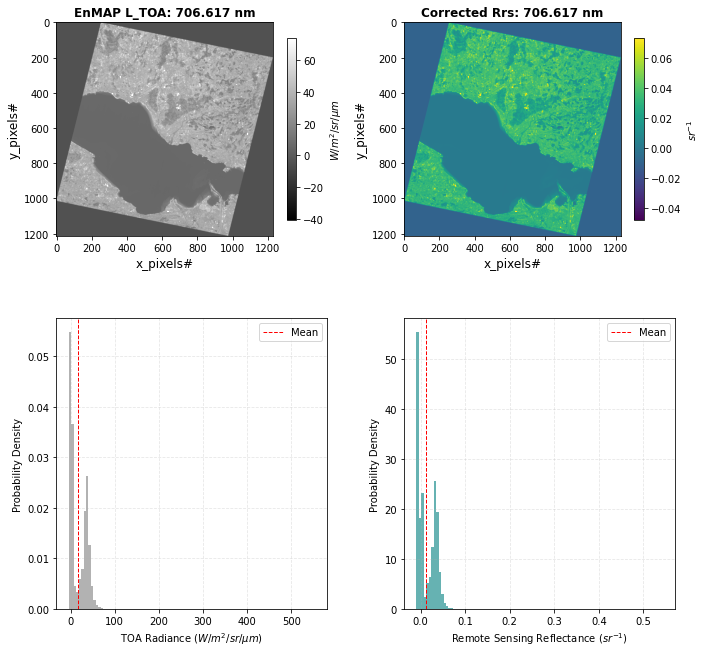

Processing band # 55
Band ID  55.0
Band wavelength center 713.524
Band Gain  8.89046106238e-06
Band Offset  -0.000177219245701
6S params for band 55: {'spherical_albedo': 0.0362, 'ozone_transmittance_total': 0.98706, 'water_transmittance_total': 0.93224, 'total_gaseous_transmittance': 0.92012, 'total_scattering_transmittance_upward': 0.9796, 'total_scattering_transmittance_downward': 0.97148, 'atmospheric_intrinsic_radiance': 4.336, 'direct_solar_irradiance': 889.949, 'diffuse_solar_irradiance': 39.368}
Performing 6ABOS atmospheric correction on EnMAP band: 713.524 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


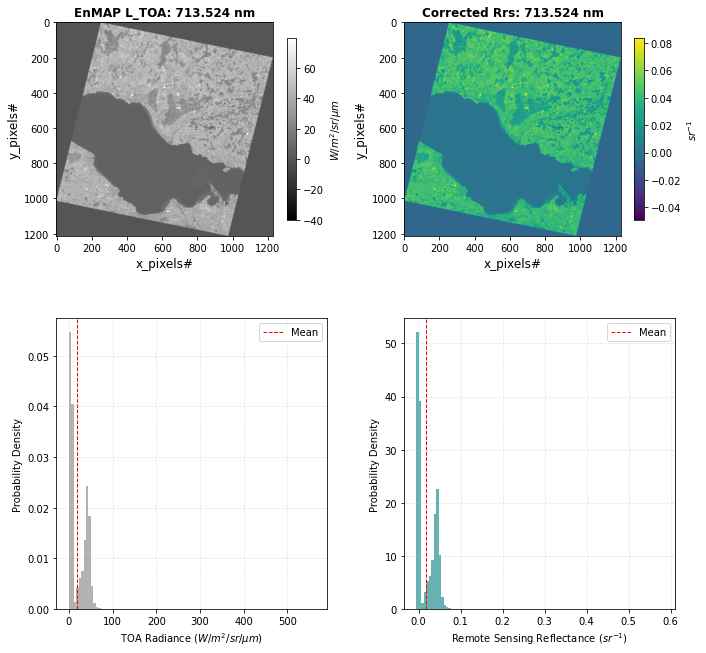

Processing band # 56
Band ID  56.0
Band wavelength center 720.501
Band Gain  8.75011265185e-06
Band Offset  0.00136046625029
6S params for band 56: {'spherical_albedo': 0.0351, 'ozone_transmittance_total': 0.98914, 'water_transmittance_total': 0.87029, 'total_gaseous_transmittance': 0.86086, 'total_scattering_transmittance_upward': 0.9802, 'total_scattering_transmittance_downward': 0.97229, 'atmospheric_intrinsic_radiance': 4.099, 'direct_solar_irradiance': 837.589, 'diffuse_solar_irradiance': 36.019}
Performing 6ABOS atmospheric correction on EnMAP band: 720.501 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


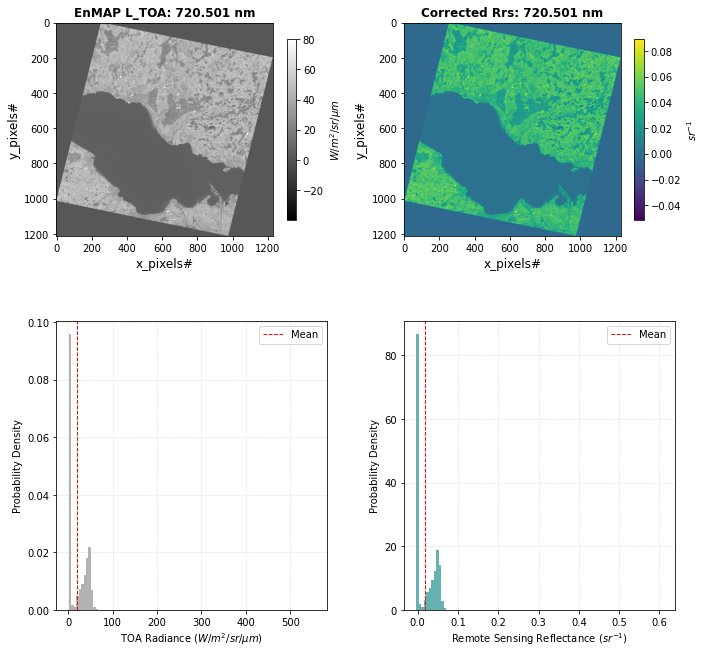

Processing band # 57
Band ID  57.0
Band wavelength center 727.545
Band Gain  8.79462104287e-06
Band Offset  0.00263227275345
6S params for band 57: {'spherical_albedo': 0.03403, 'ozone_transmittance_total': 0.99065, 'water_transmittance_total': 0.89316, 'total_gaseous_transmittance': 0.88482, 'total_scattering_transmittance_upward': 0.98079, 'total_scattering_transmittance_downward': 0.97309, 'atmospheric_intrinsic_radiance': 3.928, 'direct_solar_irradiance': 849.449, 'diffuse_solar_irradiance': 35.577}
Performing 6ABOS atmospheric correction on EnMAP band: 727.545 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


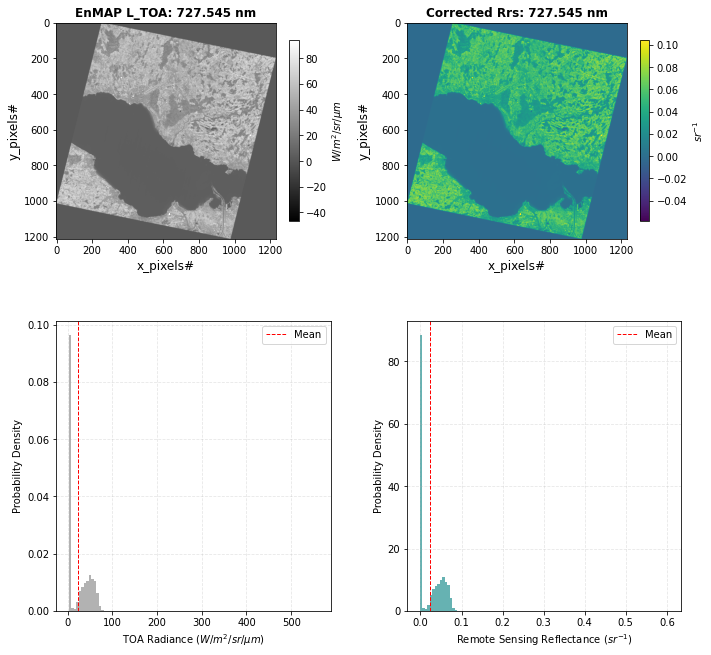

Processing band # 58
Band ID  58.0
Band wavelength center 734.654
Band Gain  8.92895932899e-06
Band Offset  0.00214712284778
6S params for band 58: {'spherical_albedo': 0.033, 'ozone_transmittance_total': 0.99141, 'water_transmittance_total': 0.95444, 'total_gaseous_transmittance': 0.94625, 'total_scattering_transmittance_upward': 0.98138, 'total_scattering_transmittance_downward': 0.97389, 'atmospheric_intrinsic_radiance': 3.721, 'direct_solar_irradiance': 871.644, 'diffuse_solar_irradiance': 35.59}
Performing 6ABOS atmospheric correction on EnMAP band: 734.654 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


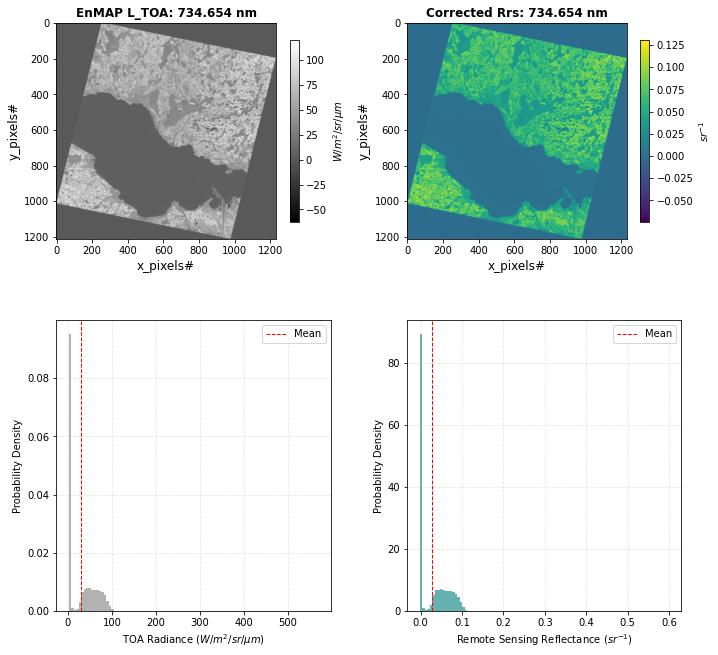

Processing band # 59
Band ID  59.0
Band wavelength center 741.826
Band Gain  8.96465626642e-06
Band Offset  0.00183150174434
6S params for band 59: {'spherical_albedo': 0.03199, 'ozone_transmittance_total': 0.99174, 'water_transmittance_total': 0.98874, 'total_gaseous_transmittance': 0.98057, 'total_scattering_transmittance_upward': 0.98198, 'total_scattering_transmittance_downward': 0.9747, 'atmospheric_intrinsic_radiance': 3.53, 'direct_solar_irradiance': 877.25, 'diffuse_solar_irradiance': 34.955}
Performing 6ABOS atmospheric correction on EnMAP band: 741.826 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


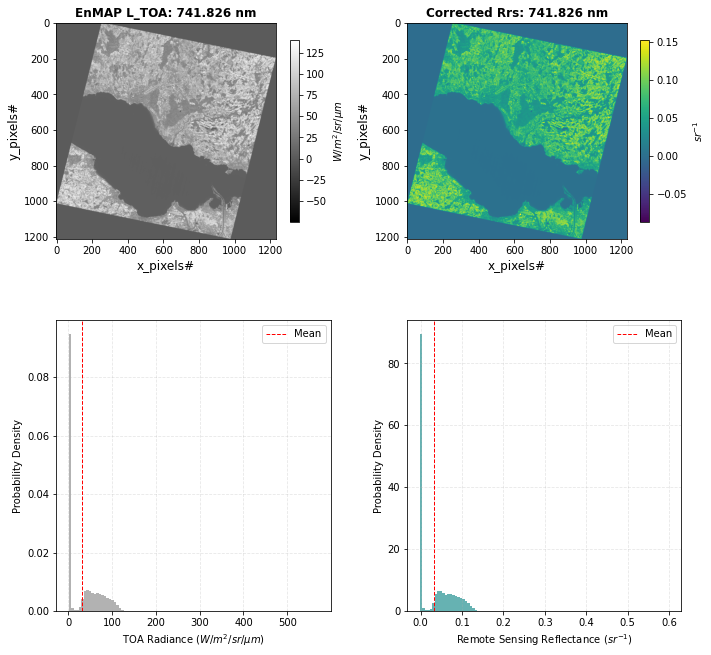

Processing band # 60
Band ID  60.0
Band wavelength center 749.06
Band Gain  8.9650928372e-06
Band Offset  0.00160195485676
6S params for band 60: {'spherical_albedo': 0.03102, 'ozone_transmittance_total': 0.9925, 'water_transmittance_total': 0.99944, 'total_gaseous_transmittance': 0.98658, 'total_scattering_transmittance_upward': 0.98257, 'total_scattering_transmittance_downward': 0.9755, 'atmospheric_intrinsic_radiance': 3.356, 'direct_solar_irradiance': 872.148, 'diffuse_solar_irradiance': 33.955}
Performing 6ABOS atmospheric correction on EnMAP band: 749.06 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


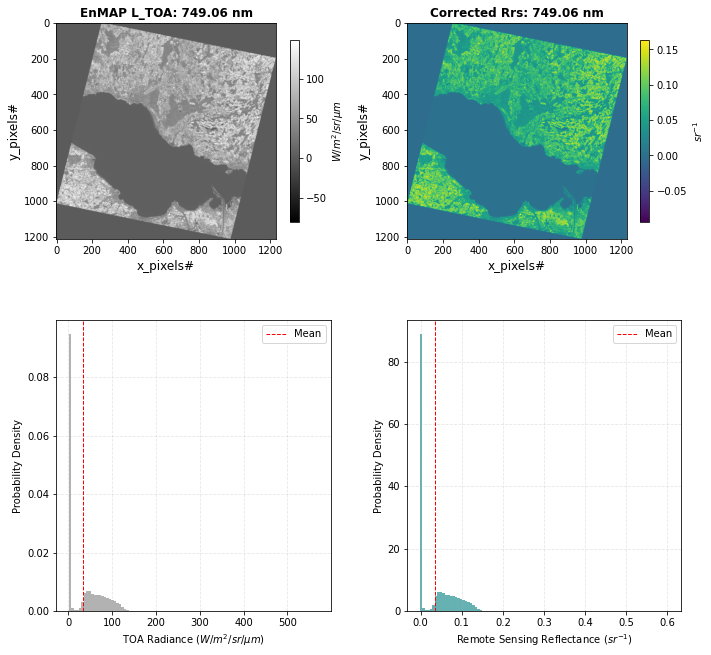

Processing band # 61
Band ID  61.0
Band wavelength center 756.353
Band Gain  9.05285084015e-06
Band Offset  0.00123552694025
6S params for band 61: {'spherical_albedo': 0.03008, 'ozone_transmittance_total': 0.99385, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.78555, 'total_scattering_transmittance_upward': 0.98315, 'total_scattering_transmittance_downward': 0.97628, 'atmospheric_intrinsic_radiance': 2.542, 'direct_solar_irradiance': 711.264, 'diffuse_solar_irradiance': 27.124}
Performing 6ABOS atmospheric correction on EnMAP band: 756.353 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


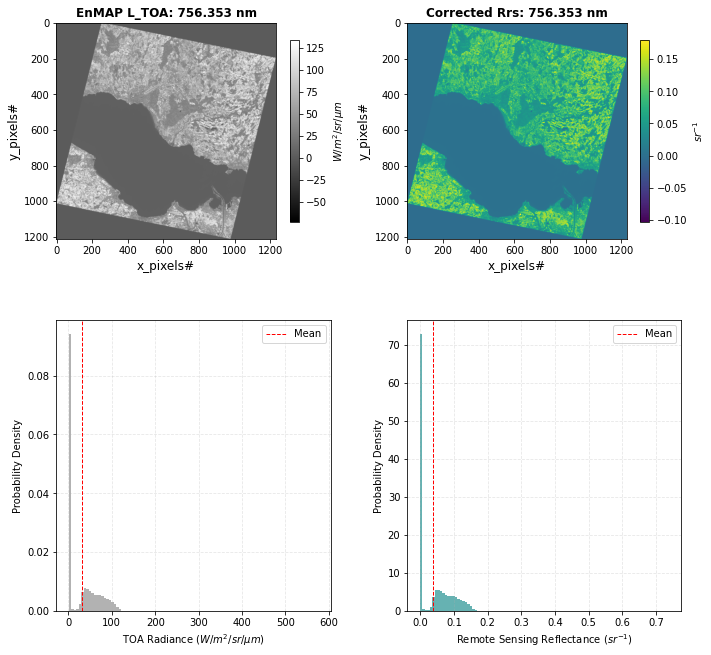

Processing band # 62
Band ID  62.0
Band wavelength center 763.703
Band Gain  9.09451970205e-06
Band Offset  0.000817741636491
6S params for band 62: {'spherical_albedo': 0.02918, 'ozone_transmittance_total': 0.99589, 'water_transmittance_total': 1.0, 'total_gaseous_transmittance': 0.70312, 'total_scattering_transmittance_upward': 0.98363, 'total_scattering_transmittance_downward': 0.97694, 'atmospheric_intrinsic_radiance': 2.129, 'direct_solar_irradiance': 645.758, 'diffuse_solar_irradiance': 23.881}
Performing 6ABOS atmospheric correction on EnMAP band: 763.703 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 763.703 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 63
Band ID  63.0
Band wavelength center 771.108
Band Gain  9.31837864564e-06
Band Offset  0.000707783065379
6S params for band 63: {'spherical_albedo': 0.02832, 'ozone_transmittance_total': 0.99925, 'water_transmittance_total': 0.99999, 'total_gaseous

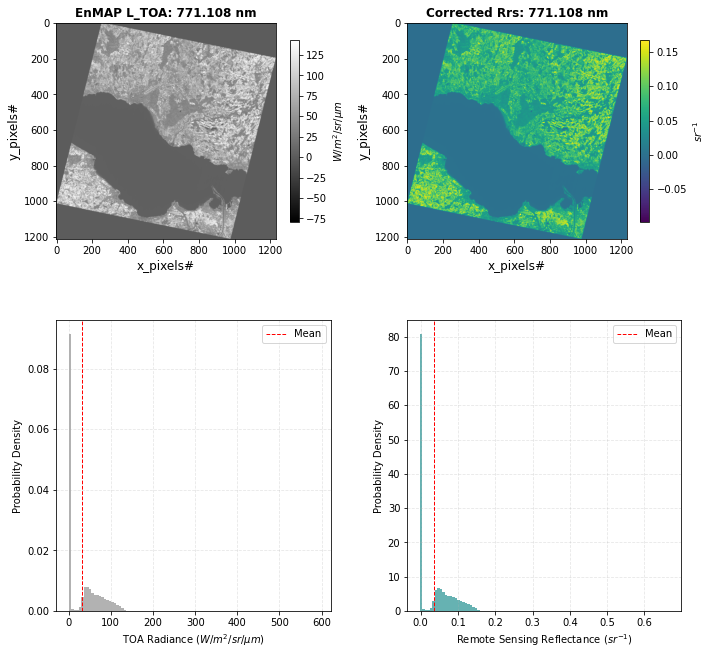

Processing band # 64
Band ID  64.0
Band wavelength center 778.567
Band Gain  9.75062464629e-06
Band Offset  0.000670837677556
6S params for band 64: {'spherical_albedo': 0.02748, 'ozone_transmittance_total': 0.99999, 'water_transmittance_total': 0.99921, 'total_gaseous_transmittance': 0.99863, 'total_scattering_transmittance_upward': 0.98443, 'total_scattering_transmittance_downward': 0.97804, 'atmospheric_intrinsic_radiance': 2.751, 'direct_solar_irradiance': 829.776, 'diffuse_solar_irradiance': 29.094}
Performing 6ABOS atmospheric correction on EnMAP band: 778.567 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


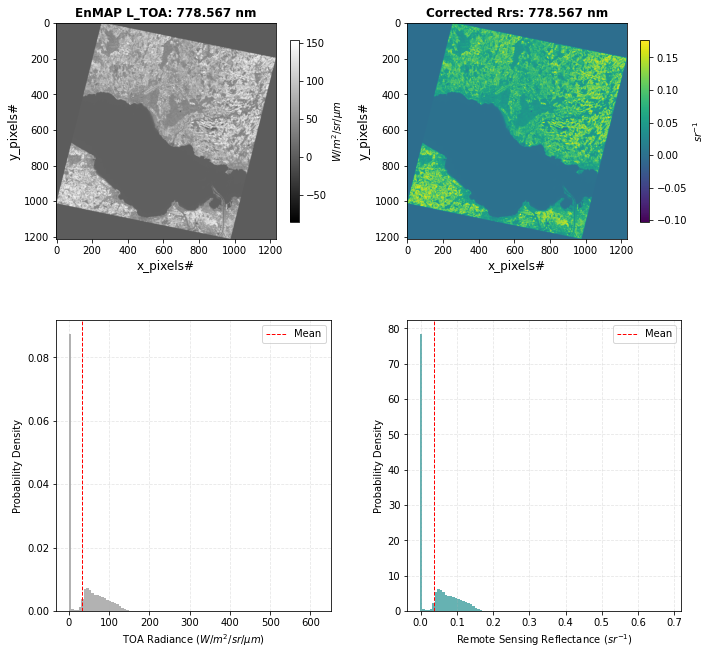

Processing band # 65
Band ID  65.0
Band wavelength center 786.078
Band Gain  9.78958676935e-06
Band Offset  0.000613994732263
6S params for band 65: {'spherical_albedo': 0.02668, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98819, 'total_gaseous_transmittance': 0.98819, 'total_scattering_transmittance_upward': 0.98483, 'total_scattering_transmittance_downward': 0.97858, 'atmospheric_intrinsic_radiance': 2.617, 'direct_solar_irradiance': 814.298, 'diffuse_solar_irradiance': 27.8}
Performing 6ABOS atmospheric correction on EnMAP band: 786.078 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


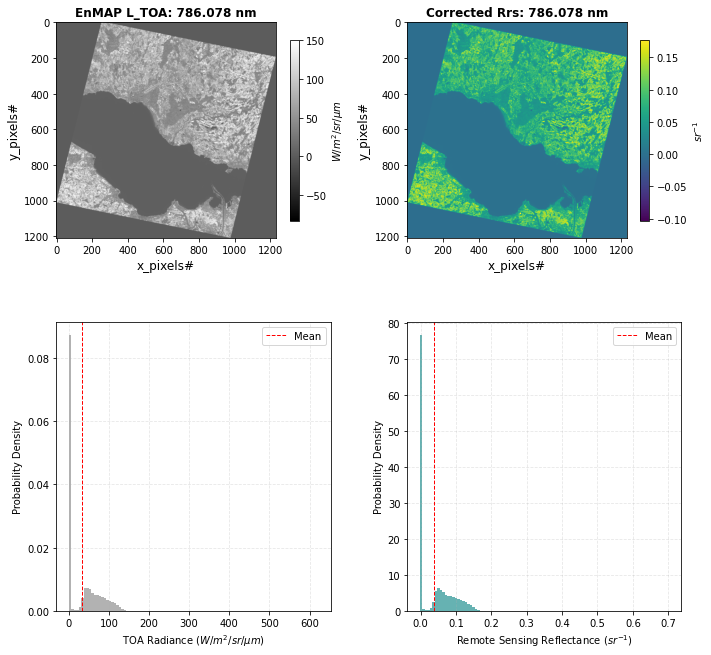

Processing band # 66
Band ID  66.0
Band wavelength center 793.639
Band Gain  1.00954309768e-05
Band Offset  0.000412650919546
6S params for band 66: {'spherical_albedo': 0.02589, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98618, 'total_gaseous_transmittance': 0.98618, 'total_scattering_transmittance_upward': 0.98522, 'total_scattering_transmittance_downward': 0.97913, 'atmospheric_intrinsic_radiance': 2.475, 'direct_solar_irradiance': 798.404, 'diffuse_solar_irradiance': 26.557}
Performing 6ABOS atmospheric correction on EnMAP band: 793.639 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


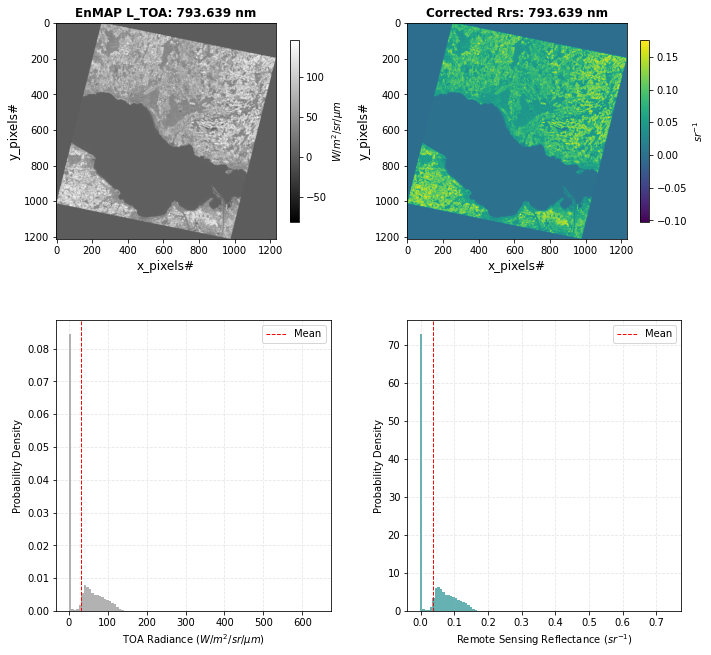

Processing band # 67
Band ID  67.0
Band wavelength center 801.248
Band Gain  1.01695352286e-05
Band Offset  0.000335374568537
6S params for band 67: {'spherical_albedo': 0.02514, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98775, 'total_gaseous_transmittance': 0.98775, 'total_scattering_transmittance_upward': 0.98562, 'total_scattering_transmittance_downward': 0.97967, 'atmospheric_intrinsic_radiance': 2.35, 'direct_solar_irradiance': 787.534, 'diffuse_solar_irradiance': 25.548}
Performing 6ABOS atmospheric correction on EnMAP band: 801.248 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


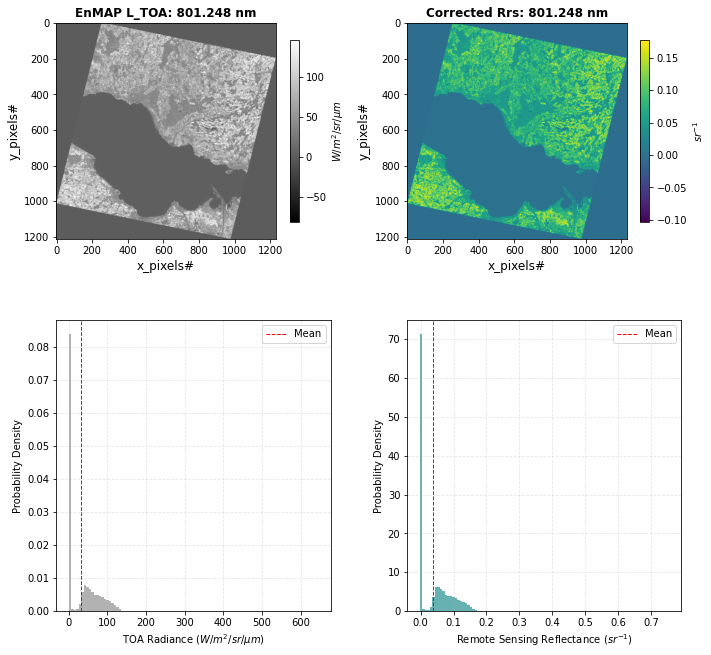

Processing band # 68
Band ID  68.0
Band wavelength center 808.905
Band Gain  1.03628251224e-05
Band Offset  -0.00154291873216
6S params for band 68: {'spherical_albedo': 0.0244, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9537, 'total_gaseous_transmittance': 0.9537, 'total_scattering_transmittance_upward': 0.98601, 'total_scattering_transmittance_downward': 0.98021, 'atmospheric_intrinsic_radiance': 2.224, 'direct_solar_irradiance': 757.616, 'diffuse_solar_irradiance': 23.996}
Performing 6ABOS atmospheric correction on EnMAP band: 808.905 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


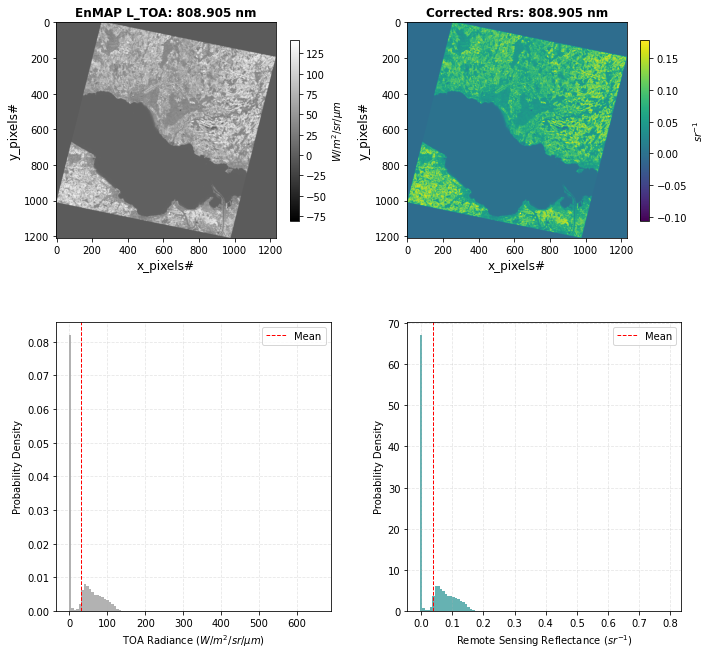

Processing band # 69
Band ID  69.0
Band wavelength center 816.608
Band Gain  1.06180216623e-05
Band Offset  -0.00259092986951
6S params for band 69: {'spherical_albedo': 0.0237, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.84773, 'total_gaseous_transmittance': 0.84773, 'total_scattering_transmittance_upward': 0.9864, 'total_scattering_transmittance_downward': 0.98075, 'atmospheric_intrinsic_radiance': 2.089, 'direct_solar_irradiance': 686.024, 'diffuse_solar_irradiance': 21.228}
Performing 6ABOS atmospheric correction on EnMAP band: 816.608 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


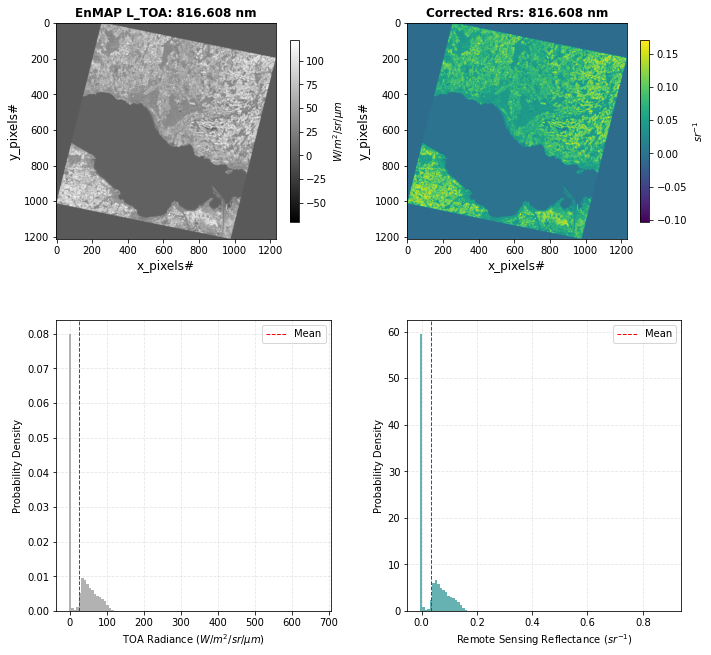

Processing band # 70
Band ID  70.0
Band wavelength center 824.355
Band Gain  1.04542548675e-05
Band Offset  -0.00278457689163
6S params for band 70: {'spherical_albedo': 0.02301, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.85623, 'total_gaseous_transmittance': 0.85623, 'total_scattering_transmittance_upward': 0.9868, 'total_scattering_transmittance_downward': 0.98129, 'atmospheric_intrinsic_radiance': 1.982, 'direct_solar_irradiance': 679.219, 'diffuse_solar_irradiance': 20.534}
Performing 6ABOS atmospheric correction on EnMAP band: 824.355 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


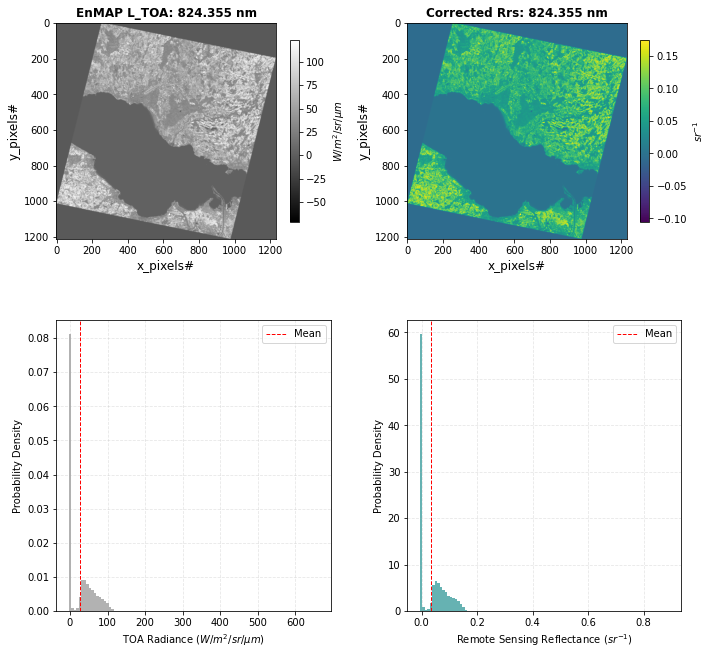

Processing band # 71
Band ID  71.0
Band wavelength center 832.145
Band Gain  1.13580555199e-05
Band Offset  -0.00147031817515
6S params for band 71: {'spherical_albedo': 0.02235, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.92207, 'total_gaseous_transmittance': 0.92207, 'total_scattering_transmittance_upward': 0.98719, 'total_scattering_transmittance_downward': 0.98182, 'atmospheric_intrinsic_radiance': 1.892, 'direct_solar_irradiance': 704.684, 'diffuse_solar_irradiance': 20.85}
Performing 6ABOS atmospheric correction on EnMAP band: 832.145 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


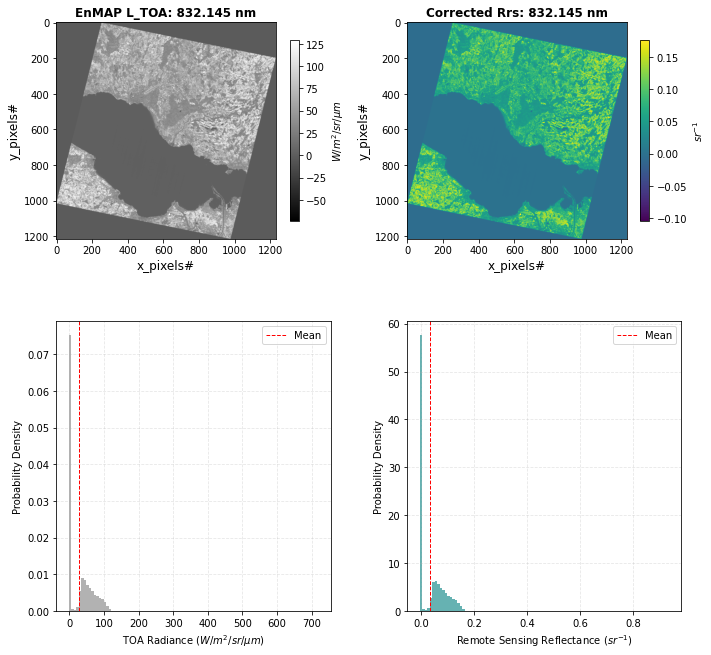

Processing band # 72
Band ID  72.0
Band wavelength center 839.976
Band Gain  1.09991124818e-05
Band Offset  -0.0028614296644
6S params for band 72: {'spherical_albedo': 0.02171, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98196, 'total_gaseous_transmittance': 0.98196, 'total_scattering_transmittance_upward': 0.98758, 'total_scattering_transmittance_downward': 0.98235, 'atmospheric_intrinsic_radiance': 1.803, 'direct_solar_irradiance': 723.111, 'diffuse_solar_irradiance': 20.962}
Performing 6ABOS atmospheric correction on EnMAP band: 839.976 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


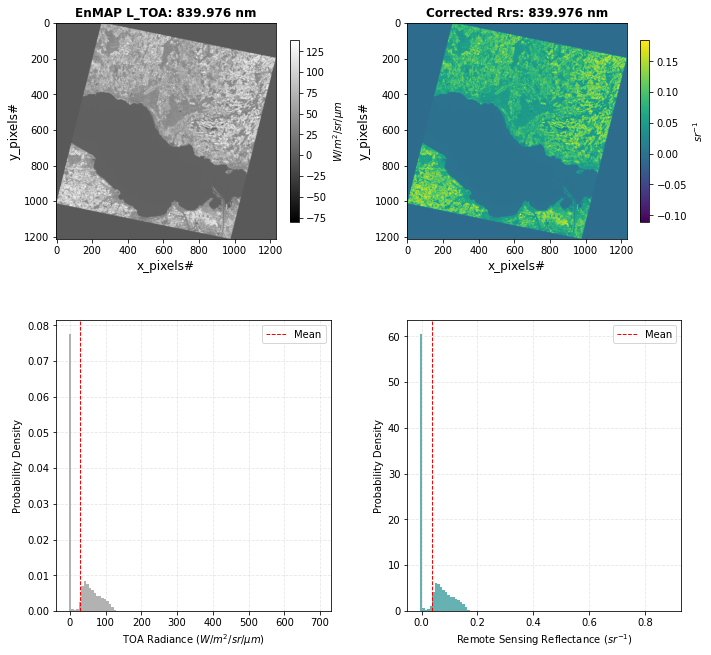

Processing band # 73
Band ID  73.0
Band wavelength center 847.847
Band Gain  1.23538152595e-05
Band Offset  -0.00486007920292
6S params for band 73: {'spherical_albedo': 0.02109, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9953, 'total_gaseous_transmittance': 0.9953, 'total_scattering_transmittance_upward': 0.98796, 'total_scattering_transmittance_downward': 0.98288, 'atmospheric_intrinsic_radiance': 1.677, 'direct_solar_irradiance': 702.365, 'diffuse_solar_irradiance': 19.967}
Performing 6ABOS atmospheric correction on EnMAP band: 847.847 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


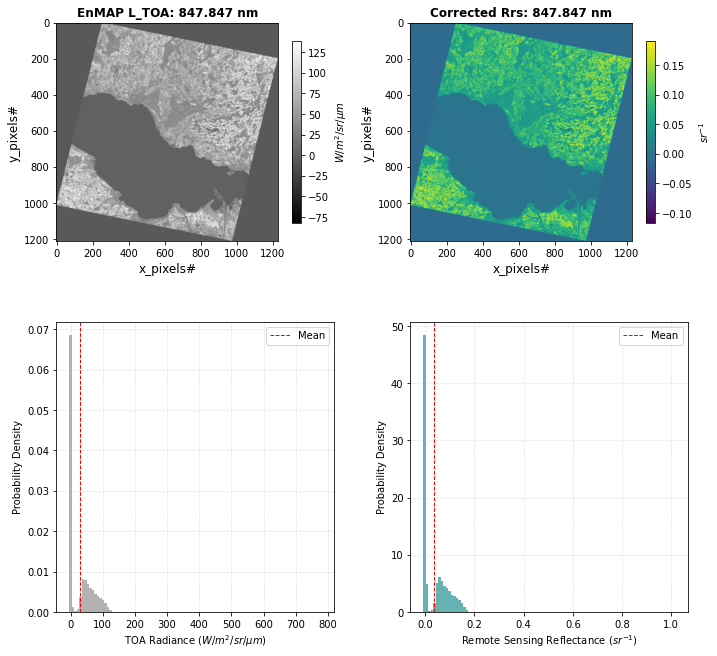

Processing band # 74
Band ID  74.0
Band wavelength center 855.757
Band Gain  1.260897269e-05
Band Offset  -0.00240419039627
6S params for band 74: {'spherical_albedo': 0.02049, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99741, 'total_gaseous_transmittance': 0.99738, 'total_scattering_transmittance_upward': 0.98834, 'total_scattering_transmittance_downward': 0.9834, 'atmospheric_intrinsic_radiance': 1.577, 'direct_solar_irradiance': 685.884, 'diffuse_solar_irradiance': 19.118}
Performing 6ABOS atmospheric correction on EnMAP band: 855.757 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


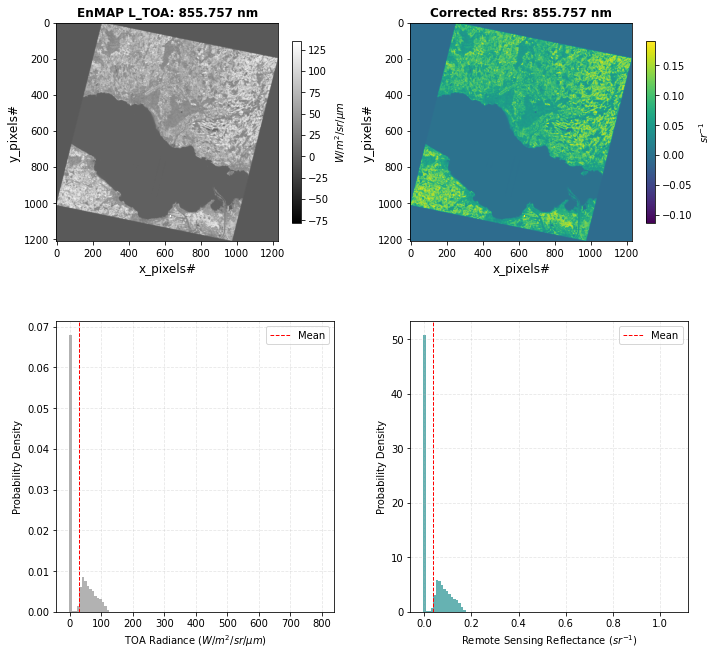

Processing band # 75
Band ID  75.0
Band wavelength center 863.703
Band Gain  1.28681129192e-05
Band Offset  -0.0053890394336
6S params for band 75: {'spherical_albedo': 0.01995, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99976, 'total_gaseous_transmittance': 0.99966, 'total_scattering_transmittance_upward': 0.9886, 'total_scattering_transmittance_downward': 0.98376, 'atmospheric_intrinsic_radiance': 1.524, 'direct_solar_irradiance': 686.276, 'diffuse_solar_irradiance': 18.684}
Performing 6ABOS atmospheric correction on EnMAP band: 863.703 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


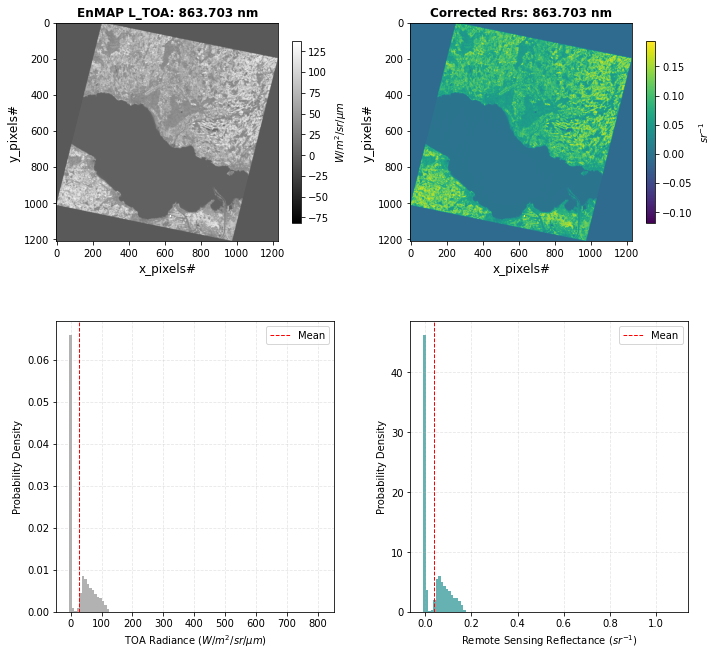

Processing band # 76
Band ID  76.0
Band wavelength center 871.683
Band Gain  1.41936118403e-05
Band Offset  -0.00199022355924
6S params for band 76: {'spherical_albedo': 0.01944, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99981, 'total_gaseous_transmittance': 0.99979, 'total_scattering_transmittance_upward': 0.98877, 'total_scattering_transmittance_downward': 0.98401, 'atmospheric_intrinsic_radiance': 1.491, 'direct_solar_irradiance': 693.89, 'diffuse_solar_irradiance': 18.382}
Performing 6ABOS atmospheric correction on EnMAP band: 871.683 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


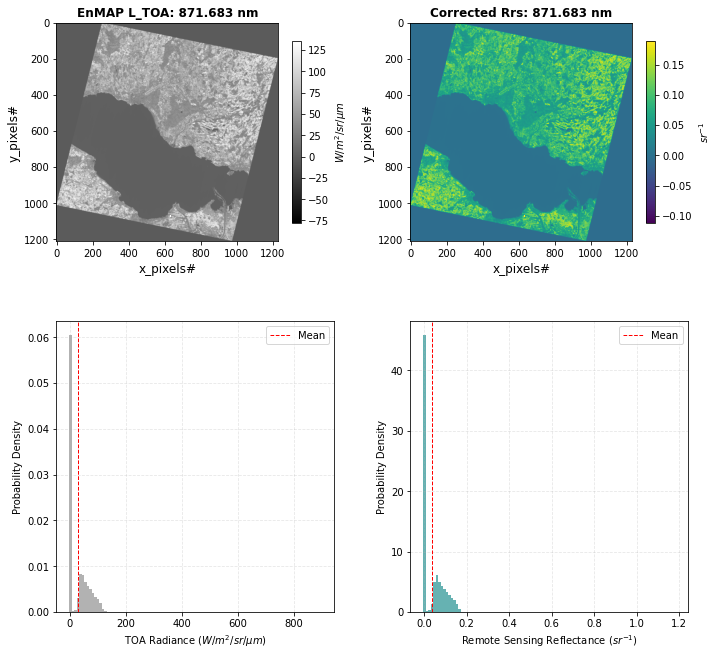

Processing band # 77
Band ID  77.0
Band wavelength center 879.692
Band Gain  1.31665181425e-05
Band Offset  -0.00134674512428
6S params for band 77: {'spherical_albedo': 0.01896, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99819, 'total_gaseous_transmittance': 0.99819, 'total_scattering_transmittance_upward': 0.98894, 'total_scattering_transmittance_downward': 0.98423, 'atmospheric_intrinsic_radiance': 1.448, 'direct_solar_irradiance': 695.233, 'diffuse_solar_irradiance': 17.933}
Performing 6ABOS atmospheric correction on EnMAP band: 879.692 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


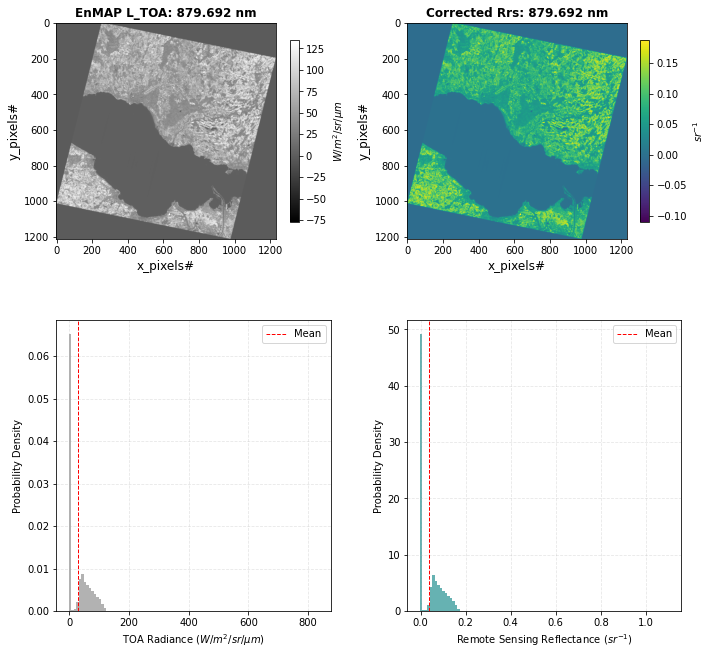

Processing band # 78
Band ID  78.0
Band wavelength center 887.729
Band Gain  1.52937856676e-05
Band Offset  -0.00382611884486
6S params for band 78: {'spherical_albedo': 0.0185, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98174, 'total_gaseous_transmittance': 0.98174, 'total_scattering_transmittance_upward': 0.9891, 'total_scattering_transmittance_downward': 0.98446, 'atmospheric_intrinsic_radiance': 1.378, 'direct_solar_irradiance': 676.657, 'diffuse_solar_irradiance': 17.004}
Performing 6ABOS atmospheric correction on EnMAP band: 887.729 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


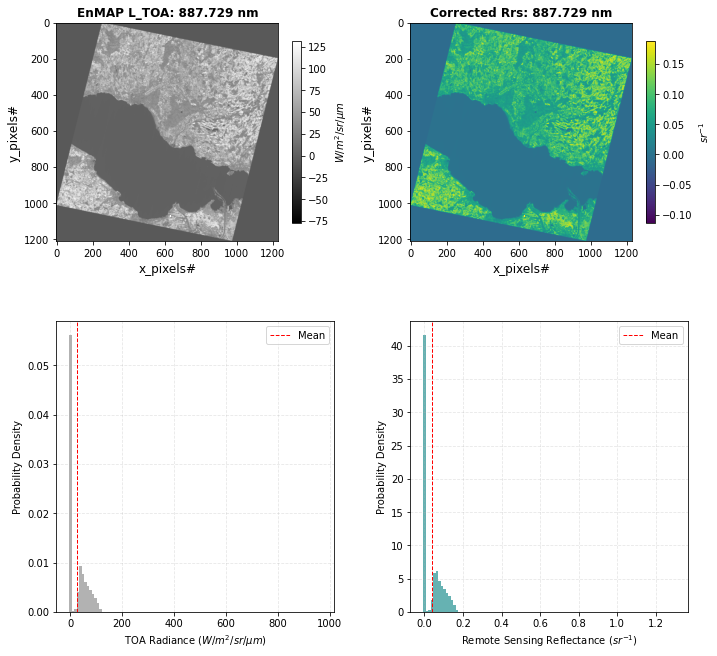

Processing band # 79
Band ID  79.0
Band wavelength center 895.789
Band Gain  1.46510979987e-05
Band Offset  -0.00317110051093
6S params for band 79: {'spherical_albedo': 0.01804, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.85955, 'total_gaseous_transmittance': 0.85955, 'total_scattering_transmittance_upward': 0.98927, 'total_scattering_transmittance_downward': 0.98469, 'atmospheric_intrinsic_radiance': 1.295, 'direct_solar_irradiance': 605.345, 'diffuse_solar_irradiance': 14.834}
Performing 6ABOS atmospheric correction on EnMAP band: 895.789 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


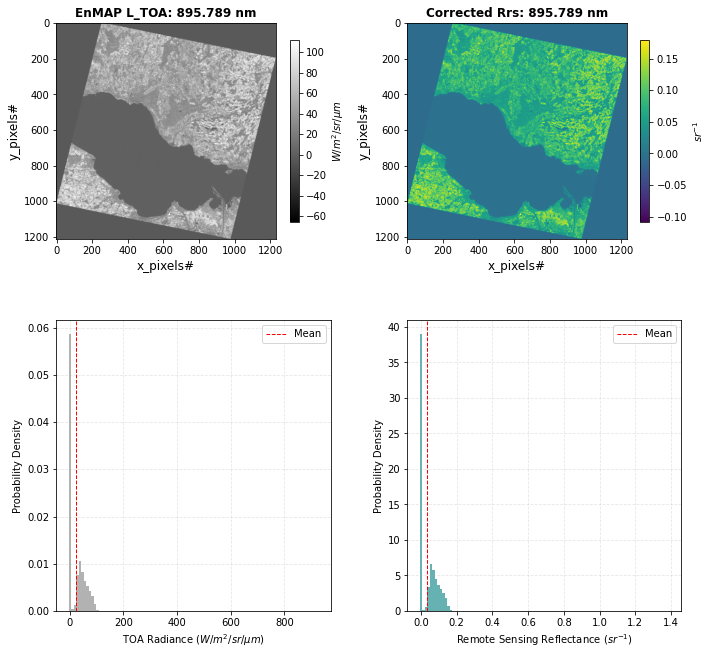

Processing band # 80
Band ID  80.0
Band wavelength center 901.962
Band Gain  6.37118253636e-06
Band Offset  -0.000932450003603
6S params for band 80: {'spherical_albedo': 0.0177, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.786, 'total_gaseous_transmittance': 0.786, 'total_scattering_transmittance_upward': 0.98939, 'total_scattering_transmittance_downward': 0.98486, 'atmospheric_intrinsic_radiance': 1.236, 'direct_solar_irradiance': 560.129, 'diffuse_solar_irradiance': 13.45}
Performing 6ABOS atmospheric correction on EnMAP band: 901.962 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


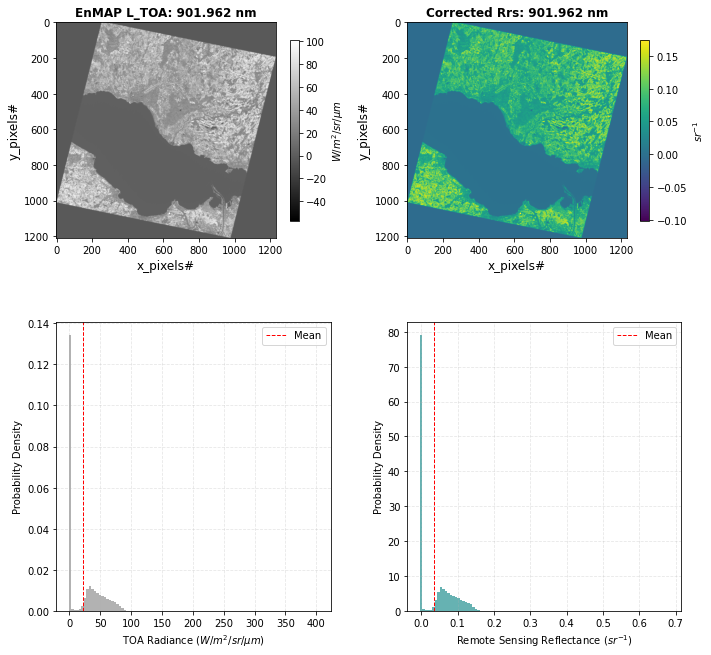

Processing band # 81
Band ID  81.0
Band wavelength center 903.87
Band Gain  1.34492268273e-05
Band Offset  -0.00288984691477
6S params for band 81: {'spherical_albedo': 0.0176, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.78517, 'total_gaseous_transmittance': 0.78517, 'total_scattering_transmittance_upward': 0.98943, 'total_scattering_transmittance_downward': 0.98492, 'atmospheric_intrinsic_radiance': 1.222, 'direct_solar_irradiance': 558.194, 'diffuse_solar_irradiance': 13.324}
Performing 6ABOS atmospheric correction on EnMAP band: 903.87 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


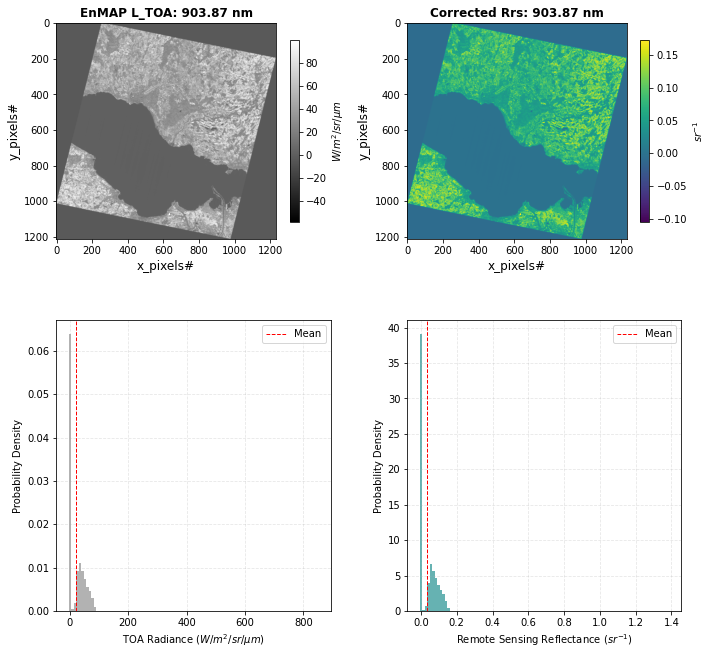

Processing band # 82
Band ID  82.0
Band wavelength center 911.572
Band Gain  6.24962213125e-06
Band Offset  -0.000934433174009
6S params for band 82: {'spherical_albedo': 0.01719, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.77062, 'total_gaseous_transmittance': 0.77062, 'total_scattering_transmittance_upward': 0.98958, 'total_scattering_transmittance_downward': 0.98513, 'atmospheric_intrinsic_radiance': 1.167, 'direct_solar_irradiance': 546.864, 'diffuse_solar_irradiance': 12.75}
Performing 6ABOS atmospheric correction on EnMAP band: 911.572 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


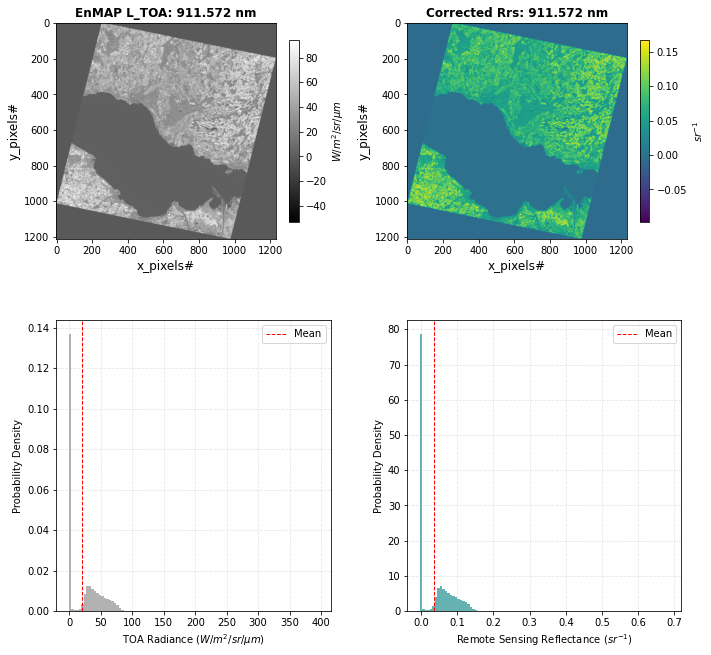

Processing band # 83
Band ID  83.0
Band wavelength center 911.968
Band Gain  1.2401703436e-05
Band Offset  -0.00263012501194
6S params for band 83: {'spherical_albedo': 0.01717, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.77291, 'total_gaseous_transmittance': 0.77291, 'total_scattering_transmittance_upward': 0.98959, 'total_scattering_transmittance_downward': 0.98514, 'atmospheric_intrinsic_radiance': 1.164, 'direct_solar_irradiance': 547.482, 'diffuse_solar_irradiance': 12.749}
Performing 6ABOS atmospheric correction on EnMAP band: 911.968 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


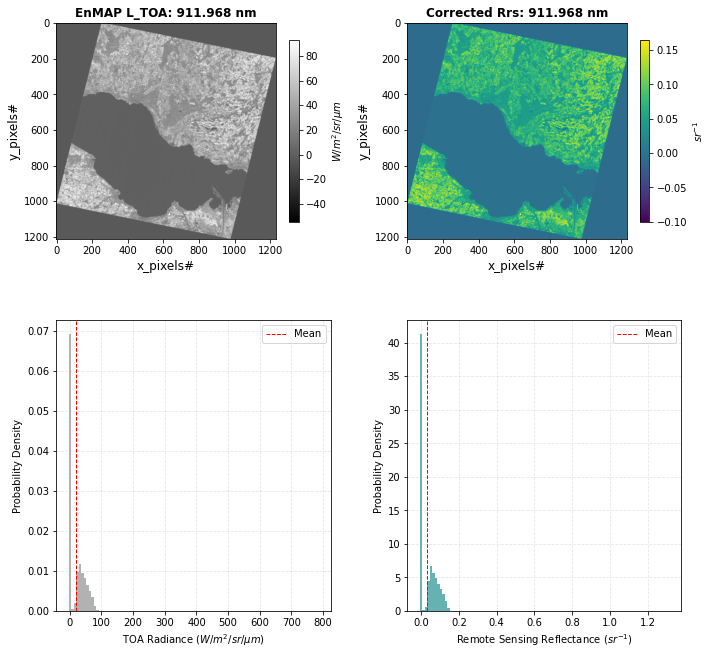

Processing band # 84
Band ID  84.0
Band wavelength center 920.08
Band Gain  1.29237374937e-05
Band Offset  -0.0028743112995
6S params for band 84: {'spherical_albedo': 0.01676, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.82259, 'total_gaseous_transmittance': 0.82259, 'total_scattering_transmittance_upward': 0.98975, 'total_scattering_transmittance_downward': 0.98536, 'atmospheric_intrinsic_radiance': 1.116, 'direct_solar_irradiance': 562.759, 'diffuse_solar_irradiance': 12.79}
Performing 6ABOS atmospheric correction on EnMAP band: 920.08 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


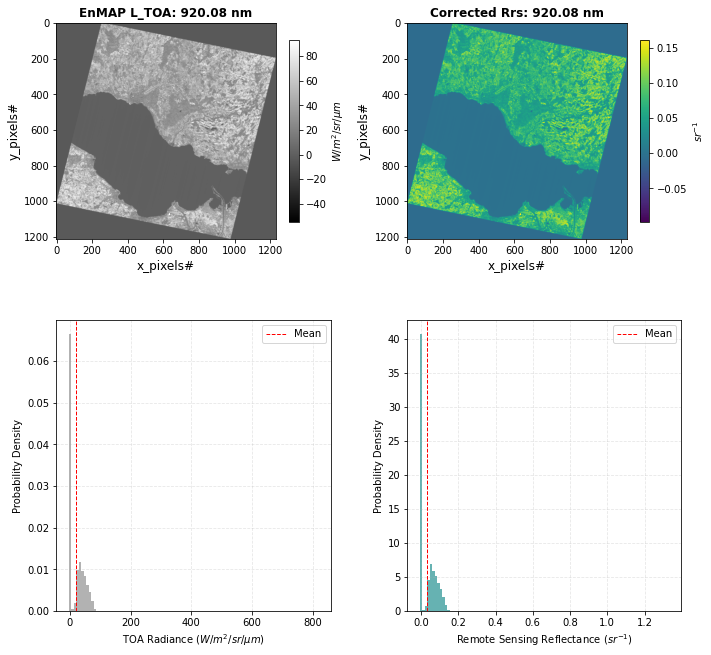

Processing band # 85
Band ID  85.0
Band wavelength center 921.32
Band Gain  6.1524396566e-06
Band Offset  -0.00124025263989
6S params for band 85: {'spherical_albedo': 0.0167, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.8325, 'total_gaseous_transmittance': 0.8325, 'total_scattering_transmittance_upward': 0.98977, 'total_scattering_transmittance_downward': 0.9854, 'atmospheric_intrinsic_radiance': 1.11, 'direct_solar_irradiance': 566.141, 'diffuse_solar_irradiance': 12.822}
Performing 6ABOS atmospheric correction on EnMAP band: 921.32 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


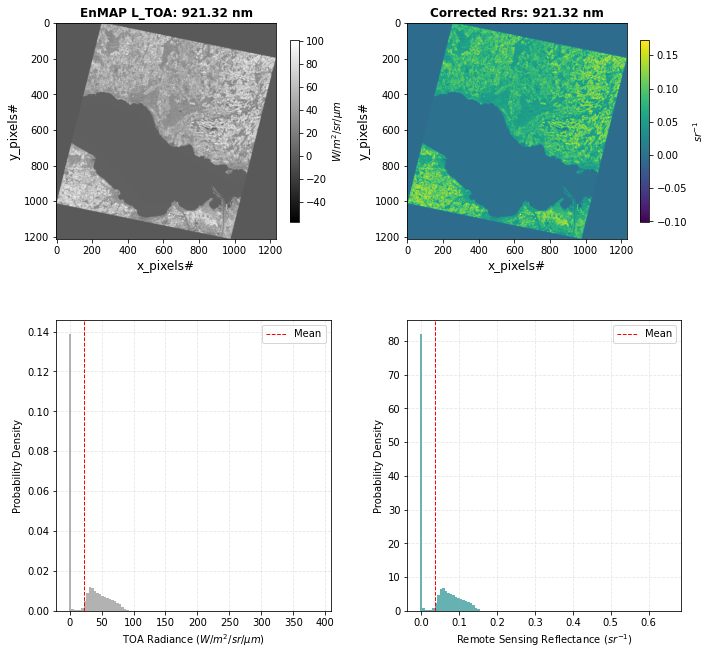

Processing band # 86
Band ID  86.0
Band wavelength center 928.204
Band Gain  1.02872720013e-05
Band Offset  -0.00294799159672
6S params for band 86: {'spherical_albedo': 0.01636, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.64112, 'total_gaseous_transmittance': 0.64112, 'total_scattering_transmittance_upward': 0.98991, 'total_scattering_transmittance_downward': 0.98559, 'atmospheric_intrinsic_radiance': 1.034, 'direct_solar_irradiance': 454.43, 'diffuse_solar_irradiance': 10.119}
Performing 6ABOS atmospheric correction on EnMAP band: 928.204 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 928.204 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 87
Band ID  87.0
Band wavelength center 931.204
Band Gain  5.57657050982e-06
Band Offset  -0.000262798028524
6S params for band 87: {'spherical_albedo': 0.01622, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.50382, 'total_gaseous_tra

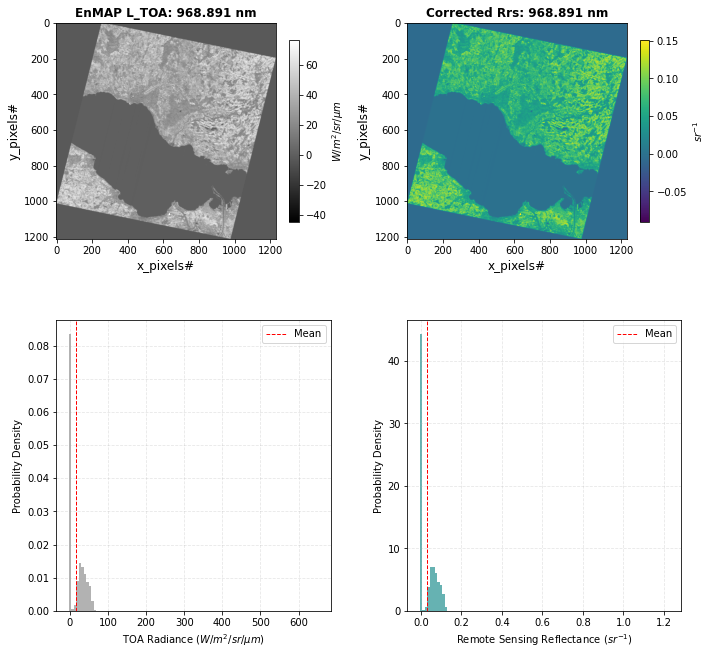

Processing band # 96
Band ID  96.0
Band wavelength center 972.017
Band Gain  5.07284104633e-06
Band Offset  -0.00143884522524
6S params for band 96: {'spherical_albedo': 0.01441, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.84152, 'total_gaseous_transmittance': 0.84152, 'total_scattering_transmittance_upward': 0.99074, 'total_scattering_transmittance_downward': 0.98675, 'atmospheric_intrinsic_radiance': 0.826, 'direct_solar_irradiance': 511.913, 'diffuse_solar_irradiance': 10.108}
Performing 6ABOS atmospheric correction on EnMAP band: 972.017 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


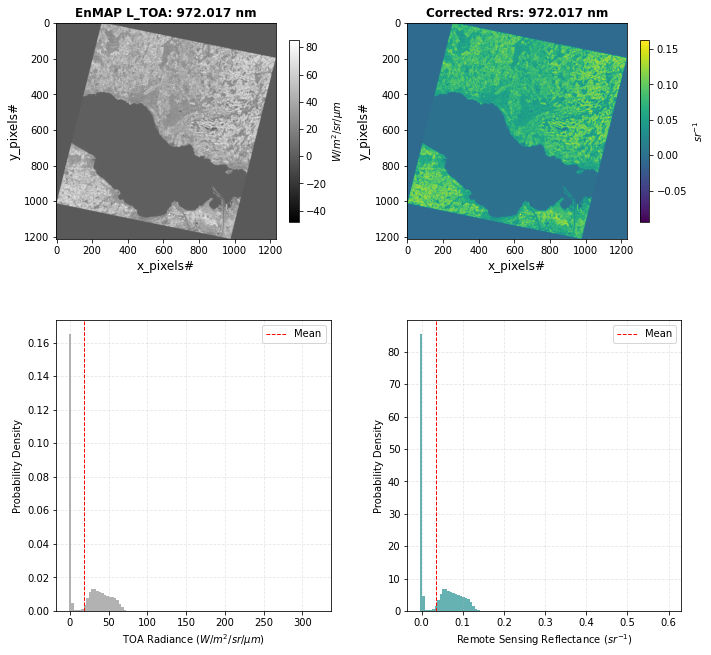

Processing band # 97
Band ID  97.0
Band wavelength center 977.037
Band Gain  1.08277211603e-05
Band Offset  -0.00251785891789
6S params for band 97: {'spherical_albedo': 0.01421, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.8692, 'total_gaseous_transmittance': 0.8692, 'total_scattering_transmittance_upward': 0.99083, 'total_scattering_transmittance_downward': 0.98688, 'atmospheric_intrinsic_radiance': 0.806, 'direct_solar_irradiance': 518.991, 'diffuse_solar_irradiance': 10.124}
Performing 6ABOS atmospheric correction on EnMAP band: 977.037 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


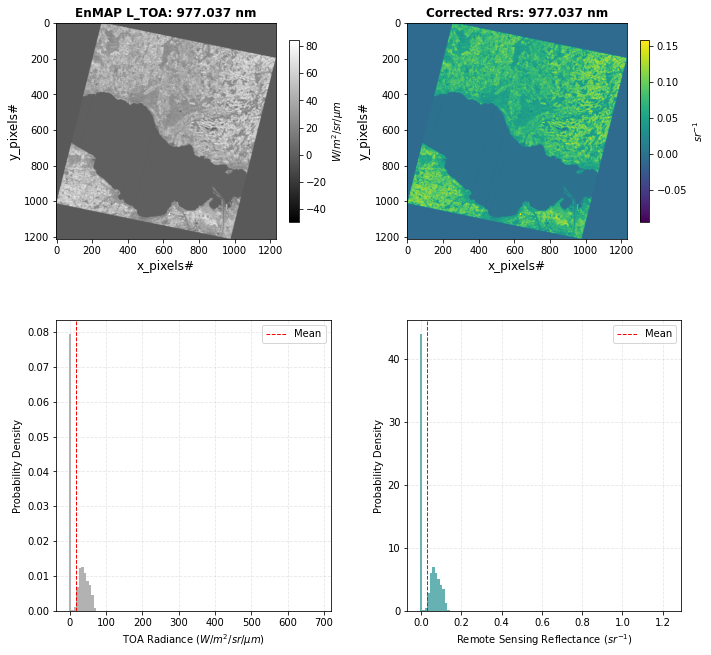

Processing band # 98
Band ID  98.0
Band wavelength center 982.524
Band Gain  4.86268087524e-06
Band Offset  -0.00181652350708
6S params for band 98: {'spherical_albedo': 0.01399, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.90622, 'total_gaseous_transmittance': 0.90622, 'total_scattering_transmittance_upward': 0.99093, 'total_scattering_transmittance_downward': 0.98702, 'atmospheric_intrinsic_radiance': 0.785, 'direct_solar_irradiance': 528.554, 'diffuse_solar_irradiance': 10.174}
Performing 6ABOS atmospheric correction on EnMAP band: 982.524 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


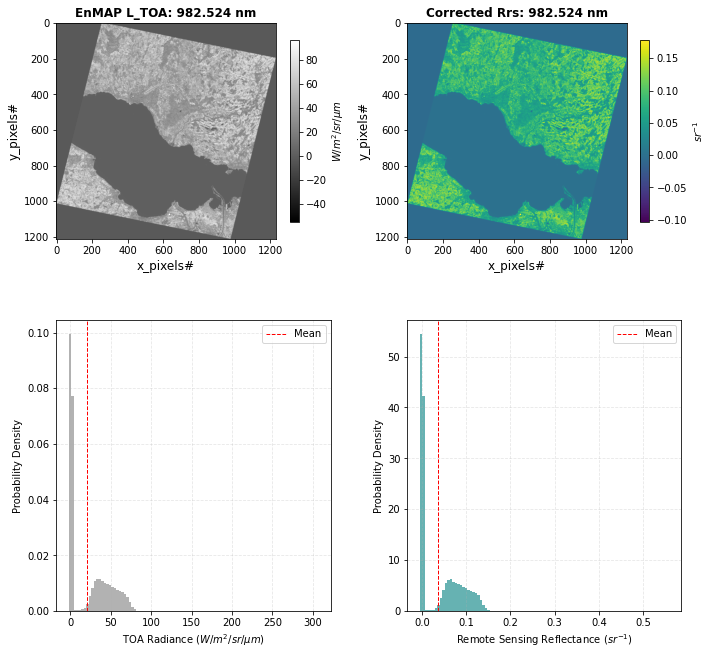

Processing band # 99
Band ID  99.0
Band wavelength center 985.186
Band Gain  1.18372465223e-05
Band Offset  -0.00229424740809
6S params for band 99: {'spherical_albedo': 0.01389, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9318, 'total_gaseous_transmittance': 0.9318, 'total_scattering_transmittance_upward': 0.99098, 'total_scattering_transmittance_downward': 0.98709, 'atmospheric_intrinsic_radiance': 0.776, 'direct_solar_irradiance': 535.534, 'diffuse_solar_irradiance': 10.244}
Performing 6ABOS atmospheric correction on EnMAP band: 985.186 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


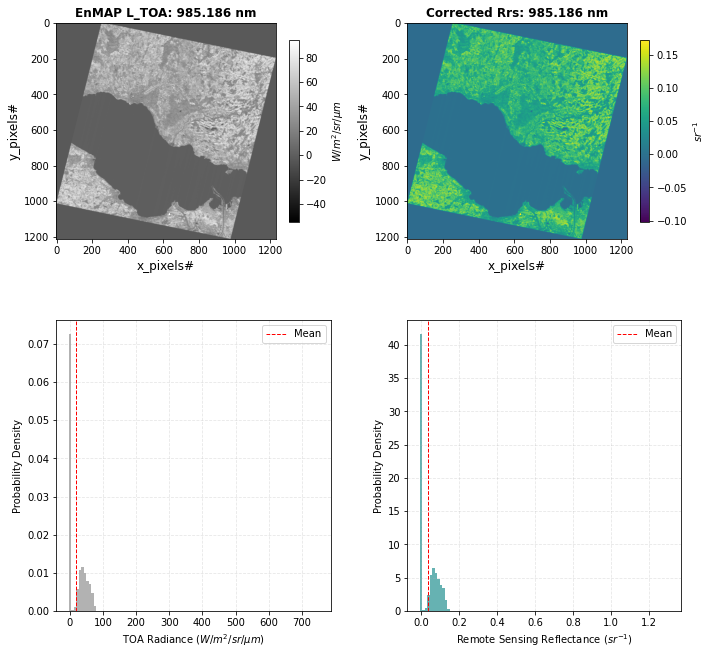

Processing band # 100
Band ID  100.0
Band wavelength center 993.145
Band Gain  4.68196512946e-06
Band Offset  -0.00219098382795
6S params for band 100: {'spherical_albedo': 0.01359, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98537, 'total_gaseous_transmittance': 0.98537, 'total_scattering_transmittance_upward': 0.99113, 'total_scattering_transmittance_downward': 0.98729, 'atmospheric_intrinsic_radiance': 0.747, 'direct_solar_irradiance': 546.141, 'diffuse_solar_irradiance': 10.258}
Performing 6ABOS atmospheric correction on EnMAP band: 993.145 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


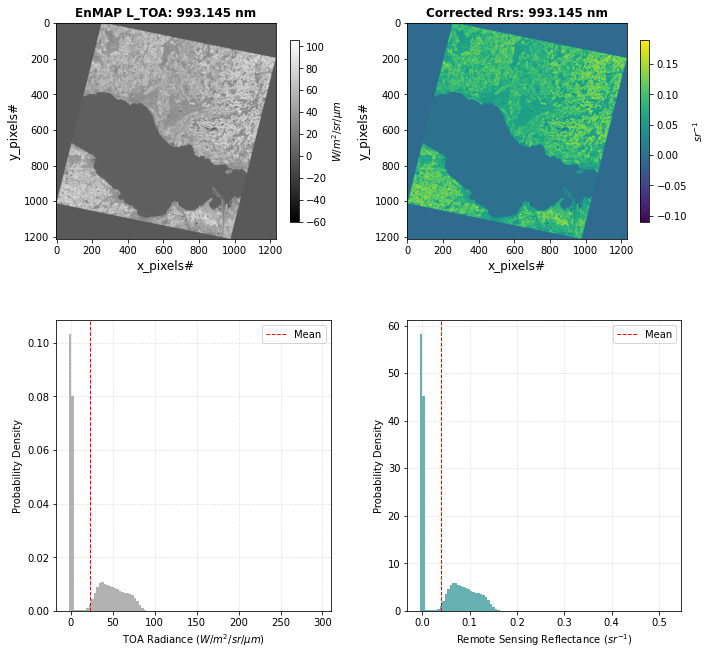

Processing band # 101
Band ID  101.0
Band wavelength center 993.338
Band Gain  1.21848878343e-05
Band Offset  -0.0025369645317
6S params for band 101: {'spherical_albedo': 0.01358, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98537, 'total_gaseous_transmittance': 0.98537, 'total_scattering_transmittance_upward': 0.99113, 'total_scattering_transmittance_downward': 0.9873, 'atmospheric_intrinsic_radiance': 0.746, 'direct_solar_irradiance': 545.912, 'diffuse_solar_irradiance': 10.249}
Performing 6ABOS atmospheric correction on EnMAP band: 993.338 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


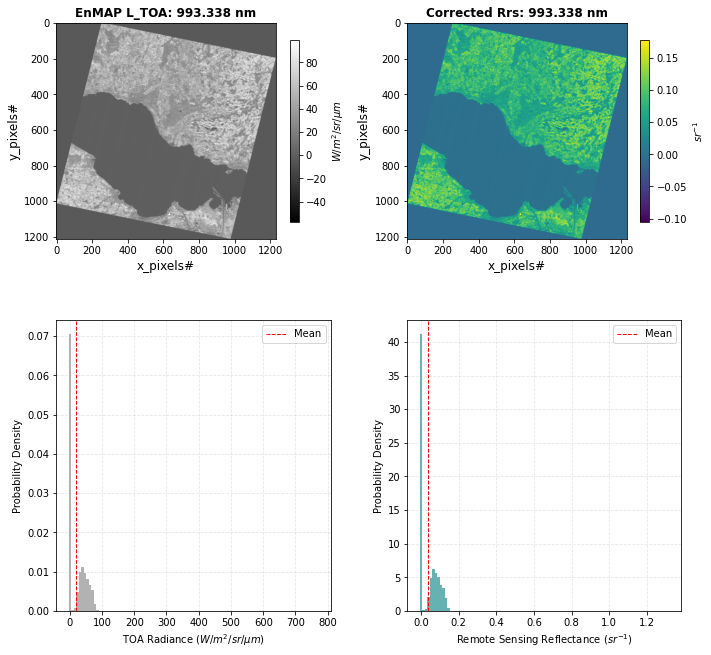

Processing band # 102
Band ID  102.0
Band wavelength center 1003.88
Band Gain  4.5911552239e-06
Band Offset  -0.00214911691415
6S params for band 102: {'spherical_albedo': 0.01319, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99201, 'total_gaseous_transmittance': 0.99201, 'total_scattering_transmittance_upward': 0.99132, 'total_scattering_transmittance_downward': 0.98757, 'atmospheric_intrinsic_radiance': 0.703, 'direct_solar_irradiance': 535.601, 'diffuse_solar_irradiance': 9.821}
Performing 6ABOS atmospheric correction on EnMAP band: 1003.88 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


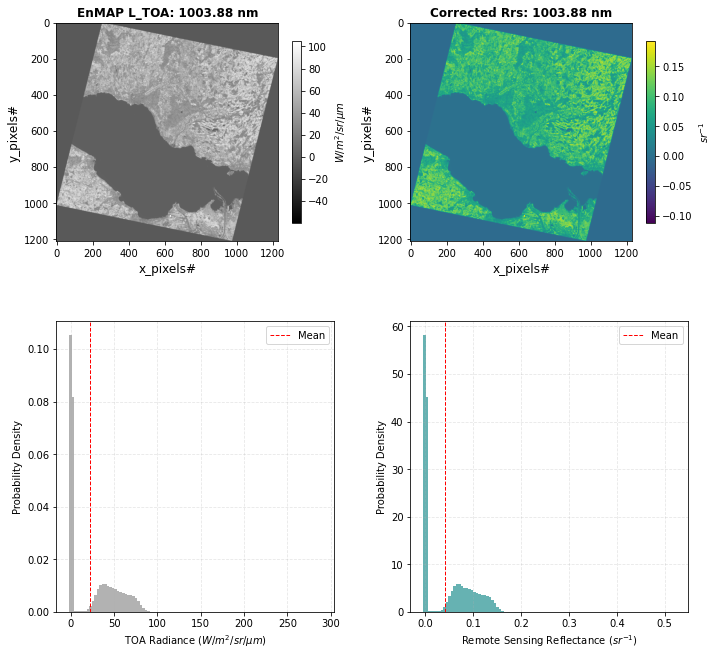

Processing band # 103
Band ID  103.0
Band wavelength center 1014.72
Band Gain  4.49507418094e-06
Band Offset  -0.00220913654114
6S params for band 103: {'spherical_albedo': 0.01281, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99439, 'total_gaseous_transmittance': 0.99439, 'total_scattering_transmittance_upward': 0.99151, 'total_scattering_transmittance_downward': 0.98784, 'atmospheric_intrinsic_radiance': 0.661, 'direct_solar_irradiance': 523.185, 'diffuse_solar_irradiance': 9.372}
Performing 6ABOS atmospheric correction on EnMAP band: 1014.72 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


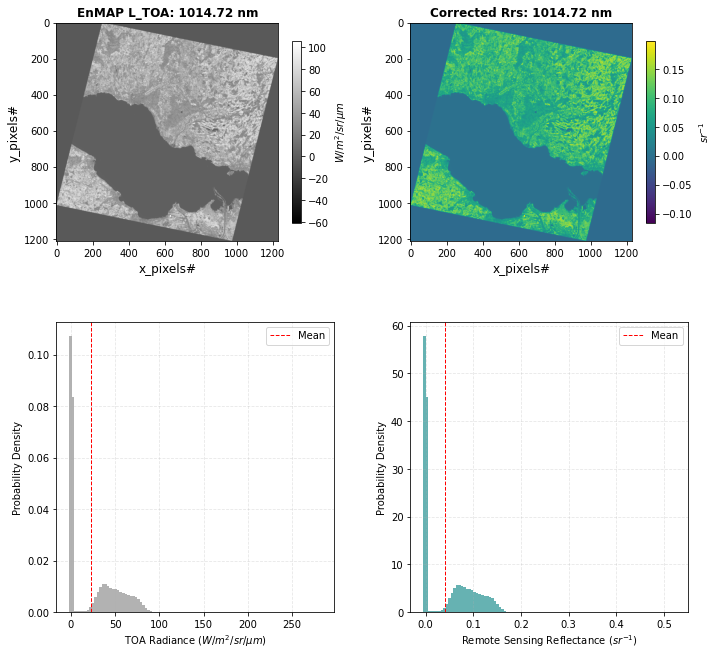

Processing band # 104
Band ID  104.0
Band wavelength center 1025.66
Band Gain  4.3408359982e-06
Band Offset  -0.00226109259498
6S params for band 104: {'spherical_albedo': 0.01243, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99727, 'total_gaseous_transmittance': 0.99727, 'total_scattering_transmittance_upward': 0.99171, 'total_scattering_transmittance_downward': 0.98811, 'atmospheric_intrinsic_radiance': 0.621, 'direct_solar_irradiance': 511.244, 'diffuse_solar_irradiance': 8.954}
Performing 6ABOS atmospheric correction on EnMAP band: 1025.66 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


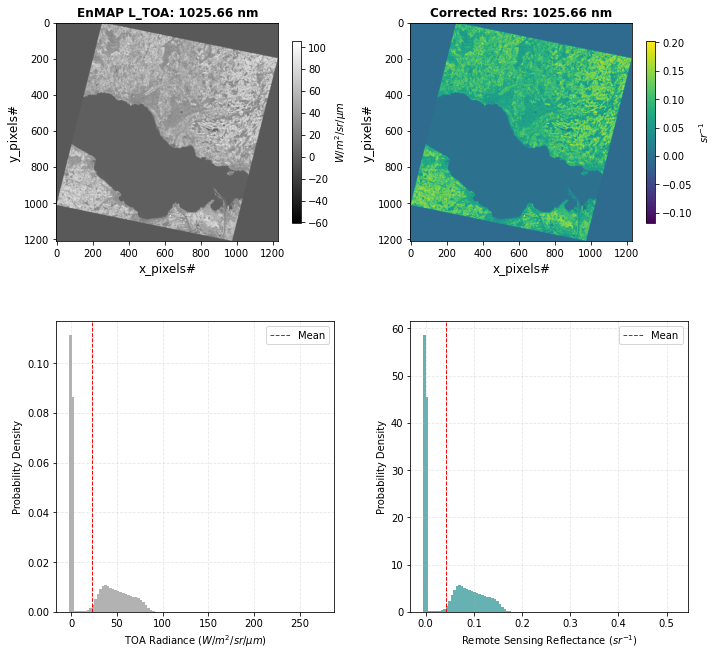

Processing band # 105
Band ID  105.0
Band wavelength center 1036.7
Band Gain  4.31634665125e-06
Band Offset  -0.00224676951014
6S params for band 105: {'spherical_albedo': 0.01207, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99984, 'total_gaseous_transmittance': 0.99982, 'total_scattering_transmittance_upward': 0.9919, 'total_scattering_transmittance_downward': 0.98838, 'atmospheric_intrinsic_radiance': 0.583, 'direct_solar_irradiance': 499.159, 'diffuse_solar_irradiance': 8.554}
Performing 6ABOS atmospheric correction on EnMAP band: 1036.7 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


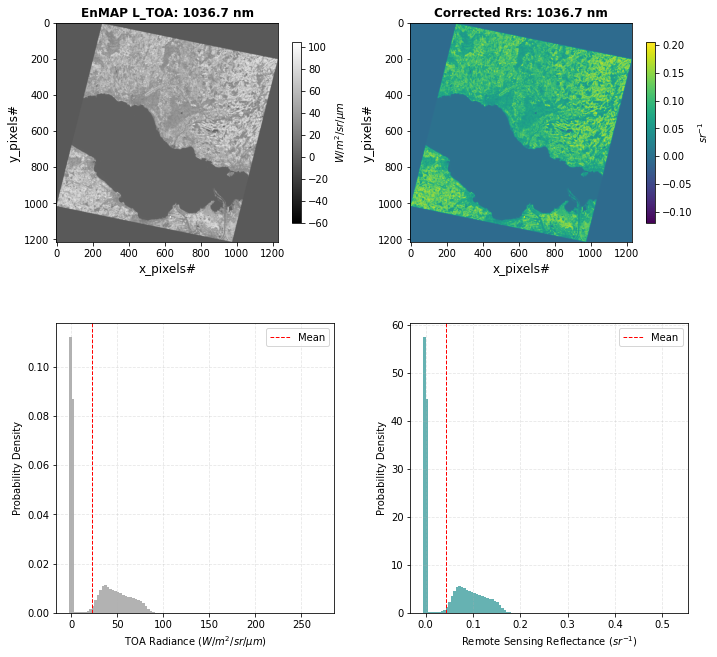

Processing band # 106
Band ID  106.0
Band wavelength center 1047.84
Band Gain  4.21422274108e-06
Band Offset  -0.00223108053879
6S params for band 106: {'spherical_albedo': 0.01172, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99997, 'total_gaseous_transmittance': 0.99929, 'total_scattering_transmittance_upward': 0.9921, 'total_scattering_transmittance_downward': 0.98865, 'atmospheric_intrinsic_radiance': 0.547, 'direct_solar_irradiance': 486.234, 'diffuse_solar_irradiance': 8.159}
Performing 6ABOS atmospheric correction on EnMAP band: 1047.84 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


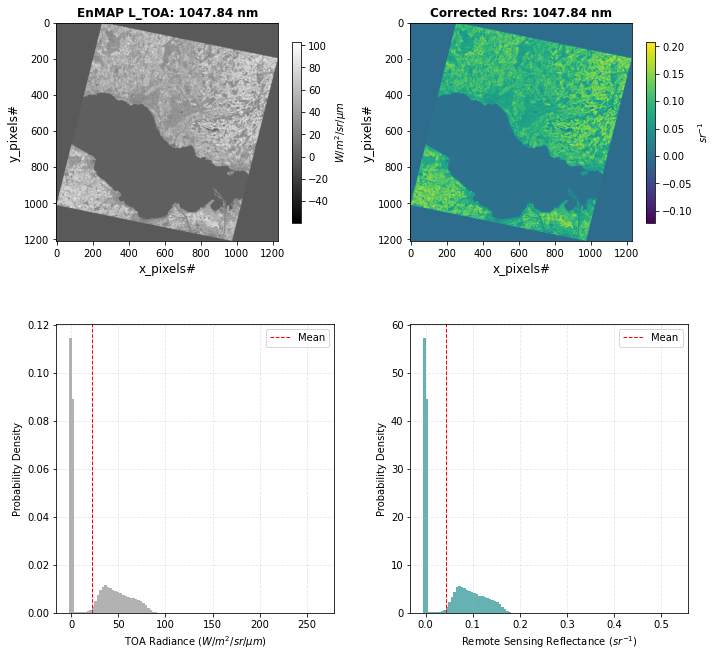

Processing band # 107
Band ID  107.0
Band wavelength center 1059.07
Band Gain  4.23924143009e-06
Band Offset  -0.00223685926835
6S params for band 107: {'spherical_albedo': 0.01138, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99915, 'total_gaseous_transmittance': 0.99872, 'total_scattering_transmittance_upward': 0.99229, 'total_scattering_transmittance_downward': 0.98892, 'atmospheric_intrinsic_radiance': 0.513, 'direct_solar_irradiance': 473.219, 'diffuse_solar_irradiance': 7.782}
Performing 6ABOS atmospheric correction on EnMAP band: 1059.07 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


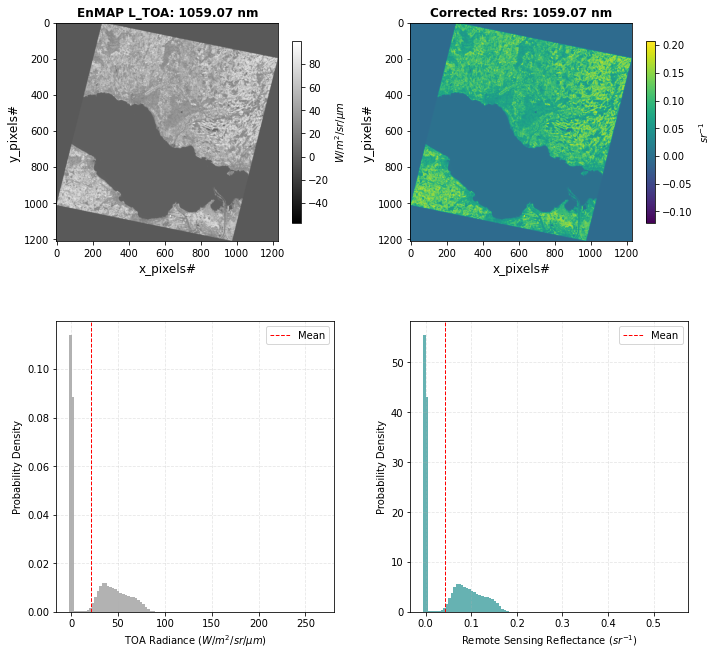

Processing band # 108
Band ID  108.0
Band wavelength center 1070.39
Band Gain  4.14246915006e-06
Band Offset  -0.00220286188869
6S params for band 108: {'spherical_albedo': 0.01106, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98708, 'total_gaseous_transmittance': 0.98659, 'total_scattering_transmittance_upward': 0.99248, 'total_scattering_transmittance_downward': 0.98919, 'atmospheric_intrinsic_radiance': 0.483, 'direct_solar_irradiance': 459.654, 'diffuse_solar_irradiance': 7.414}
Performing 6ABOS atmospheric correction on EnMAP band: 1070.39 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


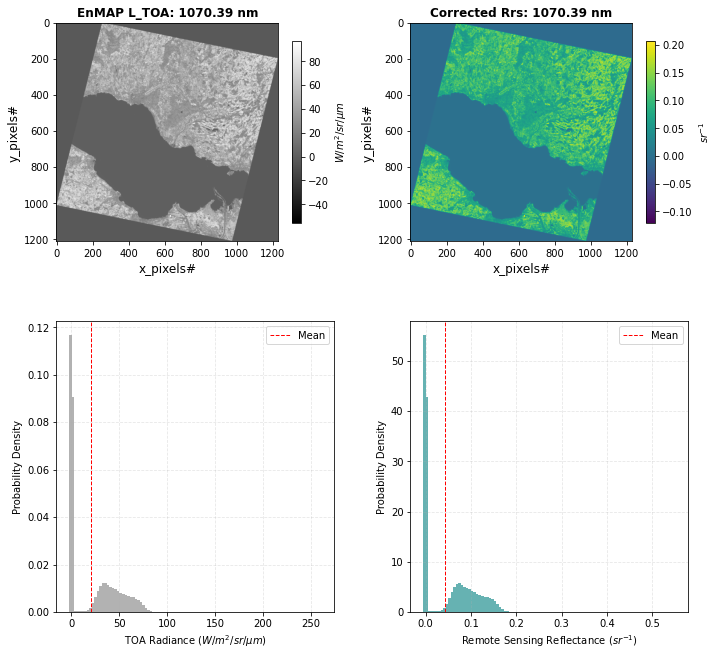

Processing band # 109
Band ID  109.0
Band wavelength center 1081.79
Band Gain  4.13646220899e-06
Band Offset  -0.00221345875643
6S params for band 109: {'spherical_albedo': 0.01074, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97123, 'total_gaseous_transmittance': 0.97121, 'total_scattering_transmittance_upward': 0.99267, 'total_scattering_transmittance_downward': 0.98946, 'atmospheric_intrinsic_radiance': 0.456, 'direct_solar_irradiance': 446.143, 'diffuse_solar_irradiance': 7.063}
Performing 6ABOS atmospheric correction on EnMAP band: 1081.79 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


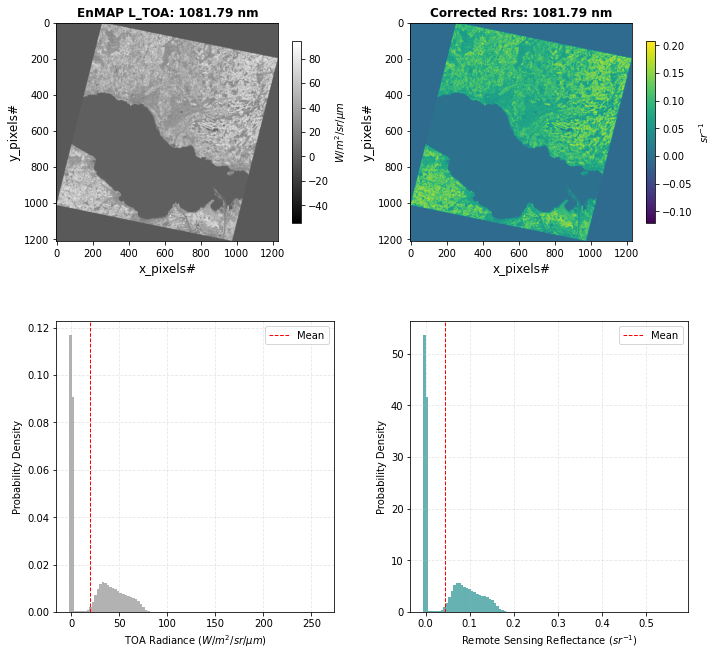

Processing band # 110
Band ID  110.0
Band wavelength center 1093.26
Band Gain  4.10818606529e-06
Band Offset  -0.00207721081674
6S params for band 110: {'spherical_albedo': 0.01043, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.93175, 'total_gaseous_transmittance': 0.93175, 'total_scattering_transmittance_upward': 0.99286, 'total_scattering_transmittance_downward': 0.98972, 'atmospheric_intrinsic_radiance': 0.428, 'direct_solar_irradiance': 425.566, 'diffuse_solar_irradiance': 6.619}
Performing 6ABOS atmospheric correction on EnMAP band: 1093.26 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


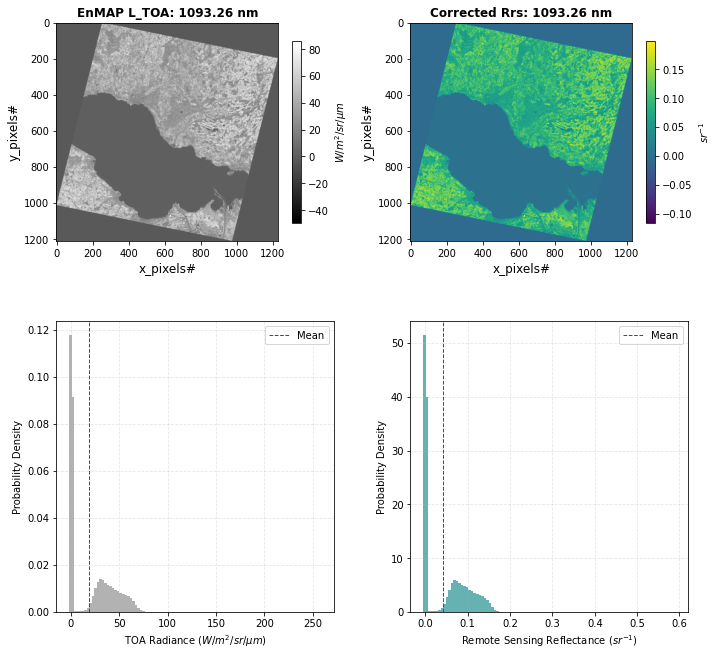

Processing band # 111
Band ID  111.0
Band wavelength center 1104.81
Band Gain  4.0700875338e-06
Band Offset  -0.00163177875635
6S params for band 111: {'spherical_albedo': 0.01013, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.81873, 'total_gaseous_transmittance': 0.81873, 'total_scattering_transmittance_upward': 0.99305, 'total_scattering_transmittance_downward': 0.98999, 'atmospheric_intrinsic_radiance': 0.396, 'direct_solar_irradiance': 379.384, 'diffuse_solar_irradiance': 5.806}
Performing 6ABOS atmospheric correction on EnMAP band: 1104.81 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


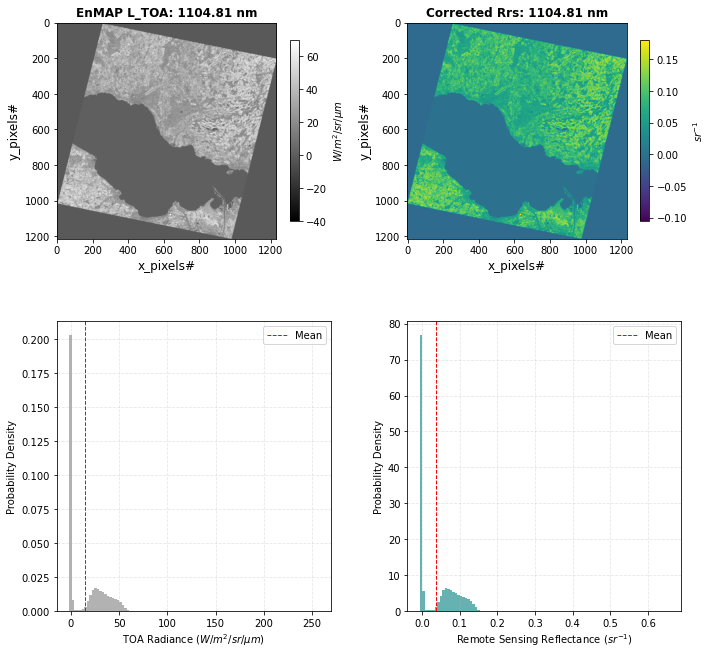

Processing band # 112
Band ID  112.0
Band wavelength center 1116.43
Band Gain  3.82061370922e-06
Band Offset  -0.000599176020113
6S params for band 112: {'spherical_albedo': 0.00985, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.45478, 'total_gaseous_transmittance': 0.45478, 'total_scattering_transmittance_upward': 0.99324, 'total_scattering_transmittance_downward': 0.99026, 'atmospheric_intrinsic_radiance': 0.342, 'direct_solar_irradiance': 235.442, 'diffuse_solar_irradiance': 3.548}
Performing 6ABOS atmospheric correction on EnMAP band: 1116.43 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 1116.43 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 113
Band ID  113.0
Band wavelength center 1128.11
Band Gain  2.62572357739e-06
Band Offset  -0.000191651377104
6S params for band 113: {'spherical_albedo': 0.00957, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.41941, 'total_gase

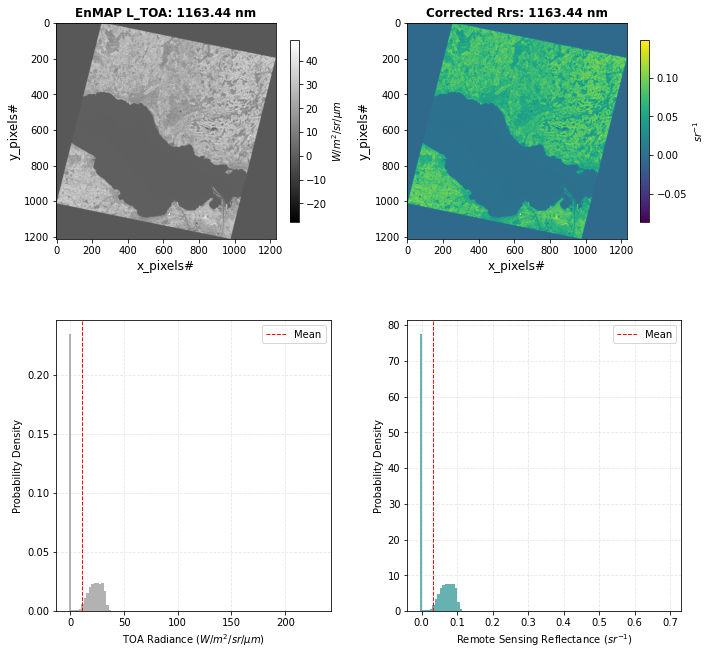

Processing band # 117
Band ID  117.0
Band wavelength center 1175.31
Band Gain  3.61937117845e-06
Band Offset  -0.00154139126671
6S params for band 117: {'spherical_albedo': 0.00855, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.81111, 'total_gaseous_transmittance': 0.81111, 'total_scattering_transmittance_upward': 0.99417, 'total_scattering_transmittance_downward': 0.99156, 'atmospheric_intrinsic_radiance': 0.281, 'direct_solar_irradiance': 334.74, 'diffuse_solar_irradiance': 4.706}
Performing 6ABOS atmospheric correction on EnMAP band: 1175.31 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


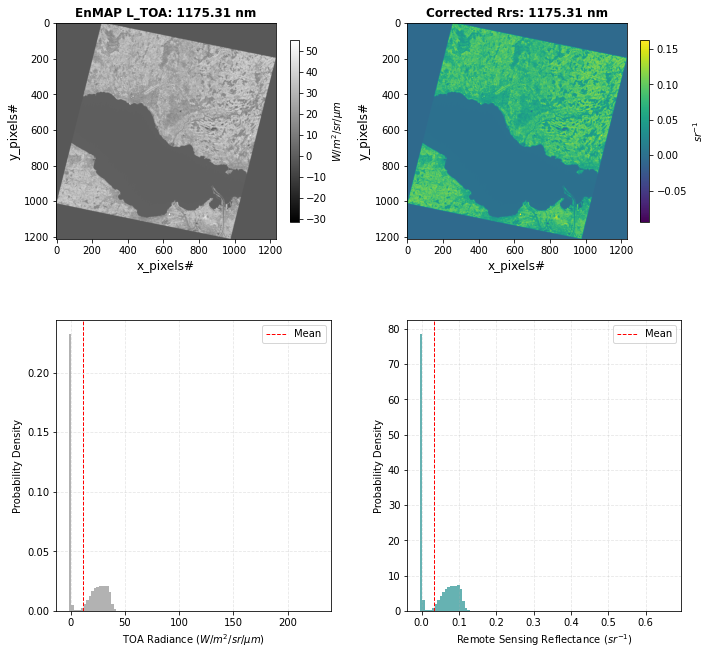

Processing band # 118
Band ID  118.0
Band wavelength center 1187.2
Band Gain  3.55819374196e-06
Band Offset  -0.00158859016973
6S params for band 118: {'spherical_albedo': 0.00832, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.89505, 'total_gaseous_transmittance': 0.89505, 'total_scattering_transmittance_upward': 0.99436, 'total_scattering_transmittance_downward': 0.99181, 'atmospheric_intrinsic_radiance': 0.27, 'direct_solar_irradiance': 351.41, 'diffuse_solar_irradiance': 4.885}
Performing 6ABOS atmospheric correction on EnMAP band: 1187.2 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


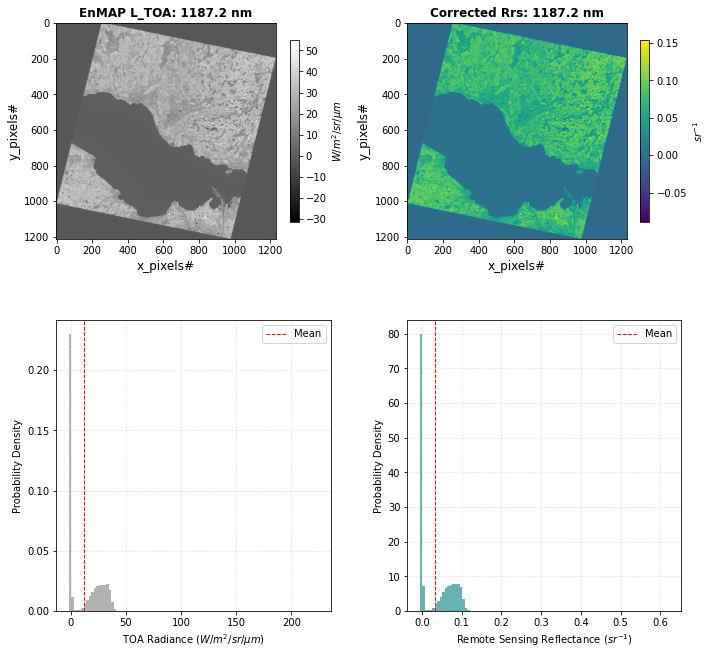

Processing band # 119
Band ID  119.0
Band wavelength center 1199.11
Band Gain  3.64711888961e-06
Band Offset  -0.00161105074369
6S params for band 119: {'spherical_albedo': 0.00809, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9192, 'total_gaseous_transmittance': 0.91704, 'total_scattering_transmittance_upward': 0.99454, 'total_scattering_transmittance_downward': 0.99207, 'atmospheric_intrinsic_radiance': 0.256, 'direct_solar_irradiance': 349.447, 'diffuse_solar_irradiance': 4.808}
Performing 6ABOS atmospheric correction on EnMAP band: 1199.11 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


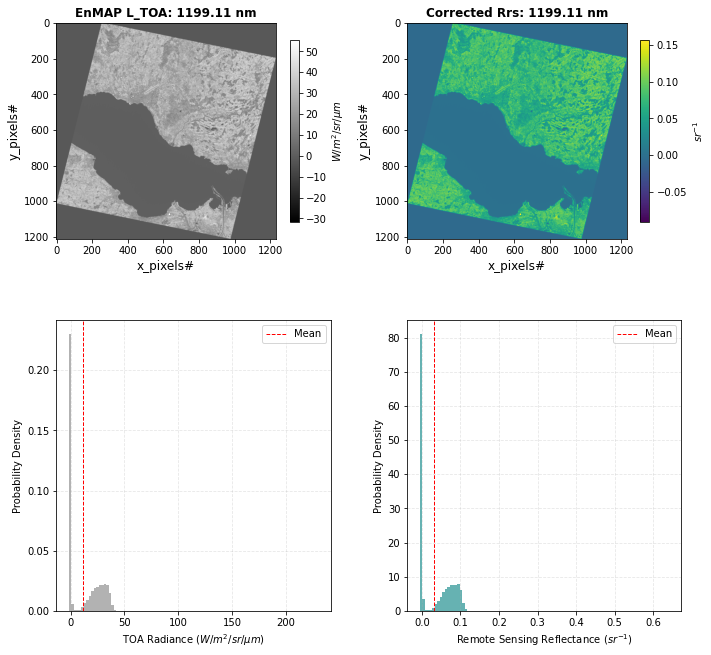

Processing band # 120
Band ID  120.0
Band wavelength center 1211.05
Band Gain  3.60974979513e-06
Band Offset  -0.00167928432518
6S params for band 120: {'spherical_albedo': 0.00787, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.93698, 'total_gaseous_transmittance': 0.93222, 'total_scattering_transmittance_upward': 0.99472, 'total_scattering_transmittance_downward': 0.99232, 'atmospheric_intrinsic_radiance': 0.24, 'direct_solar_irradiance': 343.232, 'diffuse_solar_irradiance': 4.677}
Performing 6ABOS atmospheric correction on EnMAP band: 1211.05 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


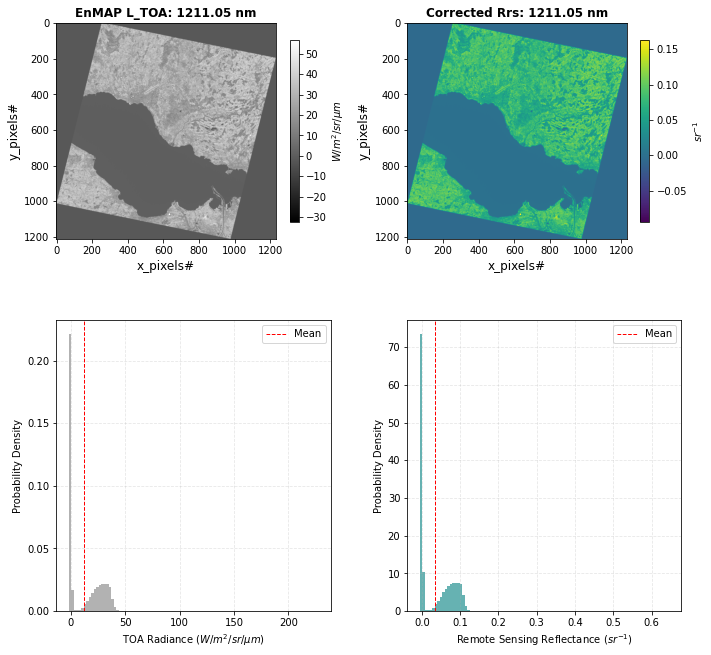

Processing band # 121
Band ID  121.0
Band wavelength center 1223.0
Band Gain  3.54609732065e-06
Band Offset  -0.00183868160751
6S params for band 121: {'spherical_albedo': 0.00766, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98226, 'total_gaseous_transmittance': 0.97778, 'total_scattering_transmittance_upward': 0.99489, 'total_scattering_transmittance_downward': 0.99257, 'atmospheric_intrinsic_radiance': 0.227, 'direct_solar_irradiance': 343.199, 'diffuse_solar_irradiance': 4.635}
Performing 6ABOS atmospheric correction on EnMAP band: 1223.0 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


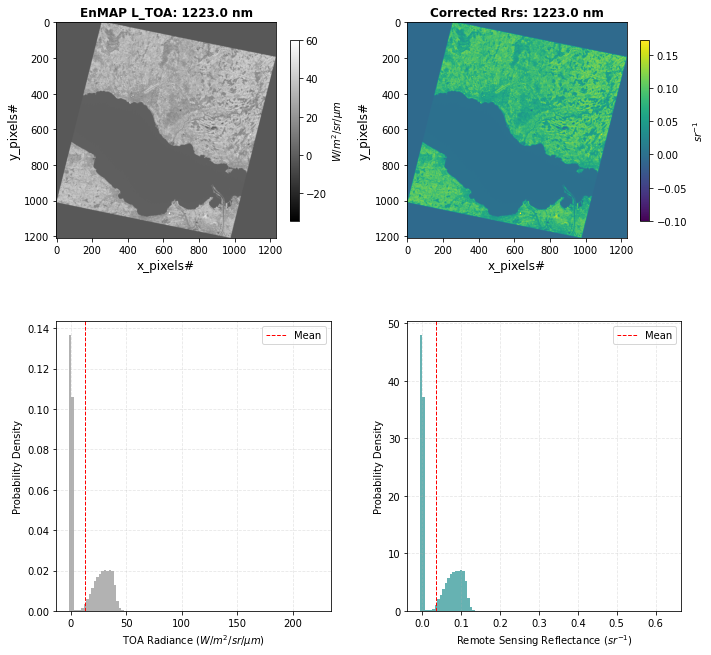

Processing band # 122
Band ID  122.0
Band wavelength center 1234.97
Band Gain  3.5452487362e-06
Band Offset  -0.00192903208718
6S params for band 122: {'spherical_albedo': 0.00746, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99524, 'total_gaseous_transmittance': 0.99489, 'total_scattering_transmittance_upward': 0.99507, 'total_scattering_transmittance_downward': 0.99281, 'atmospheric_intrinsic_radiance': 0.214, 'direct_solar_irradiance': 335.722, 'diffuse_solar_irradiance': 4.494}
Performing 6ABOS atmospheric correction on EnMAP band: 1234.97 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


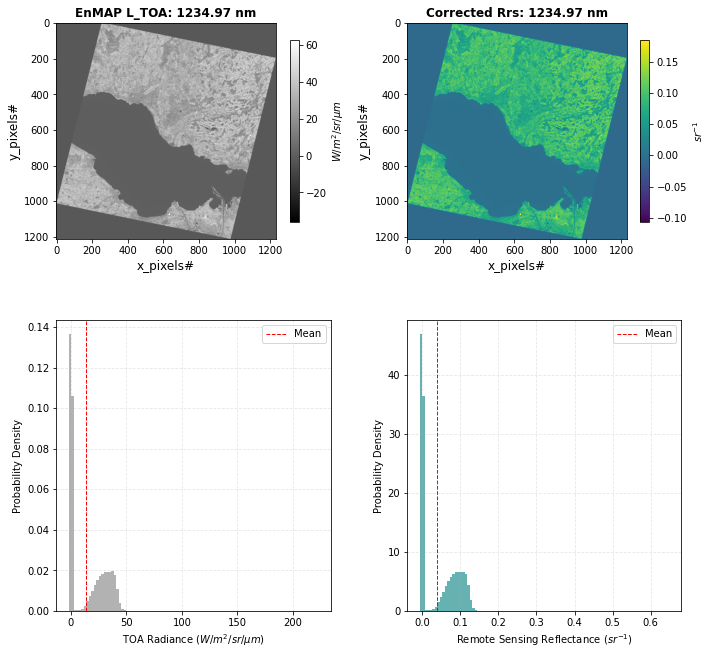

Processing band # 123
Band ID  123.0
Band wavelength center 1246.95
Band Gain  3.48397125224e-06
Band Offset  -0.00194801391163
6S params for band 123: {'spherical_albedo': 0.00726, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99892, 'total_gaseous_transmittance': 0.99661, 'total_scattering_transmittance_upward': 0.99518, 'total_scattering_transmittance_downward': 0.99298, 'atmospheric_intrinsic_radiance': 0.2, 'direct_solar_irradiance': 324.839, 'diffuse_solar_irradiance': 4.278}
Performing 6ABOS atmospheric correction on EnMAP band: 1246.95 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


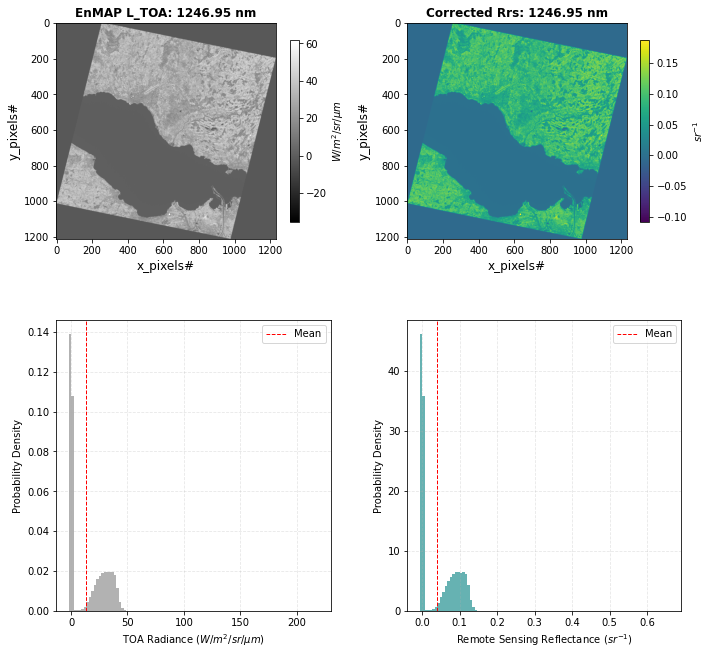

Processing band # 124
Band ID  124.0
Band wavelength center 1258.93
Band Gain  3.42440548955e-06
Band Offset  -0.00157943198215
6S params for band 124: {'spherical_albedo': 0.00707, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99858, 'total_gaseous_transmittance': 0.95913, 'total_scattering_transmittance_upward': 0.99526, 'total_scattering_transmittance_downward': 0.99309, 'atmospheric_intrinsic_radiance': 0.18, 'direct_solar_irradiance': 305.527, 'diffuse_solar_irradiance': 3.941}
Performing 6ABOS atmospheric correction on EnMAP band: 1258.93 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


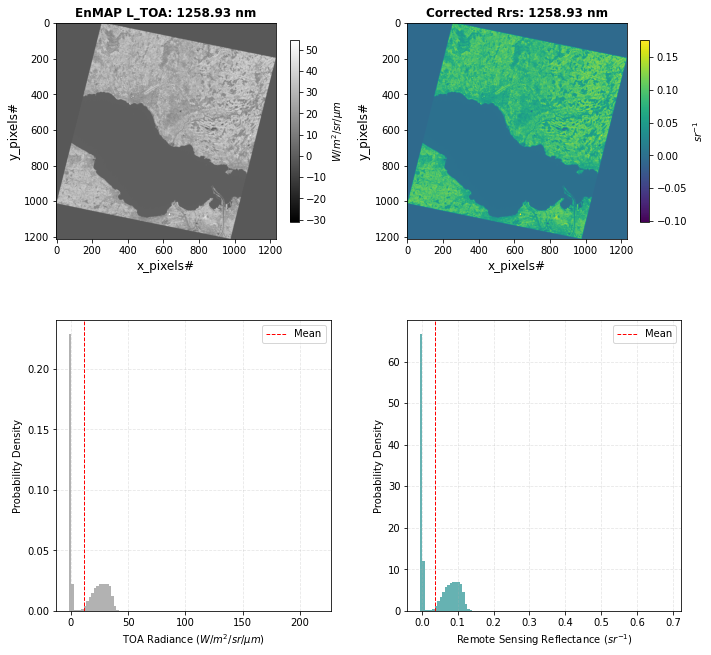

Processing band # 125
Band ID  125.0
Band wavelength center 1270.92
Band Gain  3.40207512154e-06
Band Offset  -0.00126948645371
6S params for band 125: {'spherical_albedo': 0.00688, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99715, 'total_gaseous_transmittance': 0.93266, 'total_scattering_transmittance_upward': 0.99534, 'total_scattering_transmittance_downward': 0.9932, 'atmospheric_intrinsic_radiance': 0.163, 'direct_solar_irradiance': 289.098, 'diffuse_solar_irradiance': 3.652}
Performing 6ABOS atmospheric correction on EnMAP band: 1270.92 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


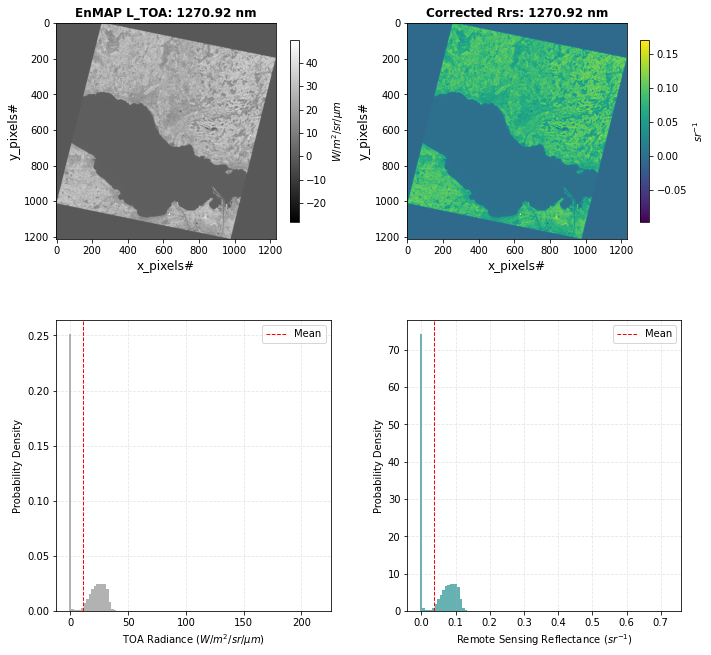

Processing band # 126
Band ID  126.0
Band wavelength center 1282.92
Band Gain  3.38619758799e-06
Band Offset  -0.00179737121982
6S params for band 126: {'spherical_albedo': 0.0067, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98749, 'total_gaseous_transmittance': 0.98165, 'total_scattering_transmittance_upward': 0.99541, 'total_scattering_transmittance_downward': 0.99332, 'atmospheric_intrinsic_radiance': 0.161, 'direct_solar_irradiance': 288.592, 'diffuse_solar_irradiance': 3.574}
Performing 6ABOS atmospheric correction on EnMAP band: 1282.92 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


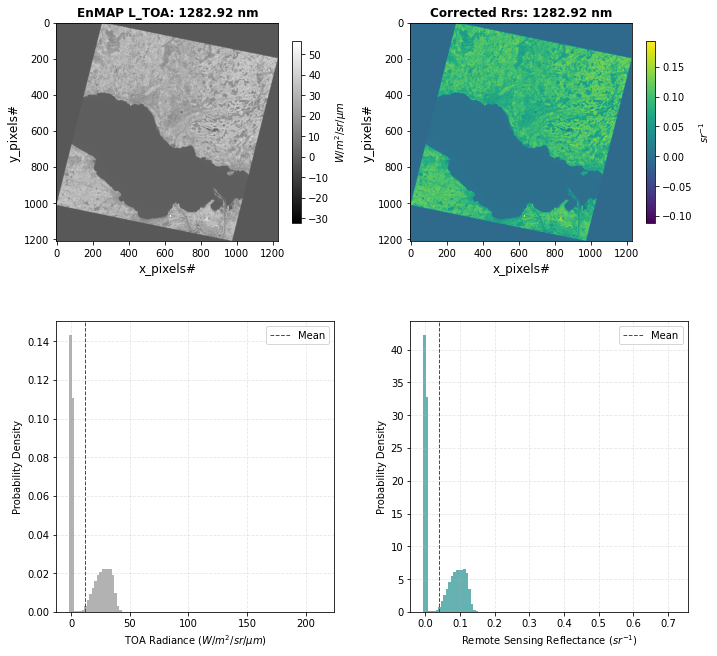

Processing band # 127
Band ID  127.0
Band wavelength center 1294.91
Band Gain  3.30747910137e-06
Band Offset  -0.00171633088369
6S params for band 127: {'spherical_albedo': 0.00652, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.94207, 'total_gaseous_transmittance': 0.94147, 'total_scattering_transmittance_upward': 0.99549, 'total_scattering_transmittance_downward': 0.99343, 'atmospheric_intrinsic_radiance': 0.152, 'direct_solar_irradiance': 274.935, 'diffuse_solar_irradiance': 3.339}
Performing 6ABOS atmospheric correction on EnMAP band: 1294.91 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


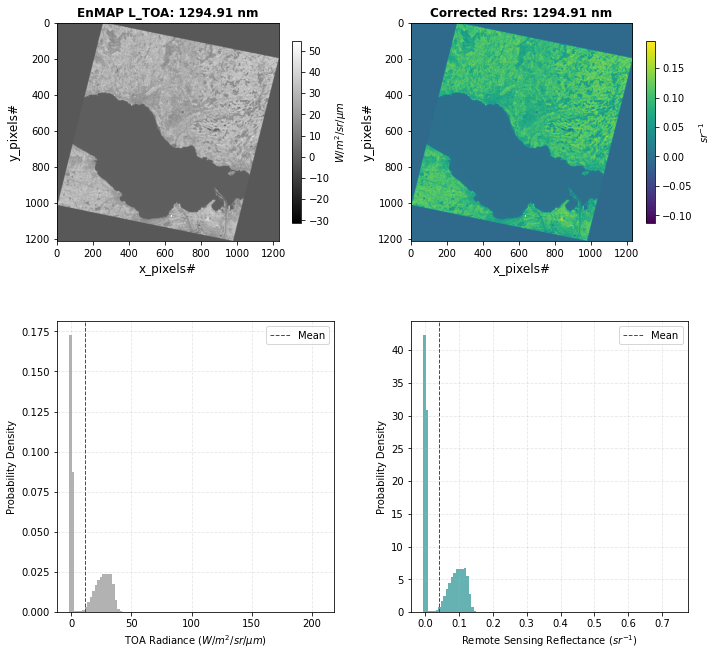

Processing band # 128
Band ID  128.0
Band wavelength center 1306.9
Band Gain  3.29693955512e-06
Band Offset  -0.00150537019306
6S params for band 128: {'spherical_albedo': 0.00635, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.82925, 'total_gaseous_transmittance': 0.82869, 'total_scattering_transmittance_upward': 0.99556, 'total_scattering_transmittance_downward': 0.99354, 'atmospheric_intrinsic_radiance': 0.147, 'direct_solar_irradiance': 256.349, 'diffuse_solar_irradiance': 3.055}
Performing 6ABOS atmospheric correction on EnMAP band: 1306.9 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


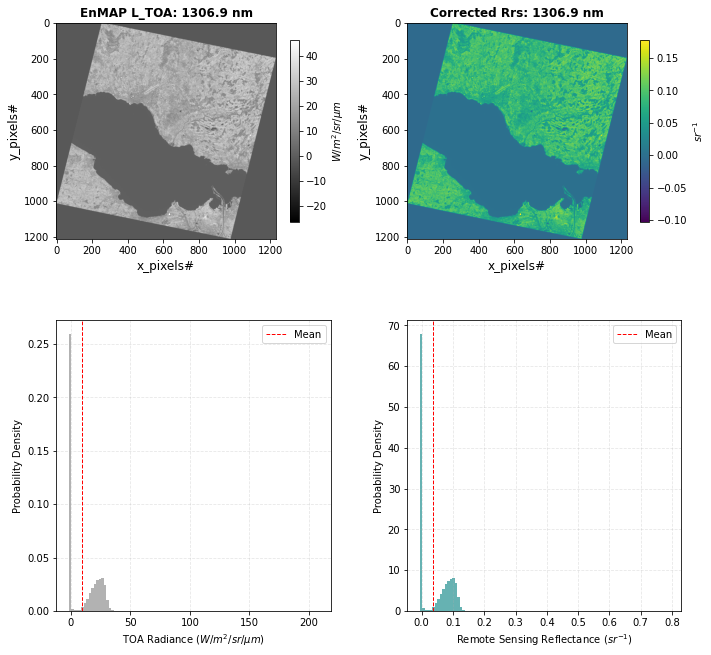

Processing band # 129
Band ID  129.0
Band wavelength center 1318.88
Band Gain  3.0322062175e-06
Band Offset  -0.00121005466826
6S params for band 129: {'spherical_albedo': 0.00619, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.76745, 'total_gaseous_transmittance': 0.76608, 'total_scattering_transmittance_upward': 0.99564, 'total_scattering_transmittance_downward': 0.99365, 'atmospheric_intrinsic_radiance': 0.138, 'direct_solar_irradiance': 238.361, 'diffuse_solar_irradiance': 2.788}
Performing 6ABOS atmospheric correction on EnMAP band: 1318.88 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


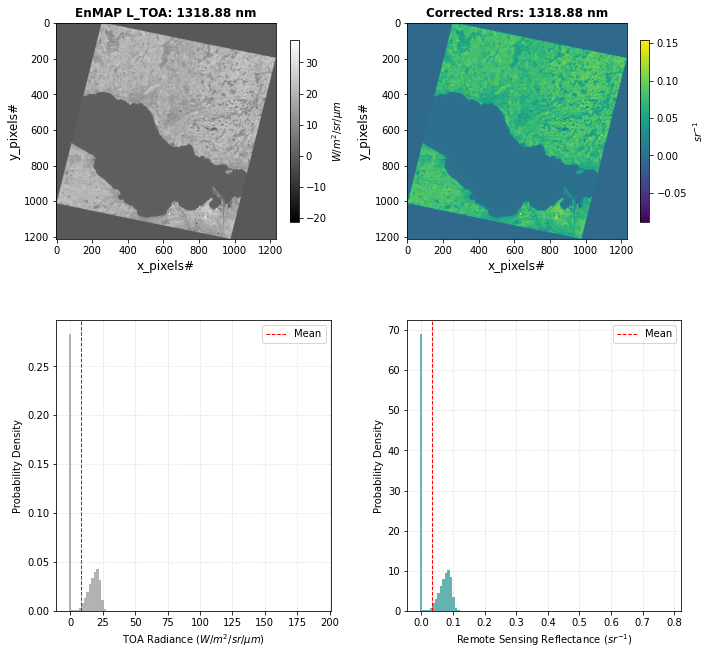

Processing band # 130
Band ID  130.0
Band wavelength center 1330.86
Band Gain  3.05719671132e-06
Band Offset  -0.000778332774037
6S params for band 130: {'spherical_albedo': 0.00603, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.64803, 'total_gaseous_transmittance': 0.64781, 'total_scattering_transmittance_upward': 0.99571, 'total_scattering_transmittance_downward': 0.99375, 'atmospheric_intrinsic_radiance': 0.127, 'direct_solar_irradiance': 206.642, 'diffuse_solar_irradiance': 2.374}
Performing 6ABOS atmospheric correction on EnMAP band: 1330.86 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 1330.86 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 131
Band ID  131.0
Band wavelength center 1342.82
Band Gain  2.75640399156e-06
Band Offset  -0.000416383825941
6S params for band 131: {'spherical_albedo': 0.00588, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.38584, 'total_gase

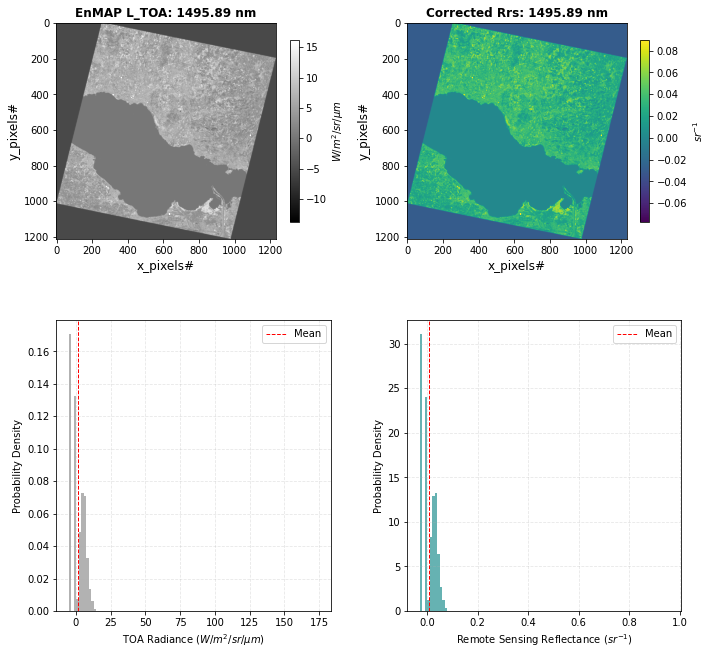

Processing band # 141
Band ID  141.0
Band wavelength center 1507.4
Band Gain  2.80998191315e-06
Band Offset  -0.00561002846351
6S params for band 141: {'spherical_albedo': 0.00423, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9168, 'total_gaseous_transmittance': 0.91674, 'total_scattering_transmittance_upward': 0.99672, 'total_scattering_transmittance_downward': 0.99524, 'atmospheric_intrinsic_radiance': 0.067, 'direct_solar_irradiance': 200.623, 'diffuse_solar_irradiance': 1.852}
Performing 6ABOS atmospheric correction on EnMAP band: 1507.4 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


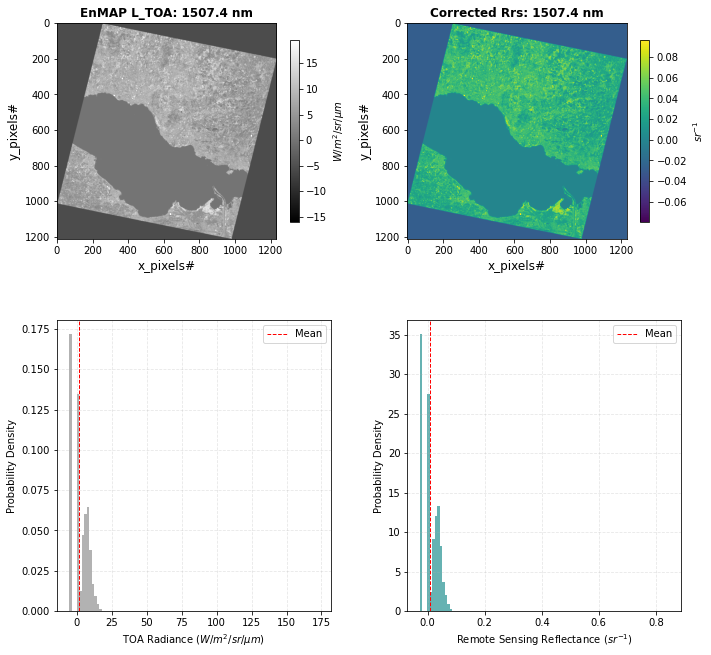

Processing band # 142
Band ID  142.0
Band wavelength center 1518.87
Band Gain  2.70694757099e-06
Band Offset  -0.00419572513813
6S params for band 142: {'spherical_albedo': 0.00414, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.94013, 'total_gaseous_transmittance': 0.93975, 'total_scattering_transmittance_upward': 0.99678, 'total_scattering_transmittance_downward': 0.99533, 'atmospheric_intrinsic_radiance': 0.064, 'direct_solar_irradiance': 200.806, 'diffuse_solar_irradiance': 1.833}
Performing 6ABOS atmospheric correction on EnMAP band: 1518.87 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


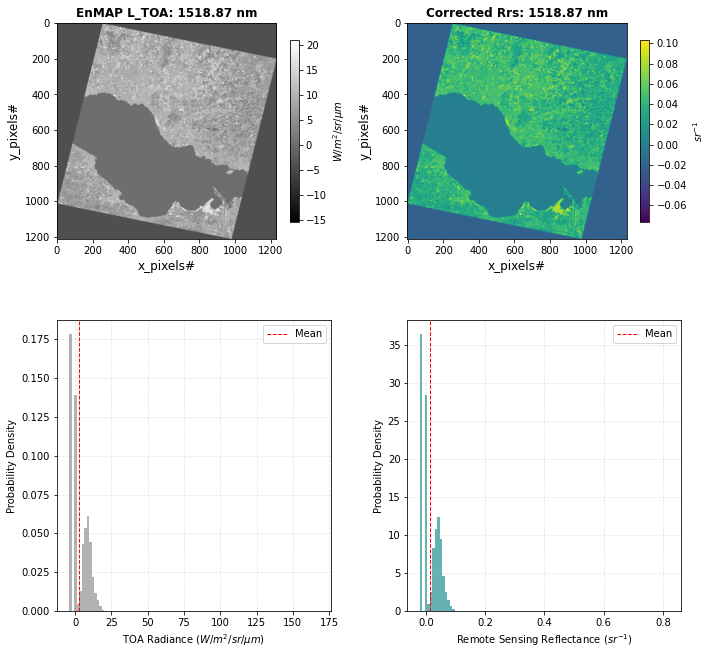

Processing band # 143
Band ID  143.0
Band wavelength center 1530.29
Band Gain  2.76705359002e-06
Band Offset  -0.00299858683829
6S params for band 143: {'spherical_albedo': 0.00406, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97353, 'total_gaseous_transmittance': 0.96494, 'total_scattering_transmittance_upward': 0.99684, 'total_scattering_transmittance_downward': 0.99542, 'atmospheric_intrinsic_radiance': 0.062, 'direct_solar_irradiance': 200.549, 'diffuse_solar_irradiance': 1.812}
Performing 6ABOS atmospheric correction on EnMAP band: 1530.29 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


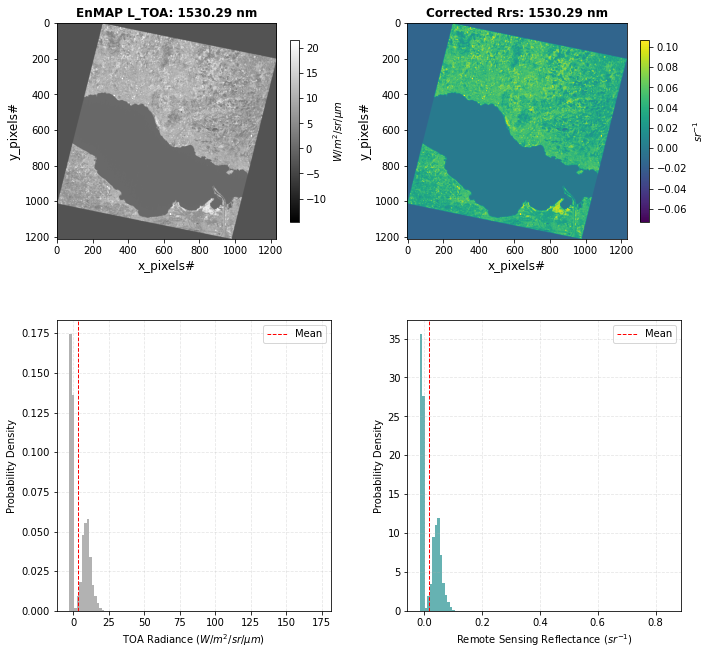

Processing band # 144
Band ID  144.0
Band wavelength center 1541.68
Band Gain  2.81136961704e-06
Band Offset  -0.00240336189525
6S params for band 144: {'spherical_albedo': 0.00399, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99195, 'total_gaseous_transmittance': 0.98196, 'total_scattering_transmittance_upward': 0.99689, 'total_scattering_transmittance_downward': 0.9955, 'atmospheric_intrinsic_radiance': 0.059, 'direct_solar_irradiance': 198.952, 'diffuse_solar_irradiance': 1.781}
Performing 6ABOS atmospheric correction on EnMAP band: 1541.68 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


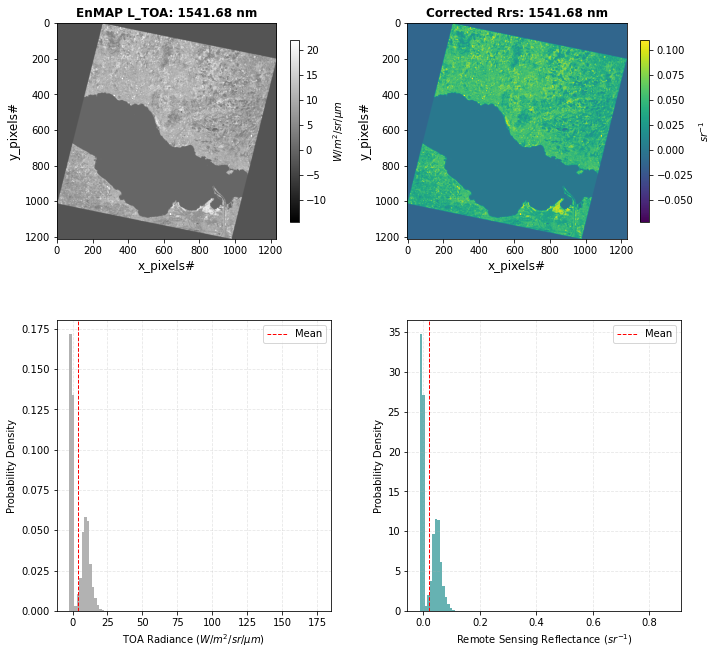

Processing band # 145
Band ID  145.0
Band wavelength center 1553.01
Band Gain  2.78237586012e-06
Band Offset  -0.00186544009795
6S params for band 145: {'spherical_albedo': 0.00392, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9967, 'total_gaseous_transmittance': 0.99606, 'total_scattering_transmittance_upward': 0.99694, 'total_scattering_transmittance_downward': 0.99556, 'atmospheric_intrinsic_radiance': 0.058, 'direct_solar_irradiance': 196.913, 'diffuse_solar_irradiance': 1.749}
Performing 6ABOS atmospheric correction on EnMAP band: 1553.01 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


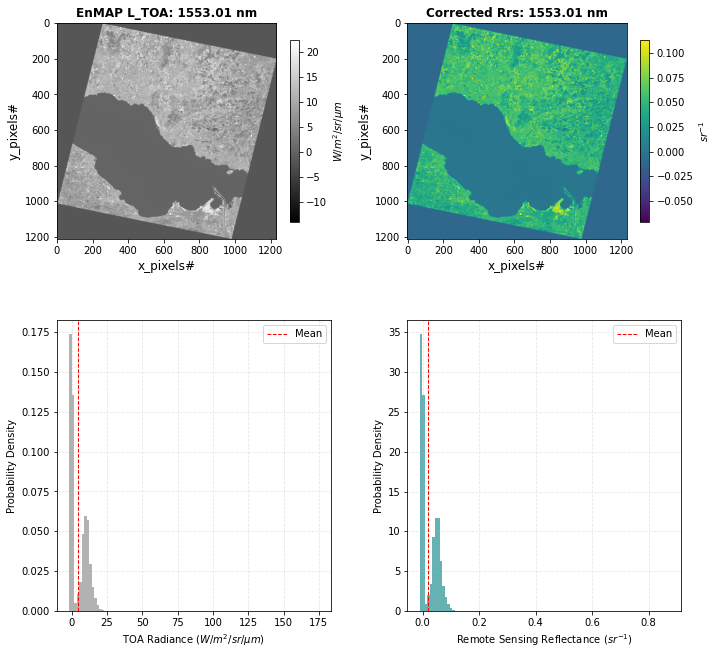

Processing band # 146
Band ID  146.0
Band wavelength center 1564.31
Band Gain  2.83318815129e-06
Band Offset  -0.00937423865554
6S params for band 146: {'spherical_albedo': 0.00387, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99805, 'total_gaseous_transmittance': 0.96968, 'total_scattering_transmittance_upward': 0.99698, 'total_scattering_transmittance_downward': 0.99562, 'atmospheric_intrinsic_radiance': 0.054, 'direct_solar_irradiance': 189.826, 'diffuse_solar_irradiance': 1.674}
Performing 6ABOS atmospheric correction on EnMAP band: 1564.31 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


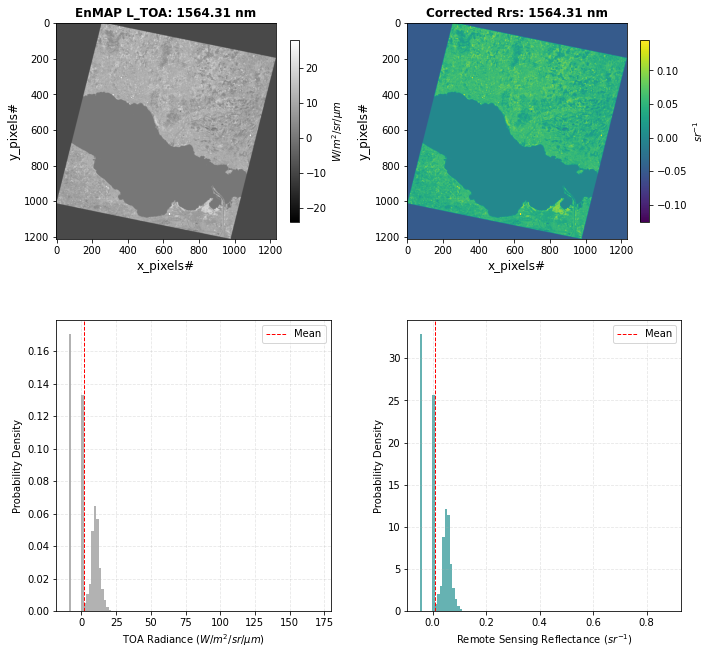

Processing band # 147
Band ID  147.0
Band wavelength center 1575.55
Band Gain  2.7181901781e-06
Band Offset  -0.00300863258027
6S params for band 147: {'spherical_albedo': 0.00381, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99862, 'total_gaseous_transmittance': 0.92946, 'total_scattering_transmittance_upward': 0.99702, 'total_scattering_transmittance_downward': 0.99569, 'atmospheric_intrinsic_radiance': 0.05, 'direct_solar_irradiance': 181.039, 'diffuse_solar_irradiance': 1.585}
Performing 6ABOS atmospheric correction on EnMAP band: 1575.55 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


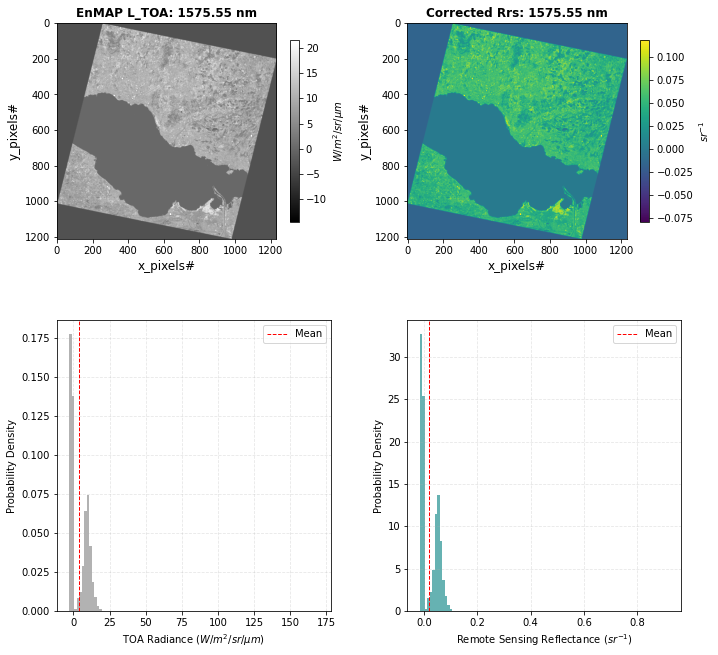

Processing band # 148
Band ID  148.0
Band wavelength center 1586.76
Band Gain  2.58245554763e-06
Band Offset  -0.00182255568498
6S params for band 148: {'spherical_albedo': 0.00375, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99788, 'total_gaseous_transmittance': 0.988, 'total_scattering_transmittance_upward': 0.99707, 'total_scattering_transmittance_downward': 0.99575, 'atmospheric_intrinsic_radiance': 0.051, 'direct_solar_irradiance': 184.78, 'diffuse_solar_irradiance': 1.607}
Performing 6ABOS atmospheric correction on EnMAP band: 1586.76 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


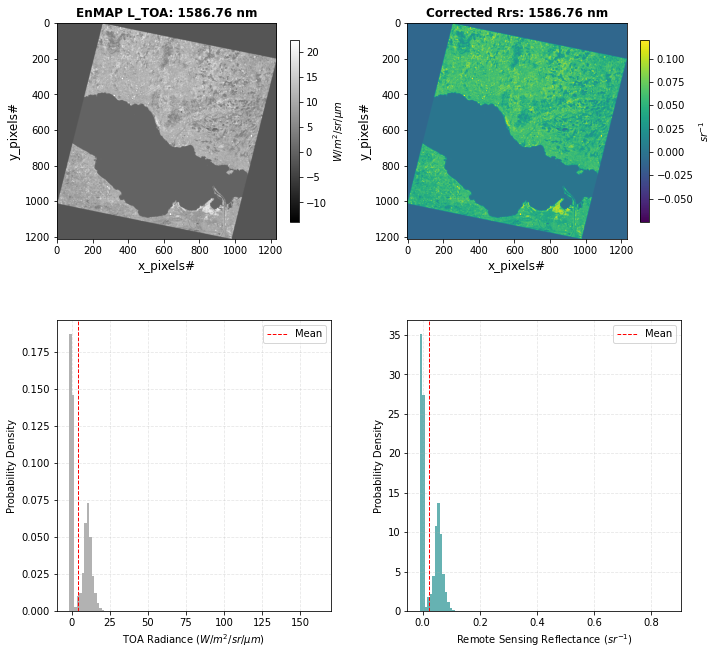

Processing band # 149
Band ID  149.0
Band wavelength center 1597.91
Band Gain  2.73116929096e-06
Band Offset  -0.00598185795424
6S params for band 149: {'spherical_albedo': 0.0037, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99927, 'total_gaseous_transmittance': 0.96297, 'total_scattering_transmittance_upward': 0.99711, 'total_scattering_transmittance_downward': 0.99581, 'atmospheric_intrinsic_radiance': 0.048, 'direct_solar_irradiance': 178.153, 'diffuse_solar_irradiance': 1.539}
Performing 6ABOS atmospheric correction on EnMAP band: 1597.91 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


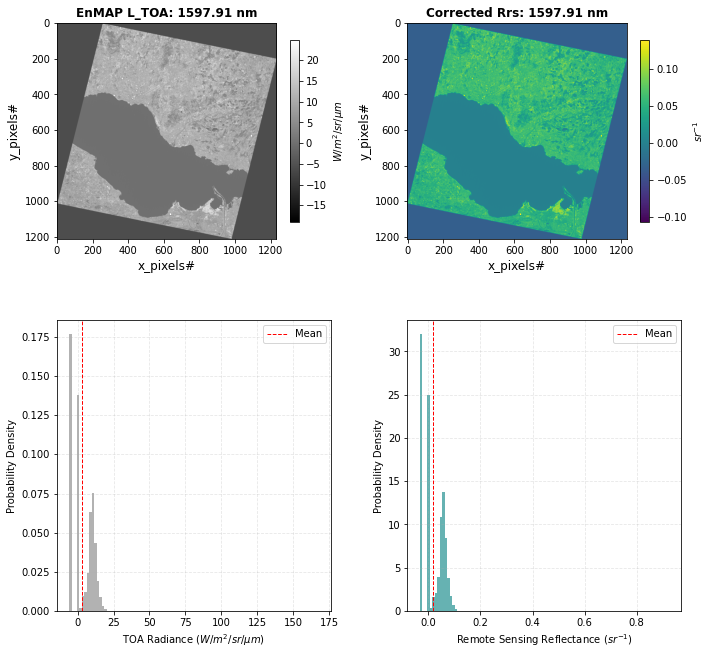

Processing band # 150
Band ID  150.0
Band wavelength center 1609.02
Band Gain  2.59451035829e-06
Band Offset  -0.00201849041906
6S params for band 150: {'spherical_albedo': 0.00365, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99923, 'total_gaseous_transmittance': 0.93552, 'total_scattering_transmittance_upward': 0.99715, 'total_scattering_transmittance_downward': 0.99587, 'atmospheric_intrinsic_radiance': 0.044, 'direct_solar_irradiance': 171.529, 'diffuse_solar_irradiance': 1.473}
Performing 6ABOS atmospheric correction on EnMAP band: 1609.02 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


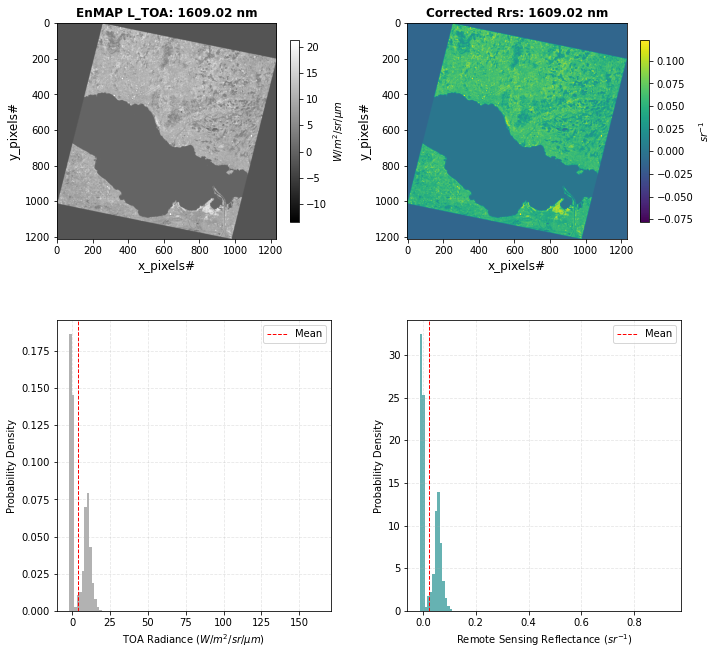

Processing band # 151
Band ID  151.0
Band wavelength center 1620.09
Band Gain  2.6291401985e-06
Band Offset  -0.00131872414406
6S params for band 151: {'spherical_albedo': 0.00359, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99934, 'total_gaseous_transmittance': 0.98747, 'total_scattering_transmittance_upward': 0.99719, 'total_scattering_transmittance_downward': 0.99593, 'atmospheric_intrinsic_radiance': 0.045, 'direct_solar_irradiance': 174.246, 'diffuse_solar_irradiance': 1.487}
Performing 6ABOS atmospheric correction on EnMAP band: 1620.09 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


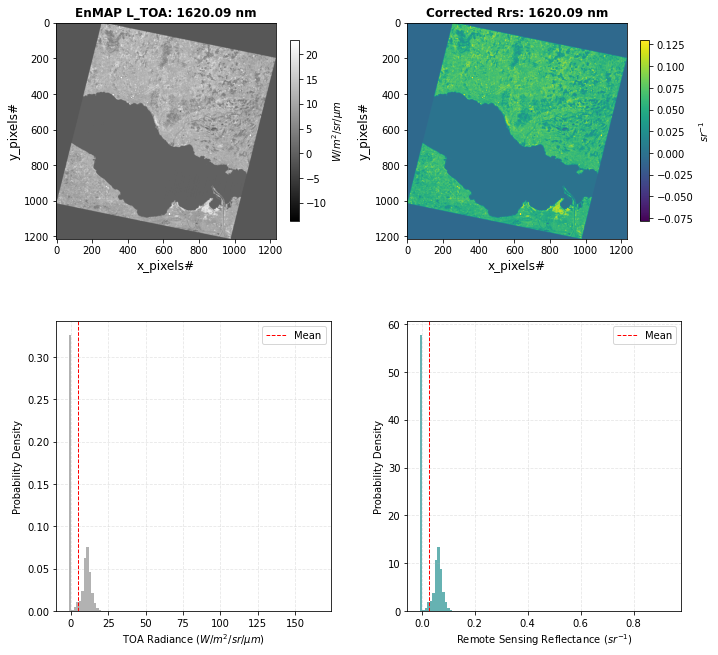

Processing band # 152
Band ID  152.0
Band wavelength center 1631.11
Band Gain  2.57368320352e-06
Band Offset  -0.000992257703373
6S params for band 152: {'spherical_albedo': 0.00354, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99913, 'total_gaseous_transmittance': 0.98584, 'total_scattering_transmittance_upward': 0.99723, 'total_scattering_transmittance_downward': 0.99599, 'atmospheric_intrinsic_radiance': 0.043, 'direct_solar_irradiance': 170.555, 'diffuse_solar_irradiance': 1.447}
Performing 6ABOS atmospheric correction on EnMAP band: 1631.11 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


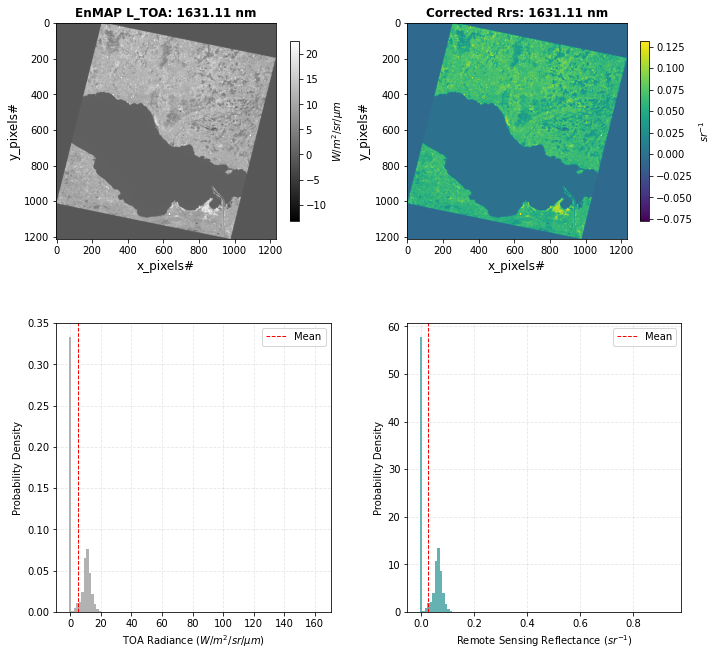

Processing band # 153
Band ID  153.0
Band wavelength center 1642.08
Band Gain  2.59103552774e-06
Band Offset  -0.00142288857905
6S params for band 153: {'spherical_albedo': 0.00349, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99855, 'total_gaseous_transmittance': 0.96038, 'total_scattering_transmittance_upward': 0.99727, 'total_scattering_transmittance_downward': 0.99605, 'atmospheric_intrinsic_radiance': 0.041, 'direct_solar_irradiance': 164.319, 'diffuse_solar_irradiance': 1.386}
Performing 6ABOS atmospheric correction on EnMAP band: 1642.08 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


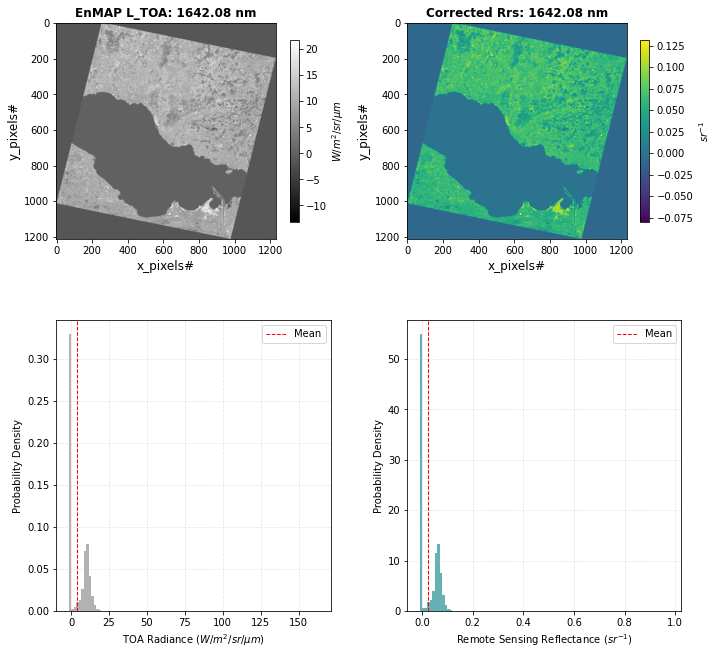

Processing band # 154
Band ID  154.0
Band wavelength center 1653.0
Band Gain  2.58498515696e-06
Band Offset  -0.00118303762905
6S params for band 154: {'spherical_albedo': 0.00343, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99835, 'total_gaseous_transmittance': 0.96425, 'total_scattering_transmittance_upward': 0.99729, 'total_scattering_transmittance_downward': 0.99607, 'atmospheric_intrinsic_radiance': 0.039, 'direct_solar_irradiance': 161.251, 'diffuse_solar_irradiance': 1.35}
Performing 6ABOS atmospheric correction on EnMAP band: 1653.0 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


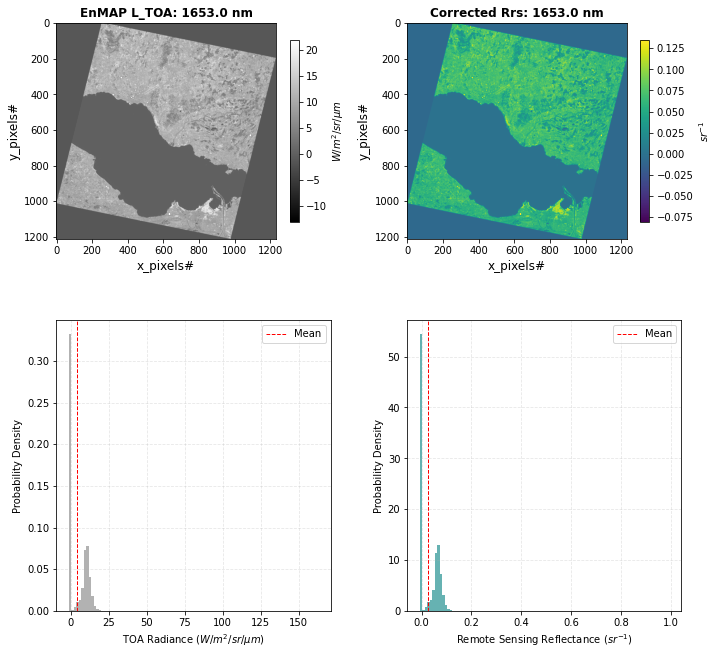

Processing band # 155
Band ID  155.0
Band wavelength center 1663.87
Band Gain  2.55833137394e-06
Band Offset  -0.00109945969879
6S params for band 155: {'spherical_albedo': 0.00334, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99637, 'total_gaseous_transmittance': 0.96073, 'total_scattering_transmittance_upward': 0.99726, 'total_scattering_transmittance_downward': 0.99604, 'atmospheric_intrinsic_radiance': 0.037, 'direct_solar_irradiance': 157.381, 'diffuse_solar_irradiance': 1.306}
Performing 6ABOS atmospheric correction on EnMAP band: 1663.87 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


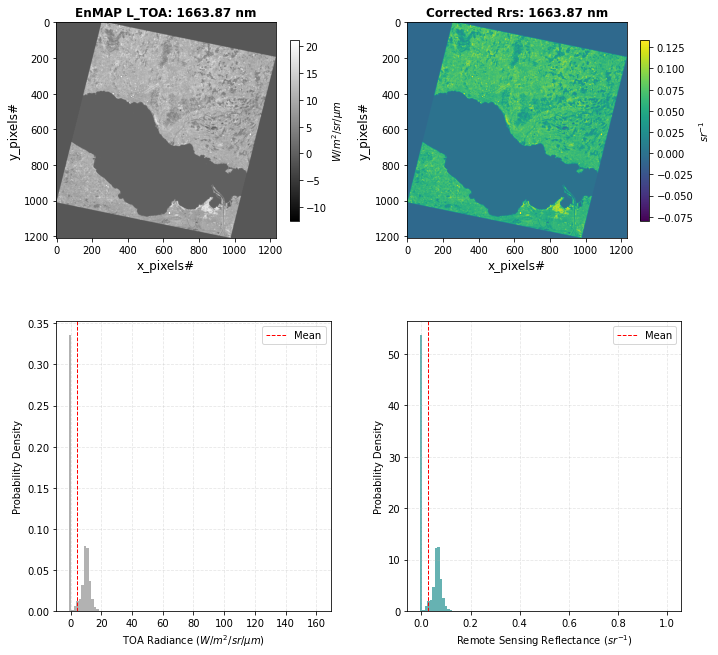

Processing band # 156
Band ID  156.0
Band wavelength center 1674.7
Band Gain  2.55690683439e-06
Band Offset  -0.00125022938737
6S params for band 156: {'spherical_albedo': 0.00325, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99446, 'total_gaseous_transmittance': 0.98103, 'total_scattering_transmittance_upward': 0.99724, 'total_scattering_transmittance_downward': 0.996, 'atmospheric_intrinsic_radiance': 0.037, 'direct_solar_irradiance': 155.971, 'diffuse_solar_irradiance': 1.282}
Performing 6ABOS atmospheric correction on EnMAP band: 1674.7 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


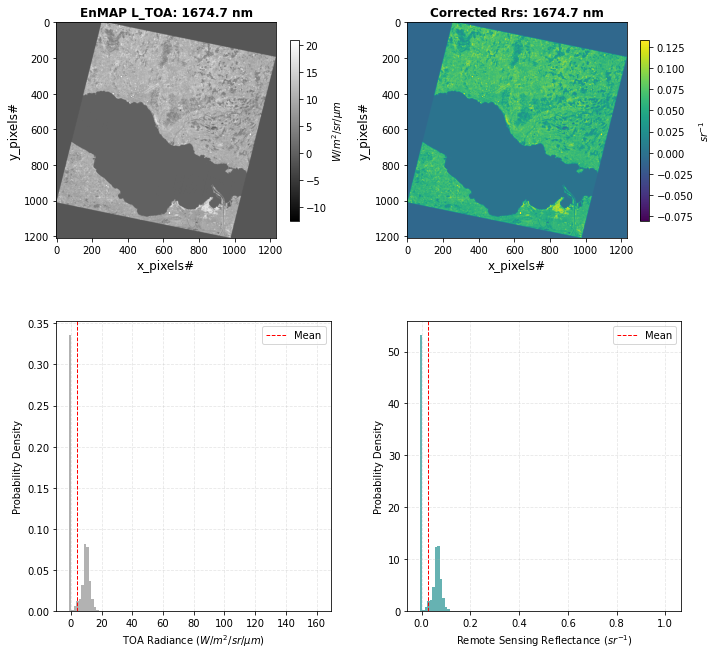

Processing band # 157
Band ID  157.0
Band wavelength center 1685.47
Band Gain  2.54095562952e-06
Band Offset  -0.001352142501
6S params for band 157: {'spherical_albedo': 0.00317, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98729, 'total_gaseous_transmittance': 0.97232, 'total_scattering_transmittance_upward': 0.99721, 'total_scattering_transmittance_downward': 0.99597, 'atmospheric_intrinsic_radiance': 0.035, 'direct_solar_irradiance': 151.674, 'diffuse_solar_irradiance': 1.235}
Performing 6ABOS atmospheric correction on EnMAP band: 1685.47 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


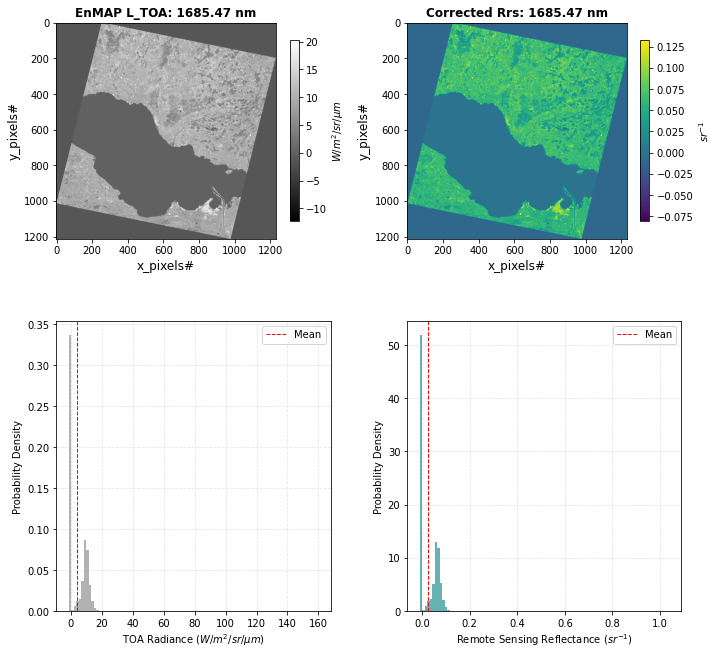

Processing band # 158
Band ID  158.0
Band wavelength center 1696.2
Band Gain  2.54587591864e-06
Band Offset  -0.00129241495249
6S params for band 158: {'spherical_albedo': 0.00308, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97237, 'total_gaseous_transmittance': 0.95913, 'total_scattering_transmittance_upward': 0.99718, 'total_scattering_transmittance_downward': 0.99594, 'atmospheric_intrinsic_radiance': 0.034, 'direct_solar_irradiance': 147.327, 'diffuse_solar_irradiance': 1.189}
Performing 6ABOS atmospheric correction on EnMAP band: 1696.2 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


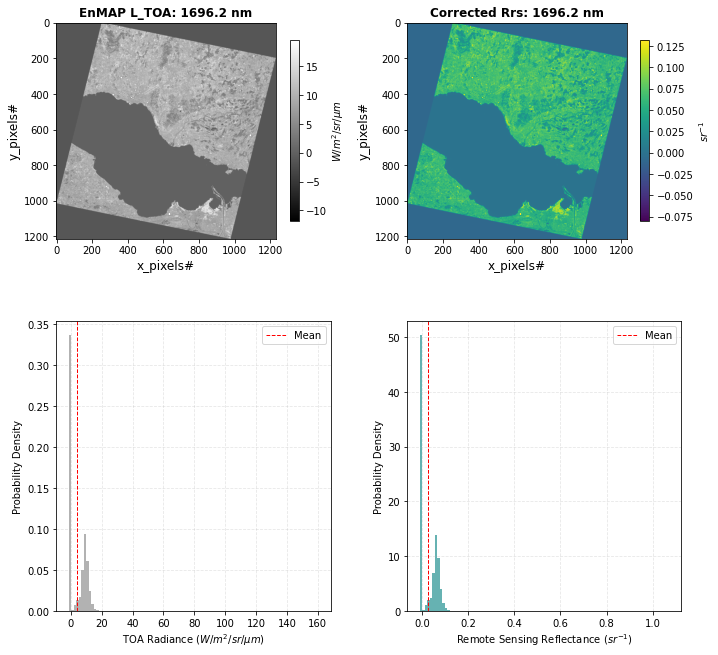

Processing band # 159
Band ID  159.0
Band wavelength center 1706.87
Band Gain  2.56493587127e-06
Band Offset  -0.0012420946303
6S params for band 159: {'spherical_albedo': 0.003, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.96118, 'total_gaseous_transmittance': 0.94435, 'total_scattering_transmittance_upward': 0.99715, 'total_scattering_transmittance_downward': 0.99591, 'atmospheric_intrinsic_radiance': 0.032, 'direct_solar_irradiance': 143.32, 'diffuse_solar_irradiance': 1.146}
Performing 6ABOS atmospheric correction on EnMAP band: 1706.87 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


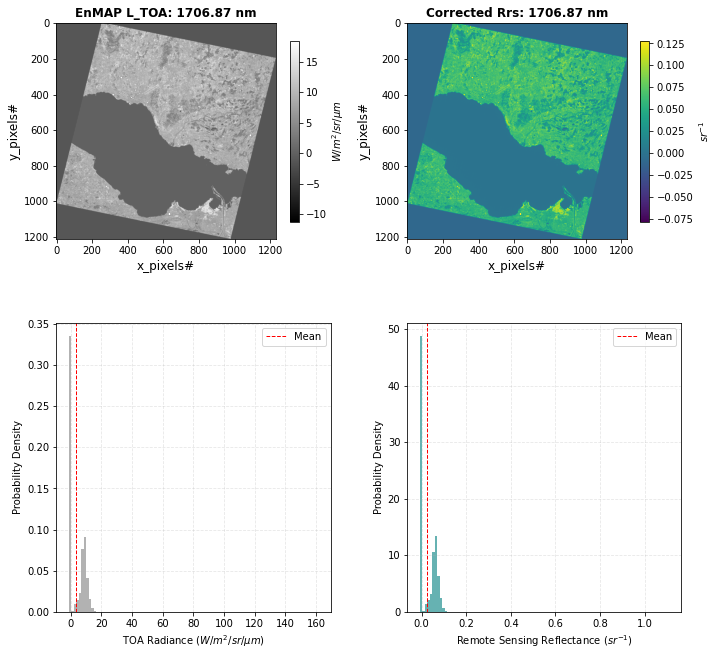

Processing band # 160
Band ID  160.0
Band wavelength center 1717.5
Band Gain  2.56637837389e-06
Band Offset  -0.00118776154965
6S params for band 160: {'spherical_albedo': 0.00293, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.94748, 'total_gaseous_transmittance': 0.93726, 'total_scattering_transmittance_upward': 0.99713, 'total_scattering_transmittance_downward': 0.99587, 'atmospheric_intrinsic_radiance': 0.031, 'direct_solar_irradiance': 139.317, 'diffuse_solar_irradiance': 1.105}
Performing 6ABOS atmospheric correction on EnMAP band: 1717.5 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


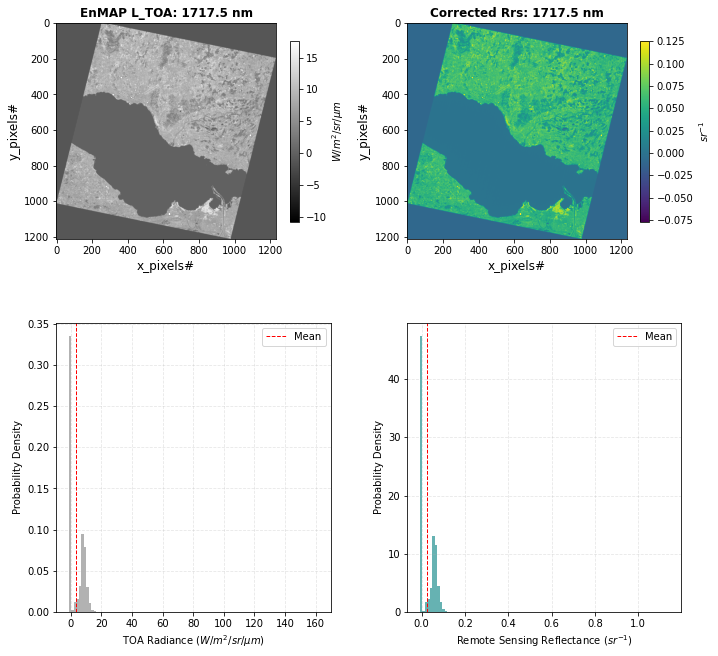

Processing band # 161
Band ID  161.0
Band wavelength center 1728.08
Band Gain  2.54970500819e-06
Band Offset  -0.00136953904285
6S params for band 161: {'spherical_albedo': 0.00286, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.92614, 'total_gaseous_transmittance': 0.9117, 'total_scattering_transmittance_upward': 0.9971, 'total_scattering_transmittance_downward': 0.99584, 'atmospheric_intrinsic_radiance': 0.029, 'direct_solar_irradiance': 133.789, 'diffuse_solar_irradiance': 1.052}
Performing 6ABOS atmospheric correction on EnMAP band: 1728.08 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


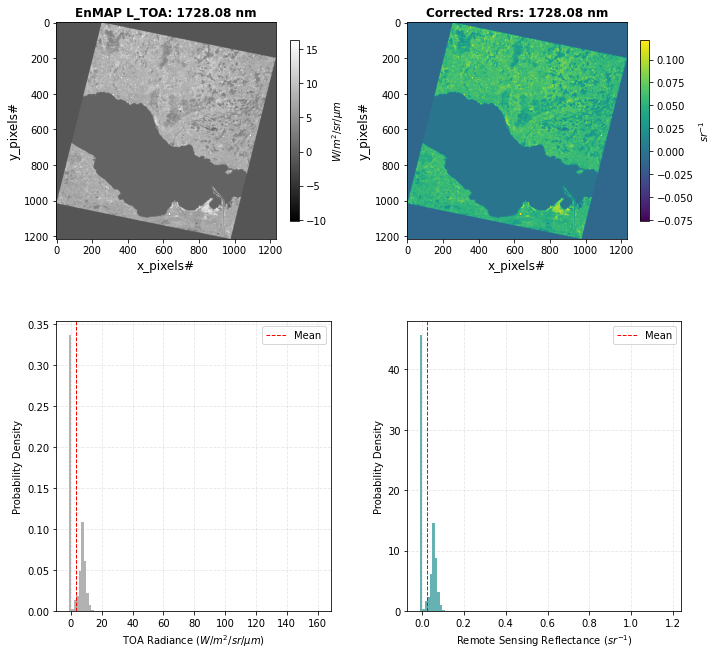

Processing band # 162
Band ID  162.0
Band wavelength center 1738.6
Band Gain  2.51594262502e-06
Band Offset  -0.0013697965516
6S params for band 162: {'spherical_albedo': 0.00278, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.89029, 'total_gaseous_transmittance': 0.88379, 'total_scattering_transmittance_upward': 0.99708, 'total_scattering_transmittance_downward': 0.99581, 'atmospheric_intrinsic_radiance': 0.028, 'direct_solar_irradiance': 127.574, 'diffuse_solar_irradiance': 0.994}
Performing 6ABOS atmospheric correction on EnMAP band: 1738.6 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


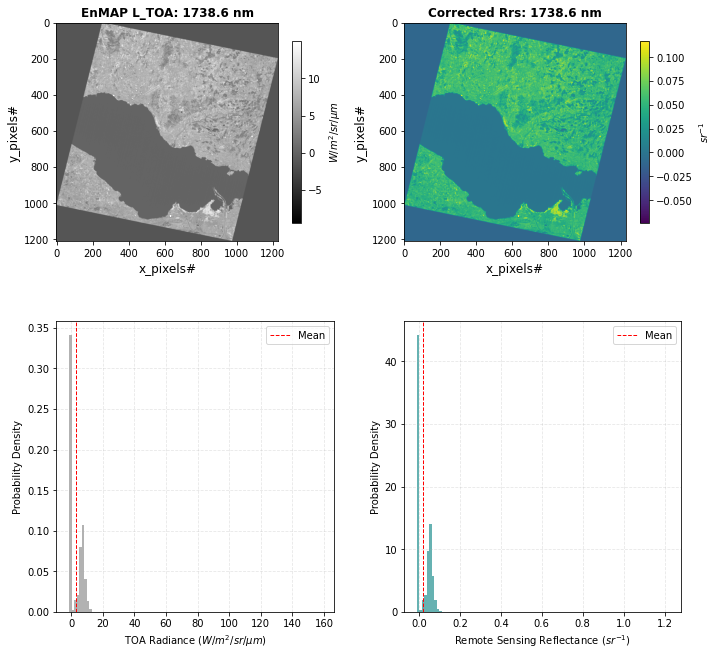

Processing band # 163
Band ID  163.0
Band wavelength center 1749.08
Band Gain  2.55787161034e-06
Band Offset  -0.00150433310189
6S params for band 163: {'spherical_albedo': 0.00272, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.87475, 'total_gaseous_transmittance': 0.87184, 'total_scattering_transmittance_upward': 0.99705, 'total_scattering_transmittance_downward': 0.99578, 'atmospheric_intrinsic_radiance': 0.027, 'direct_solar_irradiance': 123.005, 'diffuse_solar_irradiance': 0.95}
Performing 6ABOS atmospheric correction on EnMAP band: 1749.08 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


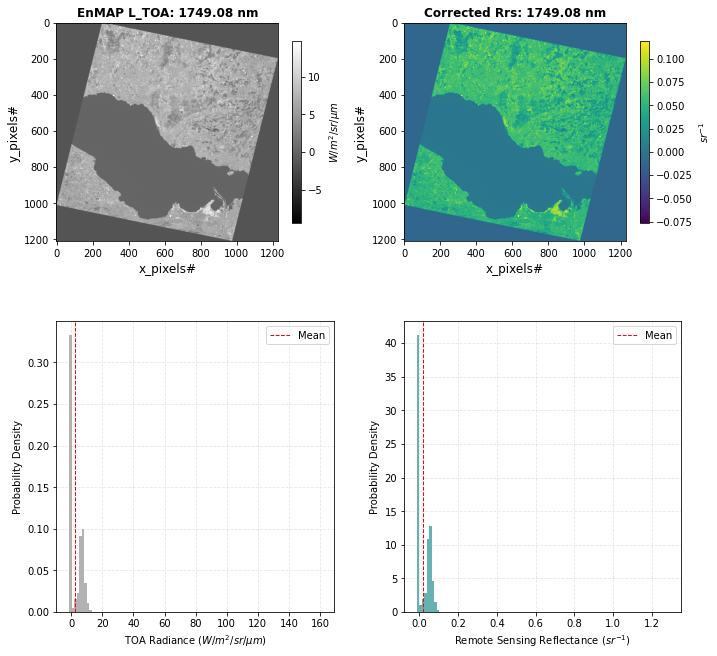

Processing band # 164
Band ID  164.0
Band wavelength center 1759.51
Band Gain  2.52390140129e-06
Band Offset  -0.0016111872564
6S params for band 164: {'spherical_albedo': 0.00265, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.85567, 'total_gaseous_transmittance': 0.85299, 'total_scattering_transmittance_upward': 0.99703, 'total_scattering_transmittance_downward': 0.99575, 'atmospheric_intrinsic_radiance': 0.026, 'direct_solar_irradiance': 118.194, 'diffuse_solar_irradiance': 0.906}
Performing 6ABOS atmospheric correction on EnMAP band: 1759.51 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


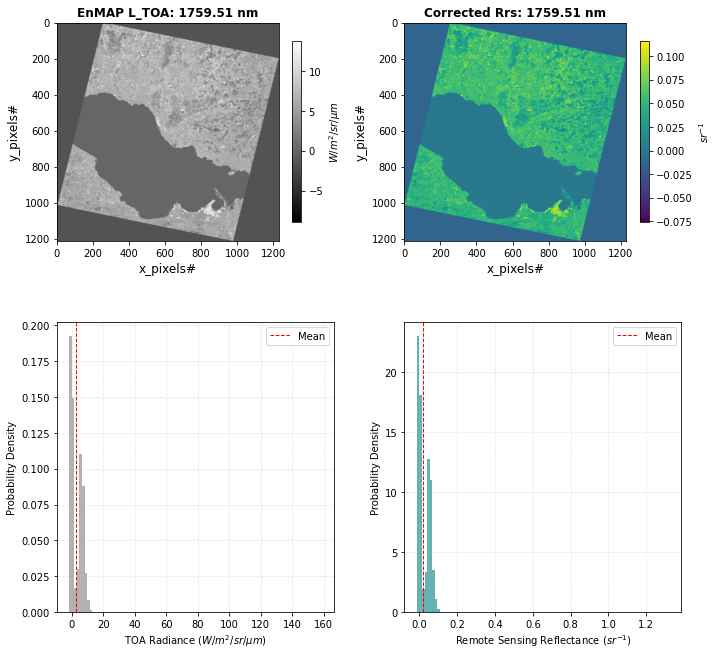

Processing band # 165
Band ID  165.0
Band wavelength center 1769.89
Band Gain  2.55342245386e-06
Band Offset  -0.00142581129119
6S params for band 165: {'spherical_albedo': 0.00259, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.77586, 'total_gaseous_transmittance': 0.76913, 'total_scattering_transmittance_upward': 0.997, 'total_scattering_transmittance_downward': 0.99572, 'atmospheric_intrinsic_radiance': 0.024, 'direct_solar_irradiance': 107.618, 'diffuse_solar_irradiance': 0.818}
Performing 6ABOS atmospheric correction on EnMAP band: 1769.89 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


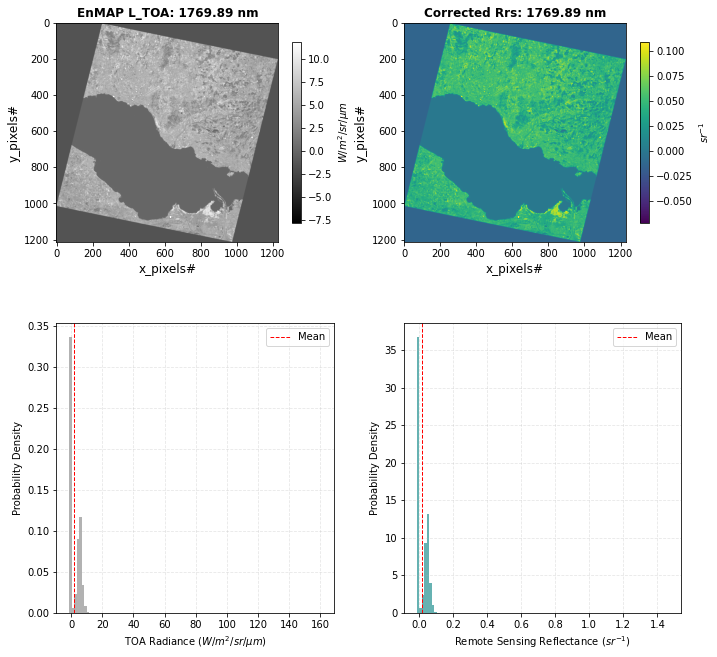

Processing band # 166
Band ID  166.0
Band wavelength center 1780.22
Band Gain  2.10903478316e-06
Band Offset  -0.00109672214264
6S params for band 166: {'spherical_albedo': 0.00253, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.61504, 'total_gaseous_transmittance': 0.6108, 'total_scattering_transmittance_upward': 0.99698, 'total_scattering_transmittance_downward': 0.99569, 'atmospheric_intrinsic_radiance': 0.021, 'direct_solar_irradiance': 87.777, 'diffuse_solar_irradiance': 0.662}
Performing 6ABOS atmospheric correction on EnMAP band: 1780.22 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 1780.22 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 167
Band ID  167.0
Band wavelength center 1967.66
Band Gain  7.30150133925e-07
Band Offset  -0.00137177958874
6S params for band 167: {'spherical_albedo': 0.00171, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.59575, 'total_gaseous_

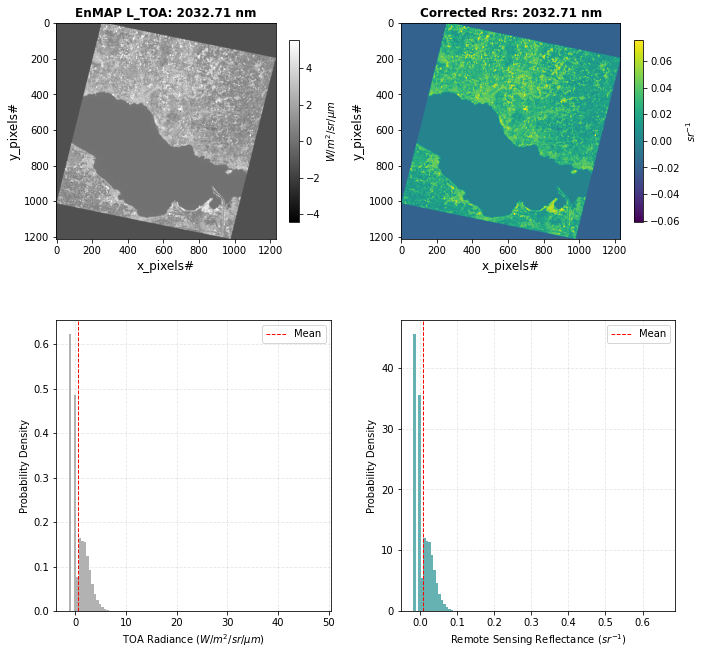

Processing band # 175
Band ID  175.0
Band wavelength center 2041.83
Band Gain  7.82327106701e-07
Band Offset  -0.00131064980974
6S params for band 175: {'spherical_albedo': 0.0016, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.95932, 'total_gaseous_transmittance': 0.89619, 'total_scattering_transmittance_upward': 0.99696, 'total_scattering_transmittance_downward': 0.99573, 'atmospheric_intrinsic_radiance': 0.009, 'direct_solar_irradiance': 73.263, 'diffuse_solar_irradiance': 0.461}
Performing 6ABOS atmospheric correction on EnMAP band: 2041.83 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


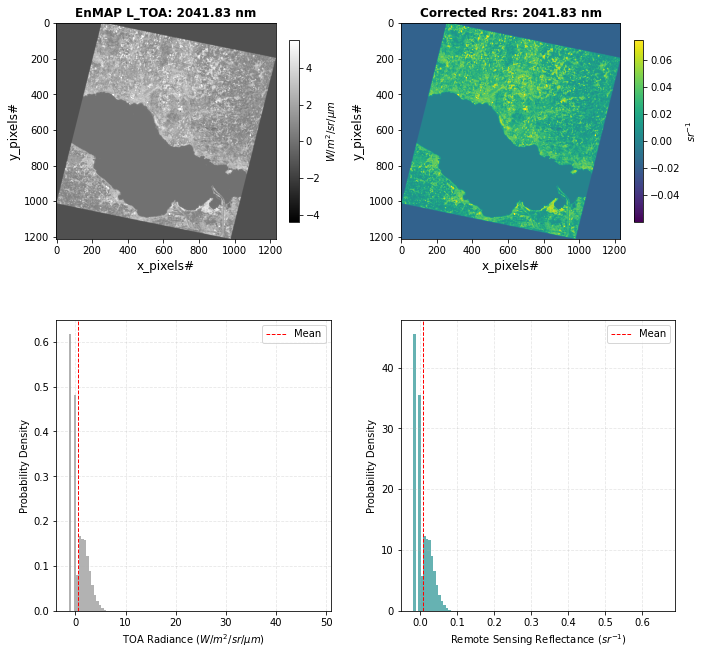

Processing band # 176
Band ID  176.0
Band wavelength center 2050.92
Band Gain  7.07848359025e-07
Band Offset  -0.00163653450682
6S params for band 176: {'spherical_albedo': 0.00158, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9657, 'total_gaseous_transmittance': 0.65777, 'total_scattering_transmittance_upward': 0.99699, 'total_scattering_transmittance_downward': 0.99578, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 57.135, 'diffuse_solar_irradiance': 0.358}
Performing 6ABOS atmospheric correction on EnMAP band: 2050.92 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 2050.92 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 177
Band ID  177.0
Band wavelength center 2059.96
Band Gain  7.30251034073e-07
Band Offset  -0.00173843614857
6S params for band 177: {'spherical_albedo': 0.00157, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.94912, 'total_gaseous_

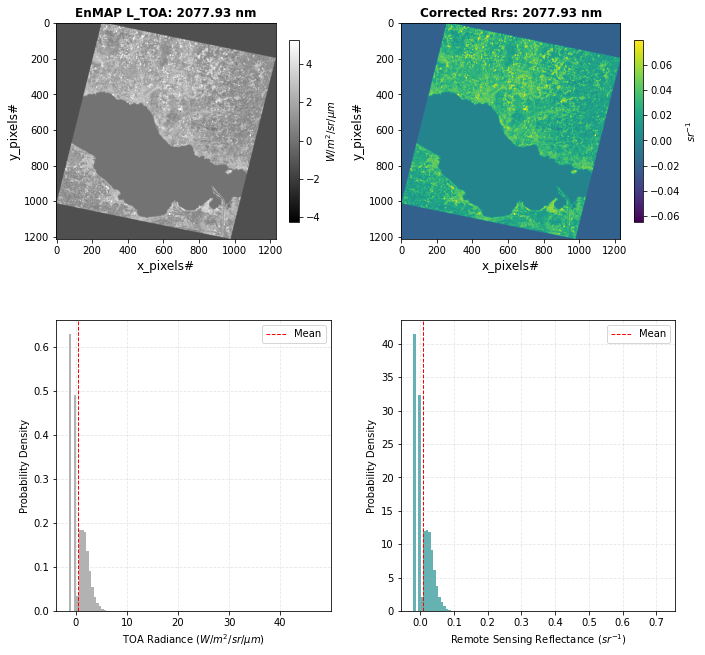

Processing band # 180
Band ID  180.0
Band wavelength center 2086.86
Band Gain  7.52845277289e-07
Band Offset  -0.000625948583671
6S params for band 180: {'spherical_albedo': 0.00153, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97122, 'total_gaseous_transmittance': 0.89638, 'total_scattering_transmittance_upward': 0.99713, 'total_scattering_transmittance_downward': 0.99597, 'atmospheric_intrinsic_radiance': 0.008, 'direct_solar_irradiance': 67.397, 'diffuse_solar_irradiance': 0.415}
Performing 6ABOS atmospheric correction on EnMAP band: 2086.86 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


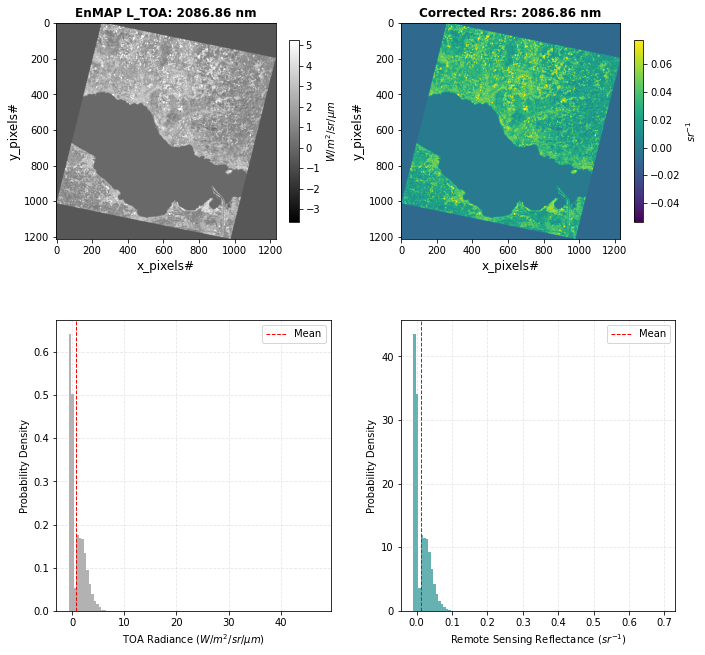

Processing band # 181
Band ID  181.0
Band wavelength center 2095.74
Band Gain  7.74631750872e-07
Band Offset  -0.00115970848548
6S params for band 181: {'spherical_albedo': 0.00152, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.95222, 'total_gaseous_transmittance': 0.93318, 'total_scattering_transmittance_upward': 0.99716, 'total_scattering_transmittance_downward': 0.99602, 'atmospheric_intrinsic_radiance': 0.008, 'direct_solar_irradiance': 68.165, 'diffuse_solar_irradiance': 0.418}
Performing 6ABOS atmospheric correction on EnMAP band: 2095.74 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


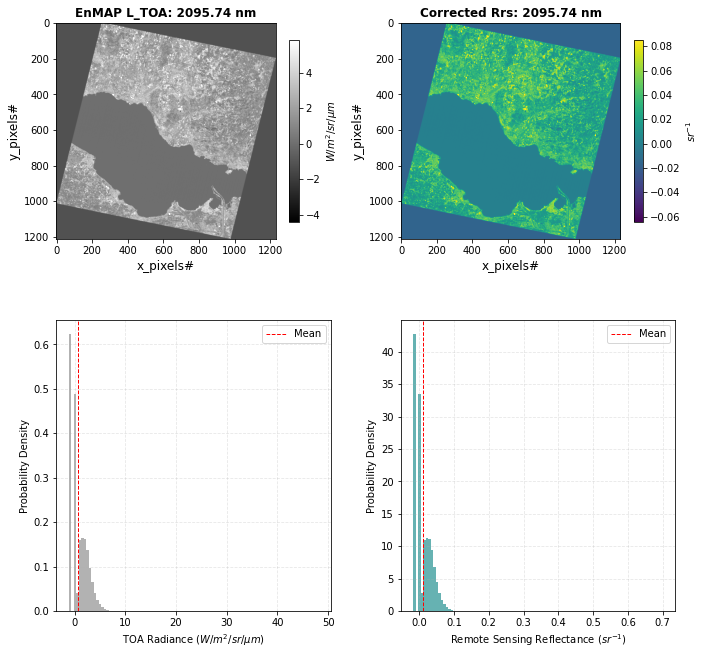

Processing band # 182
Band ID  182.0
Band wavelength center 2104.59
Band Gain  7.72838058894e-07
Band Offset  -0.000868167801338
6S params for band 182: {'spherical_albedo': 0.00151, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.96179, 'total_gaseous_transmittance': 0.95015, 'total_scattering_transmittance_upward': 0.9972, 'total_scattering_transmittance_downward': 0.99607, 'atmospheric_intrinsic_radiance': 0.008, 'direct_solar_irradiance': 68.574, 'diffuse_solar_irradiance': 0.418}
Performing 6ABOS atmospheric correction on EnMAP band: 2104.59 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


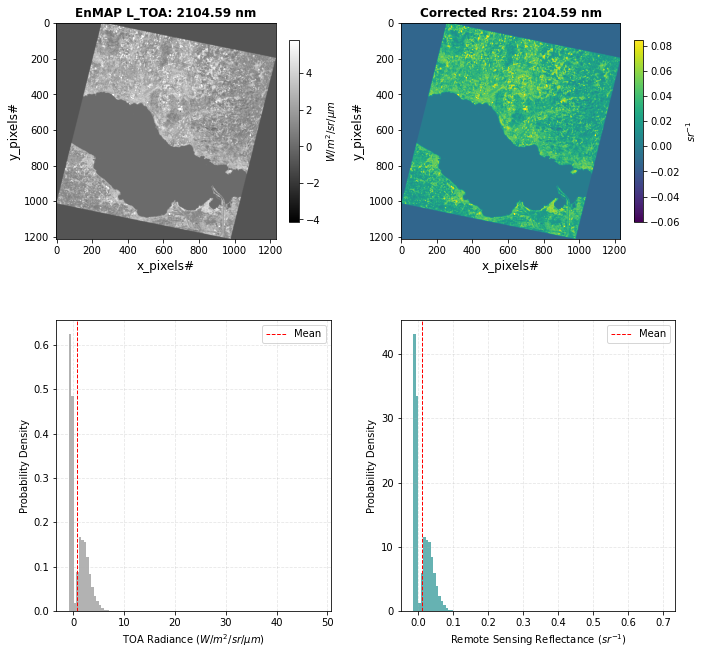

Processing band # 183
Band ID  183.0
Band wavelength center 2113.4
Band Gain  7.71724576025e-07
Band Offset  -0.000785073680295
6S params for band 183: {'spherical_albedo': 0.0015, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.96118, 'total_gaseous_transmittance': 0.95088, 'total_scattering_transmittance_upward': 0.99723, 'total_scattering_transmittance_downward': 0.99611, 'atmospheric_intrinsic_radiance': 0.008, 'direct_solar_irradiance': 67.696, 'diffuse_solar_irradiance': 0.411}
Performing 6ABOS atmospheric correction on EnMAP band: 2113.4 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


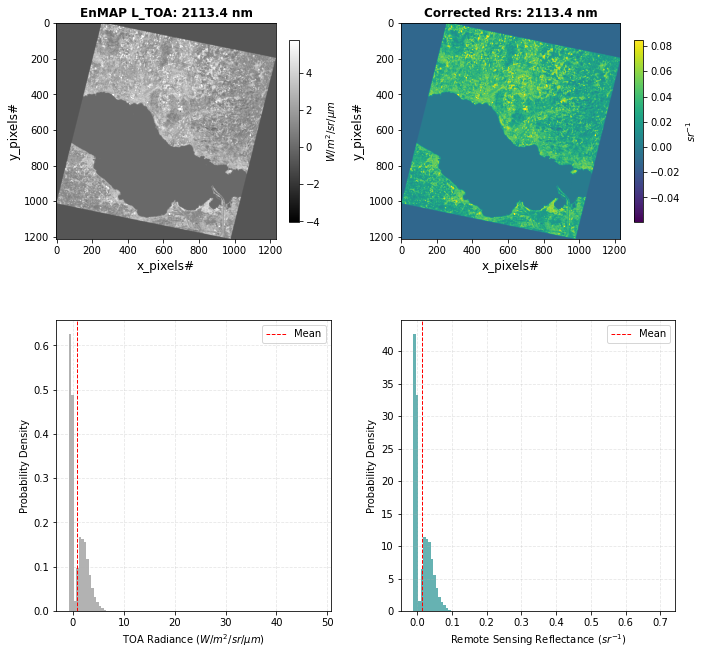

Processing band # 184
Band ID  184.0
Band wavelength center 2122.17
Band Gain  7.58184174119e-07
Band Offset  -0.000709421496427
6S params for band 184: {'spherical_albedo': 0.00149, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97192, 'total_gaseous_transmittance': 0.96341, 'total_scattering_transmittance_upward': 0.99726, 'total_scattering_transmittance_downward': 0.99616, 'atmospheric_intrinsic_radiance': 0.008, 'direct_solar_irradiance': 67.198, 'diffuse_solar_irradiance': 0.407}
Performing 6ABOS atmospheric correction on EnMAP band: 2122.17 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


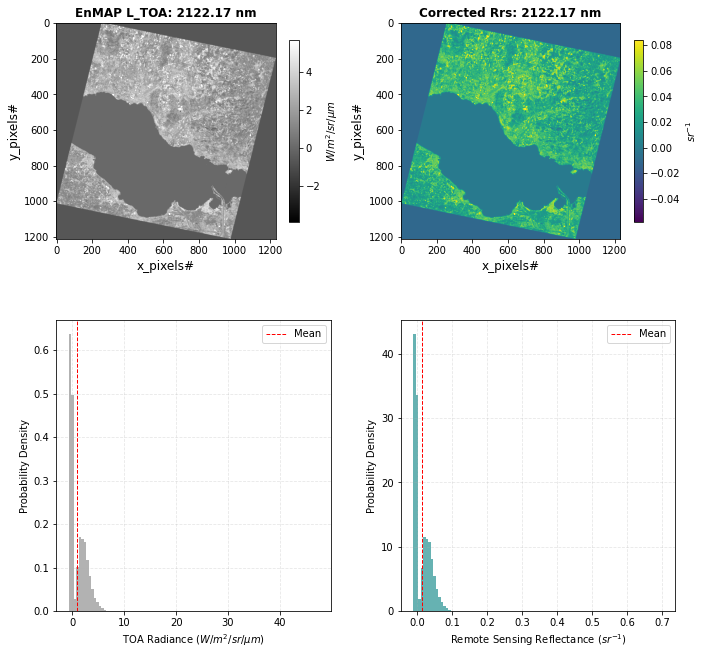

Processing band # 185
Band ID  185.0
Band wavelength center 2130.9
Band Gain  7.64853361234e-07
Band Offset  -0.000703744769602
6S params for band 185: {'spherical_albedo': 0.00148, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97904, 'total_gaseous_transmittance': 0.97698, 'total_scattering_transmittance_upward': 0.9973, 'total_scattering_transmittance_downward': 0.99621, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 66.69, 'diffuse_solar_irradiance': 0.402}
Performing 6ABOS atmospheric correction on EnMAP band: 2130.9 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


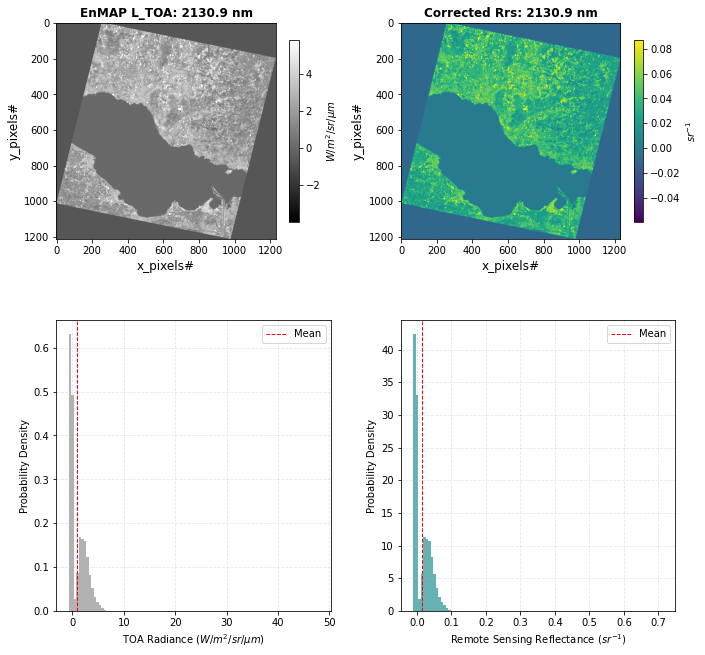

Processing band # 186
Band ID  186.0
Band wavelength center 2139.6
Band Gain  7.7194655635e-07
Band Offset  -0.000726783644691
6S params for band 186: {'spherical_albedo': 0.00147, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99503, 'total_gaseous_transmittance': 0.99392, 'total_scattering_transmittance_upward': 0.99733, 'total_scattering_transmittance_downward': 0.99625, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 66.345, 'diffuse_solar_irradiance': 0.399}
Performing 6ABOS atmospheric correction on EnMAP band: 2139.6 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


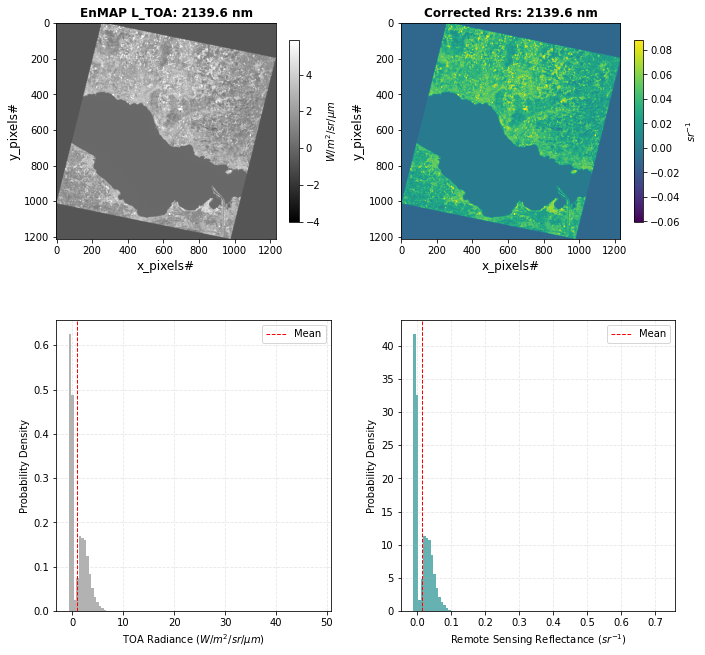

Processing band # 187
Band ID  187.0
Band wavelength center 2148.26
Band Gain  7.66229355023e-07
Band Offset  -0.000799689658457
6S params for band 187: {'spherical_albedo': 0.00145, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97382, 'total_gaseous_transmittance': 0.96955, 'total_scattering_transmittance_upward': 0.99736, 'total_scattering_transmittance_downward': 0.9963, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 64.3, 'diffuse_solar_irradiance': 0.385}
Performing 6ABOS atmospheric correction on EnMAP band: 2148.26 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


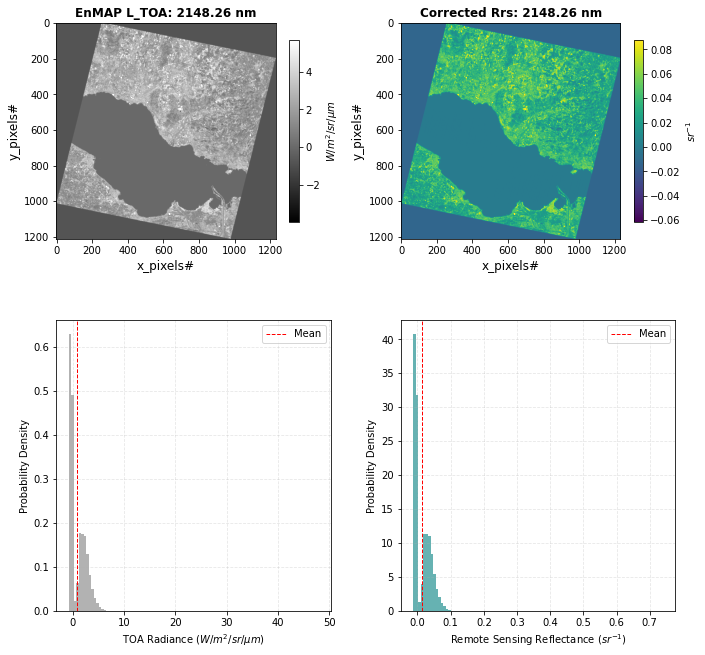

Processing band # 188
Band ID  188.0
Band wavelength center 2156.88
Band Gain  7.65647715411e-07
Band Offset  -0.000909119944996
6S params for band 188: {'spherical_albedo': 0.00144, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.94281, 'total_gaseous_transmittance': 0.93393, 'total_scattering_transmittance_upward': 0.99739, 'total_scattering_transmittance_downward': 0.99634, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 61.785, 'diffuse_solar_irradiance': 0.369}
Performing 6ABOS atmospheric correction on EnMAP band: 2156.88 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


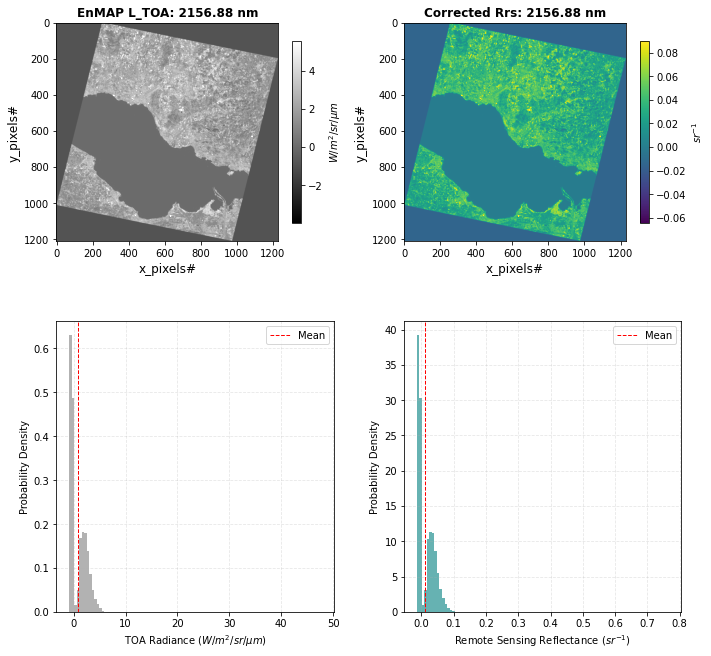

Processing band # 189
Band ID  189.0
Band wavelength center 2165.47
Band Gain  7.60268003761e-07
Band Offset  -0.000944282702685
6S params for band 189: {'spherical_albedo': 0.00143, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.95931, 'total_gaseous_transmittance': 0.94481, 'total_scattering_transmittance_upward': 0.99742, 'total_scattering_transmittance_downward': 0.99638, 'atmospheric_intrinsic_radiance': 0.007, 'direct_solar_irradiance': 61.196, 'diffuse_solar_irradiance': 0.364}
Performing 6ABOS atmospheric correction on EnMAP band: 2165.47 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


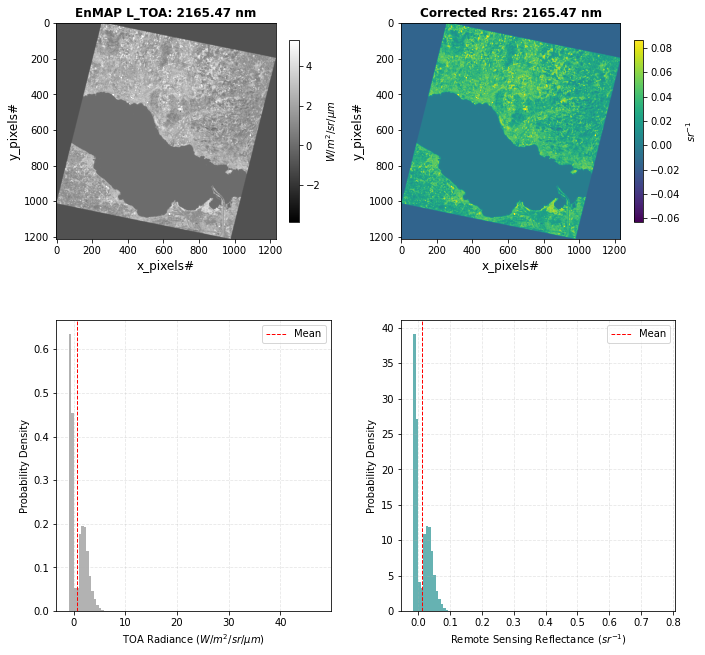

Processing band # 190
Band ID  190.0
Band wavelength center 2174.02
Band Gain  7.85378952464e-07
Band Offset  -0.000831942056985
6S params for band 190: {'spherical_albedo': 0.00142, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.96193, 'total_gaseous_transmittance': 0.94845, 'total_scattering_transmittance_upward': 0.99745, 'total_scattering_transmittance_downward': 0.99643, 'atmospheric_intrinsic_radiance': 0.006, 'direct_solar_irradiance': 60.311, 'diffuse_solar_irradiance': 0.358}
Performing 6ABOS atmospheric correction on EnMAP band: 2174.02 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


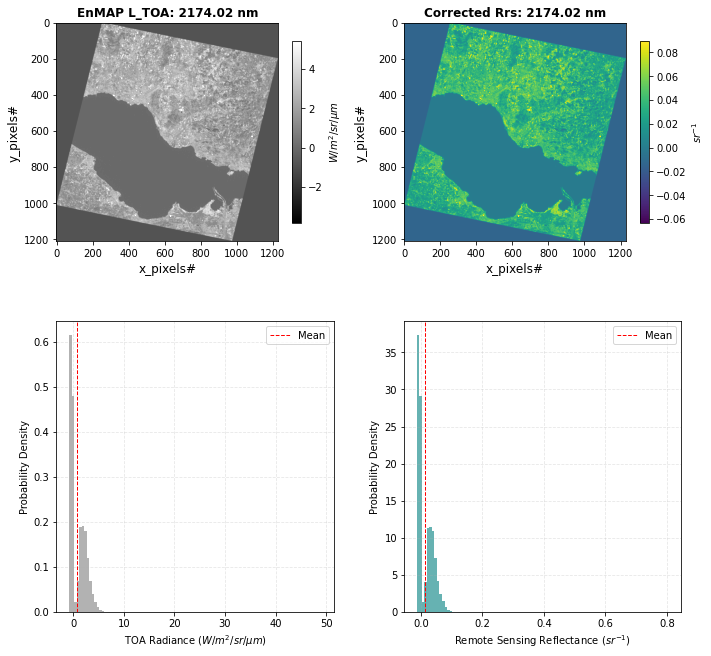

Processing band # 191
Band ID  191.0
Band wavelength center 2182.53
Band Gain  7.61674523397e-07
Band Offset  -0.000953094478969
6S params for band 191: {'spherical_albedo': 0.00141, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.92667, 'total_gaseous_transmittance': 0.92123, 'total_scattering_transmittance_upward': 0.99749, 'total_scattering_transmittance_downward': 0.99647, 'atmospheric_intrinsic_radiance': 0.006, 'direct_solar_irradiance': 58.141, 'diffuse_solar_irradiance': 0.344}
Performing 6ABOS atmospheric correction on EnMAP band: 2182.53 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


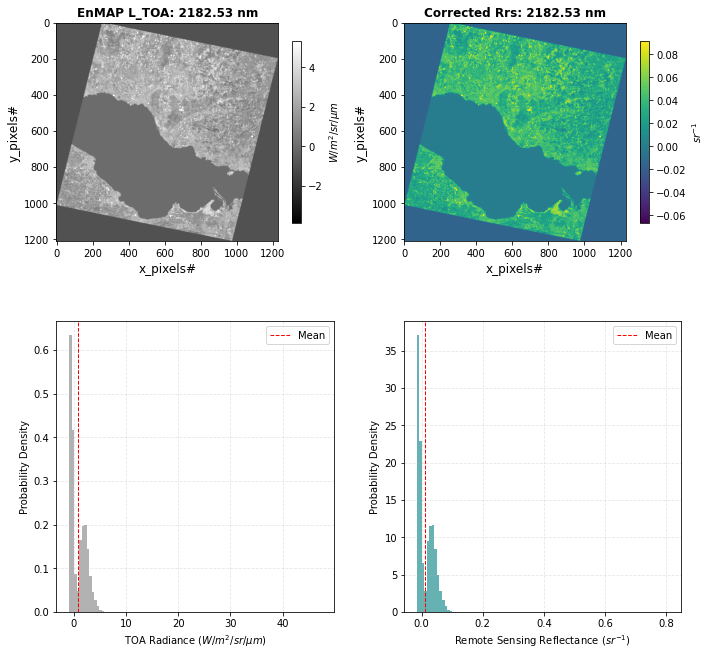

Processing band # 192
Band ID  192.0
Band wavelength center 2191.01
Band Gain  7.70417819633e-07
Band Offset  -0.000872470245077
6S params for band 192: {'spherical_albedo': 0.0014, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.95237, 'total_gaseous_transmittance': 0.94526, 'total_scattering_transmittance_upward': 0.99752, 'total_scattering_transmittance_downward': 0.99651, 'atmospheric_intrinsic_radiance': 0.006, 'direct_solar_irradiance': 58.193, 'diffuse_solar_irradiance': 0.343}
Performing 6ABOS atmospheric correction on EnMAP band: 2191.01 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


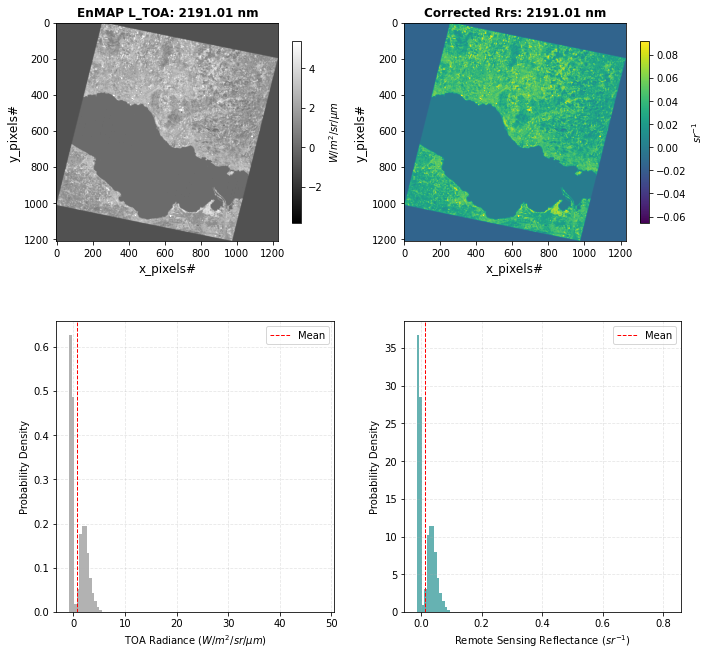

Processing band # 193
Band ID  193.0
Band wavelength center 2199.46
Band Gain  7.00181312083e-07
Band Offset  -0.00126522412892
6S params for band 193: {'spherical_albedo': 0.00139, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.93984, 'total_gaseous_transmittance': 0.87593, 'total_scattering_transmittance_upward': 0.99755, 'total_scattering_transmittance_downward': 0.99656, 'atmospheric_intrinsic_radiance': 0.005, 'direct_solar_irradiance': 55.165, 'diffuse_solar_irradiance': 0.324}
Performing 6ABOS atmospheric correction on EnMAP band: 2199.46 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


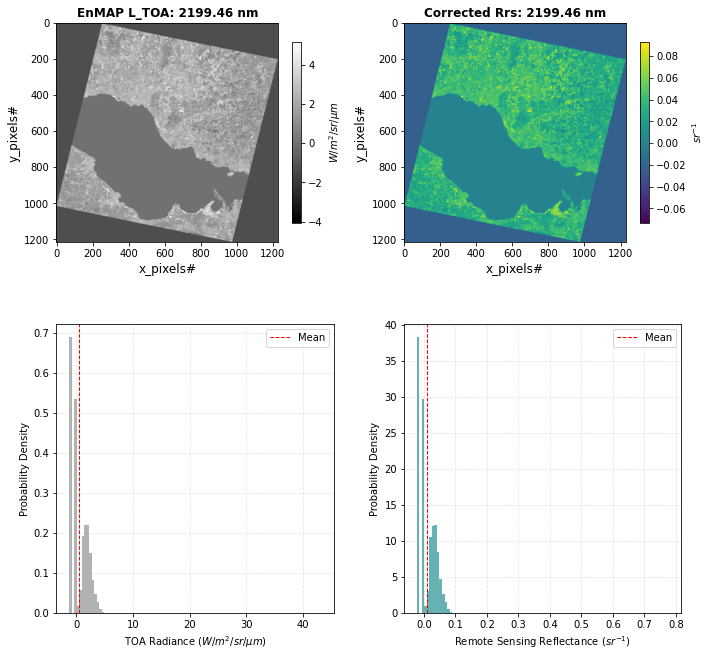

Processing band # 194
Band ID  194.0
Band wavelength center 2207.86
Band Gain  7.33262690313e-07
Band Offset  -0.00105262800103
6S params for band 194: {'spherical_albedo': 0.00138, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.95921, 'total_gaseous_transmittance': 0.93169, 'total_scattering_transmittance_upward': 0.99758, 'total_scattering_transmittance_downward': 0.9966, 'atmospheric_intrinsic_radiance': 0.006, 'direct_solar_irradiance': 57.011, 'diffuse_solar_irradiance': 0.334}
Performing 6ABOS atmospheric correction on EnMAP band: 2207.86 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


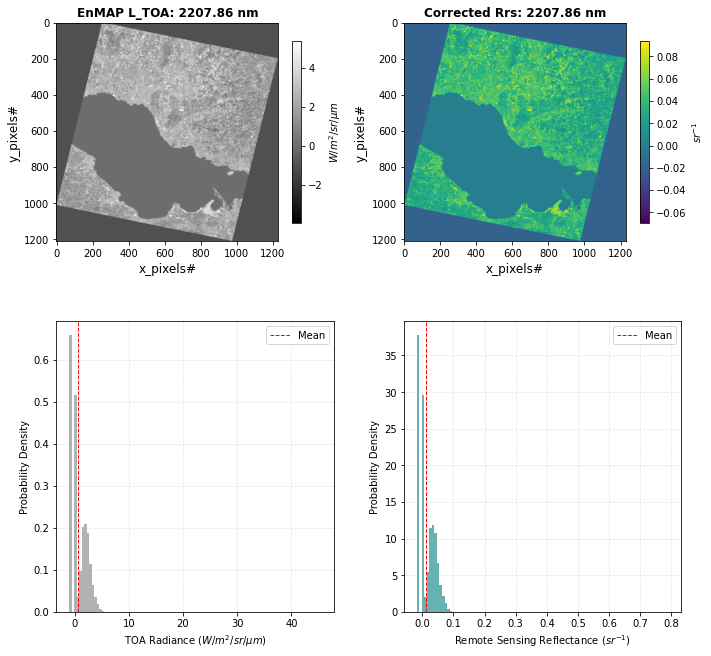

Processing band # 195
Band ID  195.0
Band wavelength center 2216.24
Band Gain  7.29800820456e-07
Band Offset  -0.00112636340099
6S params for band 195: {'spherical_albedo': 0.00137, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98095, 'total_gaseous_transmittance': 0.95649, 'total_scattering_transmittance_upward': 0.99761, 'total_scattering_transmittance_downward': 0.99664, 'atmospheric_intrinsic_radiance': 0.006, 'direct_solar_irradiance': 57.188, 'diffuse_solar_irradiance': 0.334}
Performing 6ABOS atmospheric correction on EnMAP band: 2216.24 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


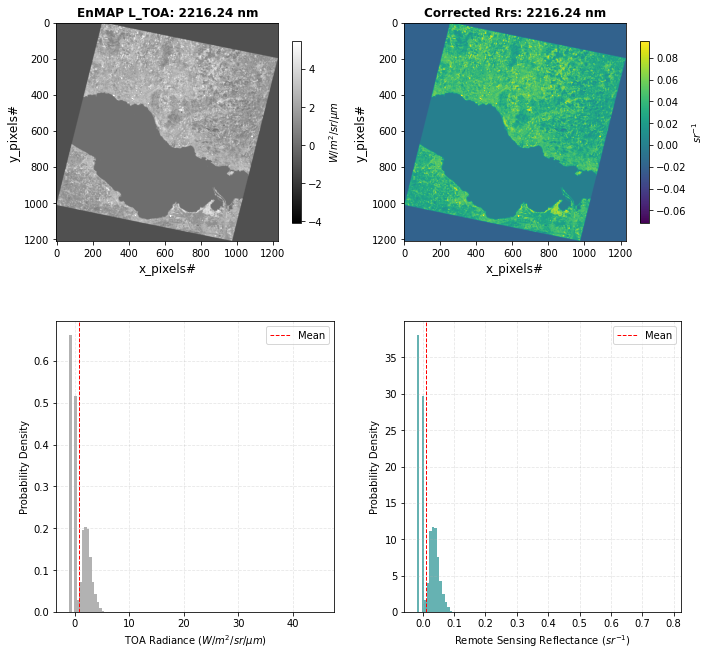

Processing band # 196
Band ID  196.0
Band wavelength center 2224.58
Band Gain  6.94130316013e-07
Band Offset  -0.000706333845622
6S params for band 196: {'spherical_albedo': 0.00136, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98907, 'total_gaseous_transmittance': 0.9548, 'total_scattering_transmittance_upward': 0.99764, 'total_scattering_transmittance_downward': 0.99668, 'atmospheric_intrinsic_radiance': 0.005, 'direct_solar_irradiance': 56.36, 'diffuse_solar_irradiance': 0.329}
Performing 6ABOS atmospheric correction on EnMAP band: 2224.58 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


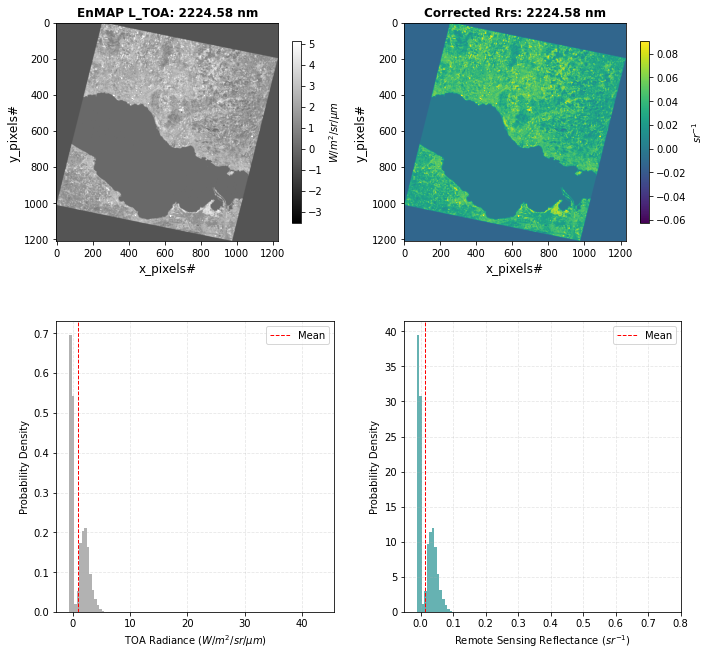

Processing band # 197
Band ID  197.0
Band wavelength center 2232.89
Band Gain  6.95317640737e-07
Band Offset  -0.00079783084023
6S params for band 197: {'spherical_albedo': 0.00136, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99524, 'total_gaseous_transmittance': 0.94019, 'total_scattering_transmittance_upward': 0.99767, 'total_scattering_transmittance_downward': 0.99672, 'atmospheric_intrinsic_radiance': 0.005, 'direct_solar_irradiance': 55.027, 'diffuse_solar_irradiance': 0.32}
Performing 6ABOS atmospheric correction on EnMAP band: 2232.89 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


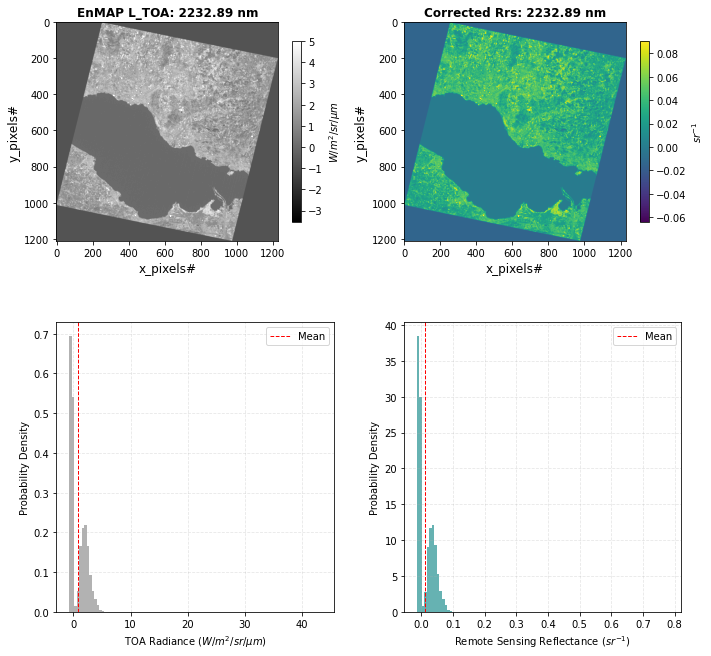

Processing band # 198
Band ID  198.0
Band wavelength center 2241.16
Band Gain  7.00807745676e-07
Band Offset  -0.00132624955064
6S params for band 198: {'spherical_albedo': 0.00135, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99738, 'total_gaseous_transmittance': 0.93006, 'total_scattering_transmittance_upward': 0.9977, 'total_scattering_transmittance_downward': 0.99677, 'atmospheric_intrinsic_radiance': 0.005, 'direct_solar_irradiance': 53.879, 'diffuse_solar_irradiance': 0.312}
Performing 6ABOS atmospheric correction on EnMAP band: 2241.16 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


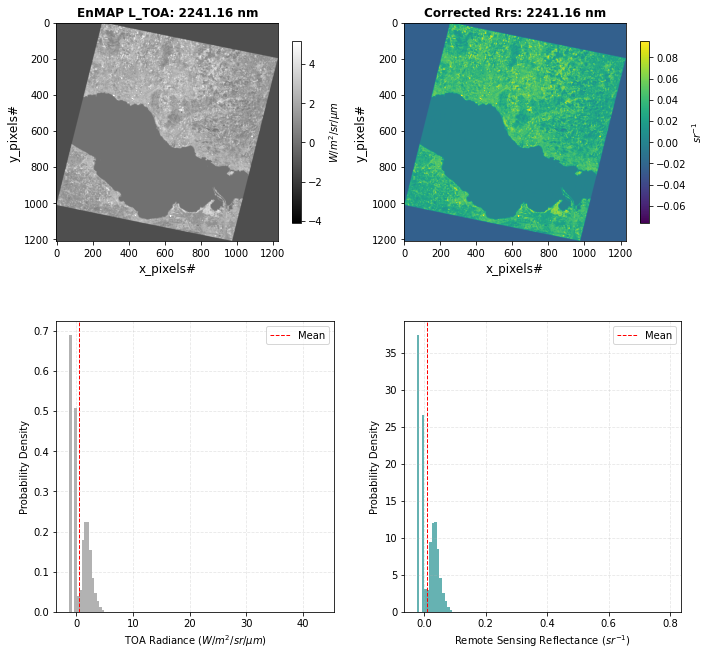

Processing band # 199
Band ID  199.0
Band wavelength center 2249.4
Band Gain  7.27342267561e-07
Band Offset  -0.00141536721756
6S params for band 199: {'spherical_albedo': 0.00134, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99921, 'total_gaseous_transmittance': 0.91234, 'total_scattering_transmittance_upward': 0.99772, 'total_scattering_transmittance_downward': 0.9968, 'atmospheric_intrinsic_radiance': 0.005, 'direct_solar_irradiance': 52.461, 'diffuse_solar_irradiance': 0.303}
Performing 6ABOS atmospheric correction on EnMAP band: 2249.4 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


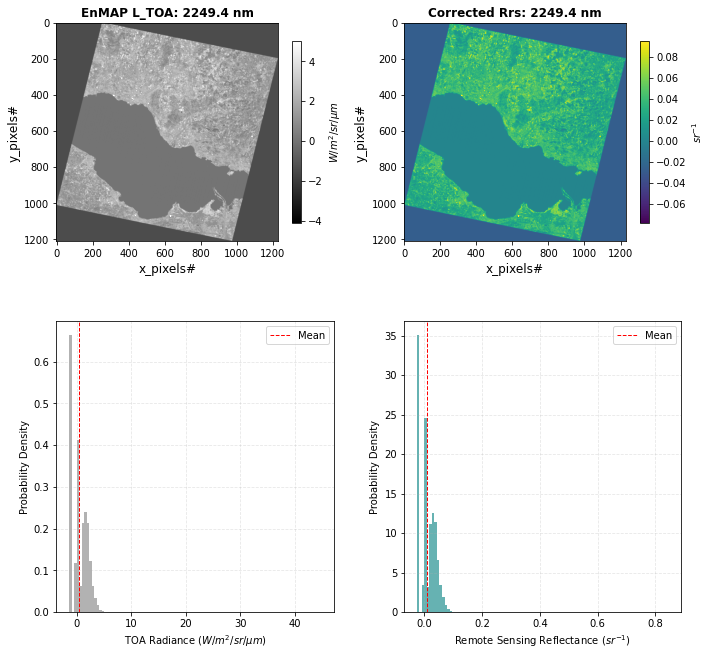

Processing band # 200
Band ID  200.0
Band wavelength center 2257.61
Band Gain  7.19023036172e-07
Band Offset  -0.00159927892509
6S params for band 200: {'spherical_albedo': 0.00134, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99904, 'total_gaseous_transmittance': 0.88601, 'total_scattering_transmittance_upward': 0.99773, 'total_scattering_transmittance_downward': 0.99682, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 50.706, 'diffuse_solar_irradiance': 0.292}
Performing 6ABOS atmospheric correction on EnMAP band: 2257.61 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


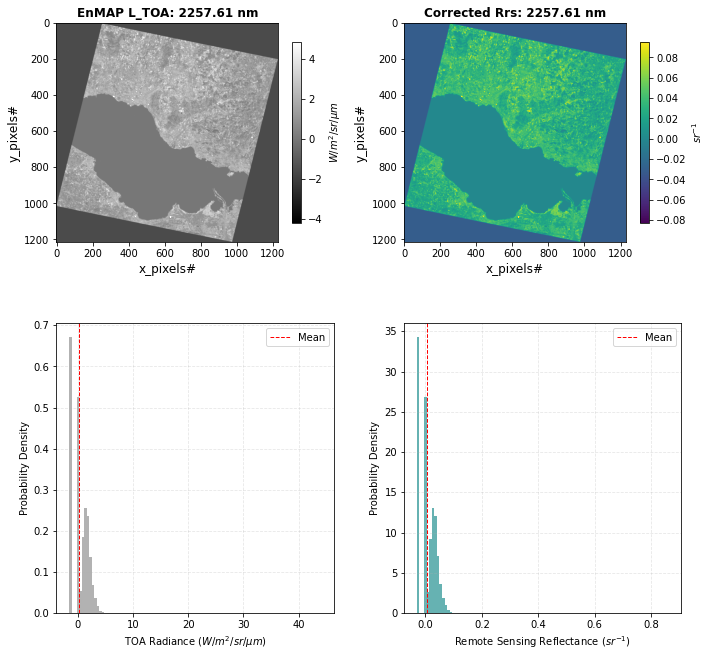

Processing band # 201
Band ID  201.0
Band wavelength center 2265.79
Band Gain  7.32116919396e-07
Band Offset  -0.00163209308363
6S params for band 201: {'spherical_albedo': 0.00133, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99984, 'total_gaseous_transmittance': 0.90191, 'total_scattering_transmittance_upward': 0.99774, 'total_scattering_transmittance_downward': 0.99683, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 50.488, 'diffuse_solar_irradiance': 0.29}
Performing 6ABOS atmospheric correction on EnMAP band: 2265.79 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


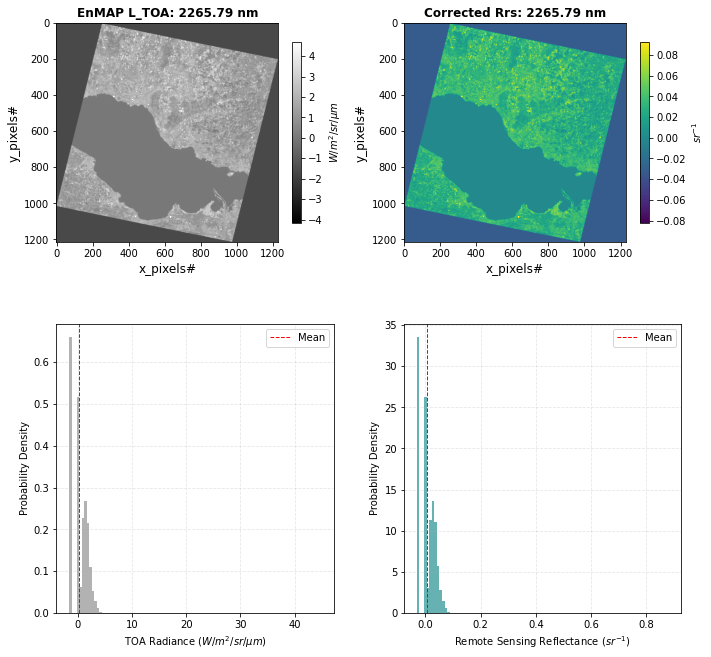

Processing band # 202
Band ID  202.0
Band wavelength center 2273.93
Band Gain  7.15856192663e-07
Band Offset  -0.00168307499935
6S params for band 202: {'spherical_albedo': 0.00133, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99978, 'total_gaseous_transmittance': 0.87011, 'total_scattering_transmittance_upward': 0.99775, 'total_scattering_transmittance_downward': 0.99685, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 48.517, 'diffuse_solar_irradiance': 0.278}
Performing 6ABOS atmospheric correction on EnMAP band: 2273.93 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


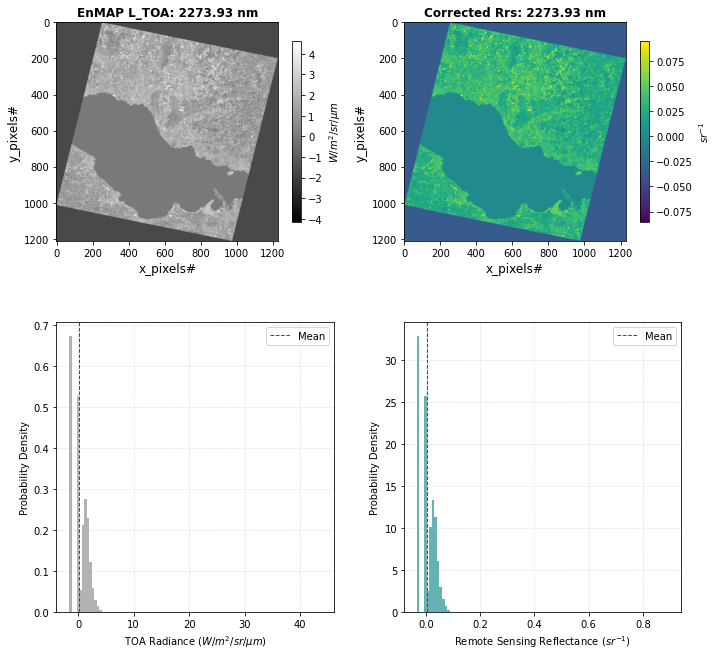

Processing band # 203
Band ID  203.0
Band wavelength center 2282.04
Band Gain  7.29901038462e-07
Band Offset  -0.00160666820619
6S params for band 203: {'spherical_albedo': 0.00133, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99988, 'total_gaseous_transmittance': 0.88471, 'total_scattering_transmittance_upward': 0.99776, 'total_scattering_transmittance_downward': 0.99686, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 48.296, 'diffuse_solar_irradiance': 0.276}
Performing 6ABOS atmospheric correction on EnMAP band: 2282.04 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


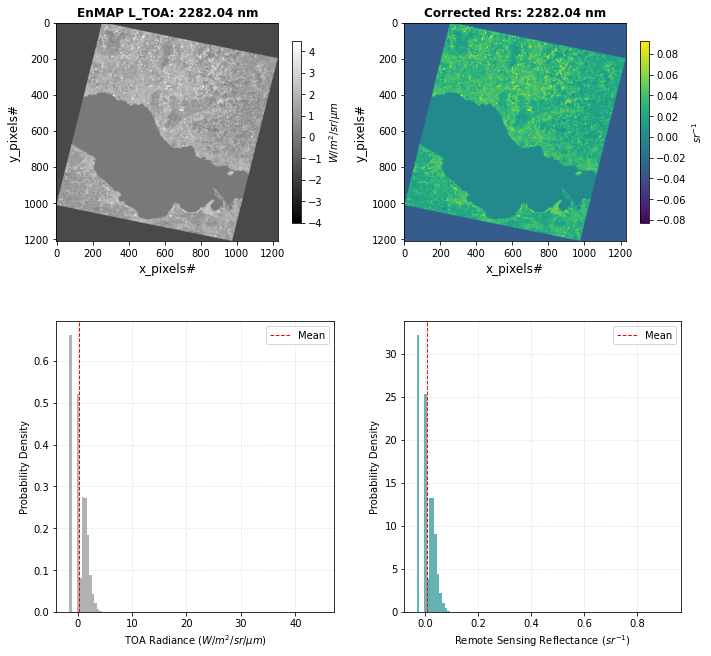

Processing band # 204
Band ID  204.0
Band wavelength center 2290.12
Band Gain  7.37063982582e-07
Band Offset  -0.00152938677131
6S params for band 204: {'spherical_albedo': 0.00133, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99993, 'total_gaseous_transmittance': 0.86148, 'total_scattering_transmittance_upward': 0.99777, 'total_scattering_transmittance_downward': 0.99687, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 46.876, 'diffuse_solar_irradiance': 0.267}
Performing 6ABOS atmospheric correction on EnMAP band: 2290.12 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


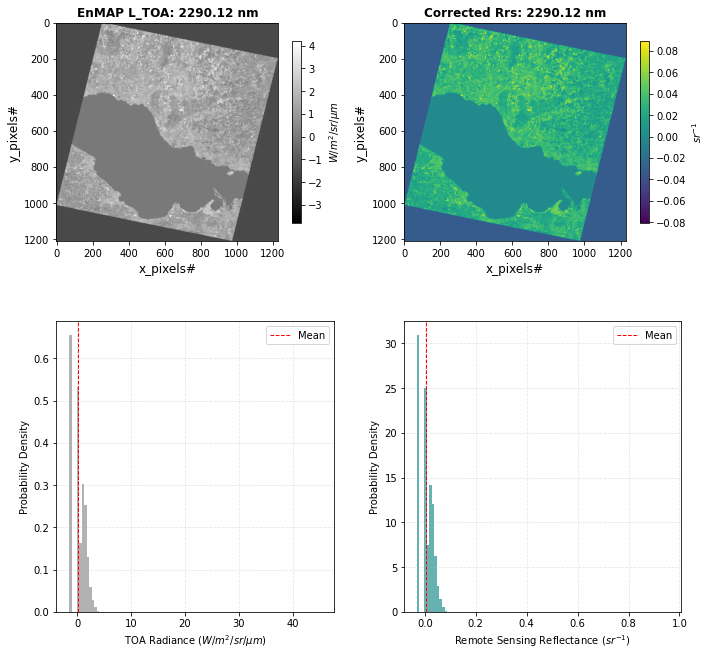

Processing band # 205
Band ID  205.0
Band wavelength center 2298.17
Band Gain  7.42343987832e-07
Band Offset  -0.00147164842187
6S params for band 205: {'spherical_albedo': 0.00132, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.99582, 'total_gaseous_transmittance': 0.82885, 'total_scattering_transmittance_upward': 0.99778, 'total_scattering_transmittance_downward': 0.99689, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 45.428, 'diffuse_solar_irradiance': 0.258}
Performing 6ABOS atmospheric correction on EnMAP band: 2298.17 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


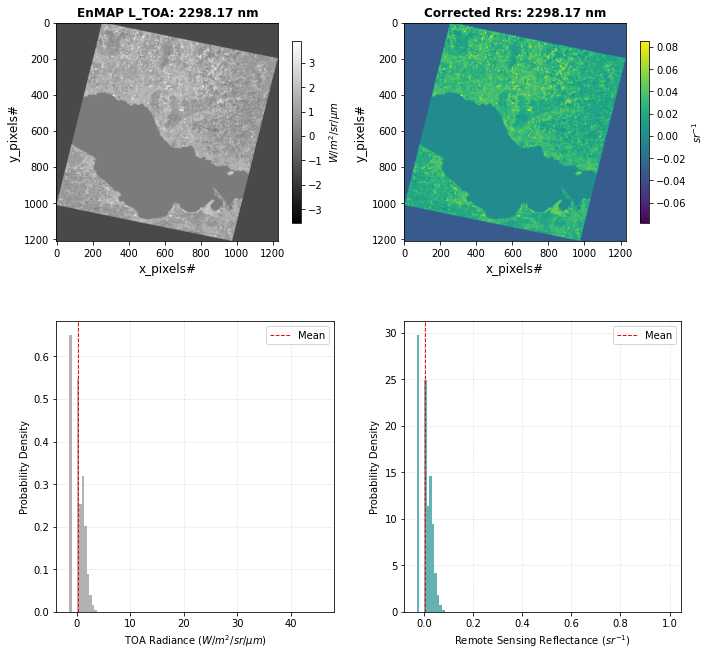

Processing band # 206
Band ID  206.0
Band wavelength center 2306.19
Band Gain  7.39822677888e-07
Band Offset  -0.00162380514997
6S params for band 206: {'spherical_albedo': 0.00132, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.98899, 'total_gaseous_transmittance': 0.87686, 'total_scattering_transmittance_upward': 0.99779, 'total_scattering_transmittance_downward': 0.9969, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 46.765, 'diffuse_solar_irradiance': 0.265}
Performing 6ABOS atmospheric correction on EnMAP band: 2306.19 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


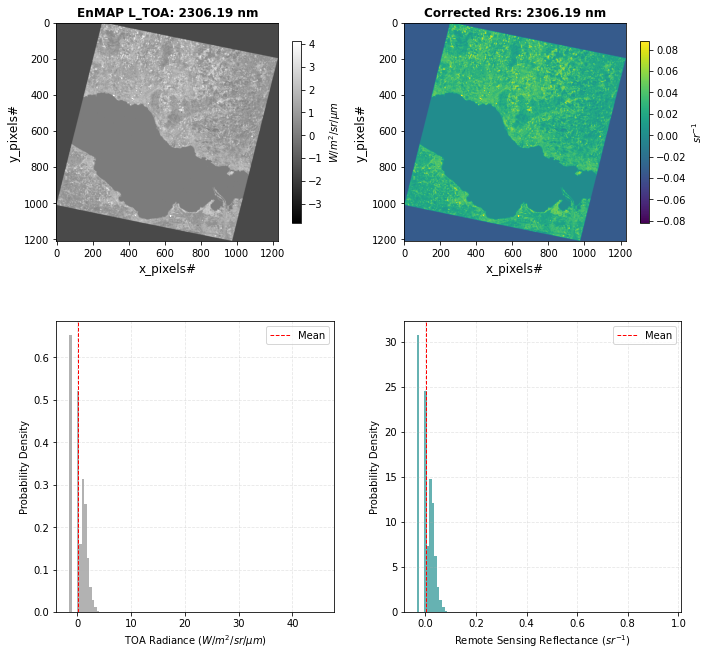

Processing band # 207
Band ID  207.0
Band wavelength center 2314.18
Band Gain  7.46046426379e-07
Band Offset  -0.00148097850499
6S params for band 207: {'spherical_albedo': 0.00132, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.97562, 'total_gaseous_transmittance': 0.77954, 'total_scattering_transmittance_upward': 0.9978, 'total_scattering_transmittance_downward': 0.99691, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 42.784, 'diffuse_solar_irradiance': 0.242}
Performing 6ABOS atmospheric correction on EnMAP band: 2314.18 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


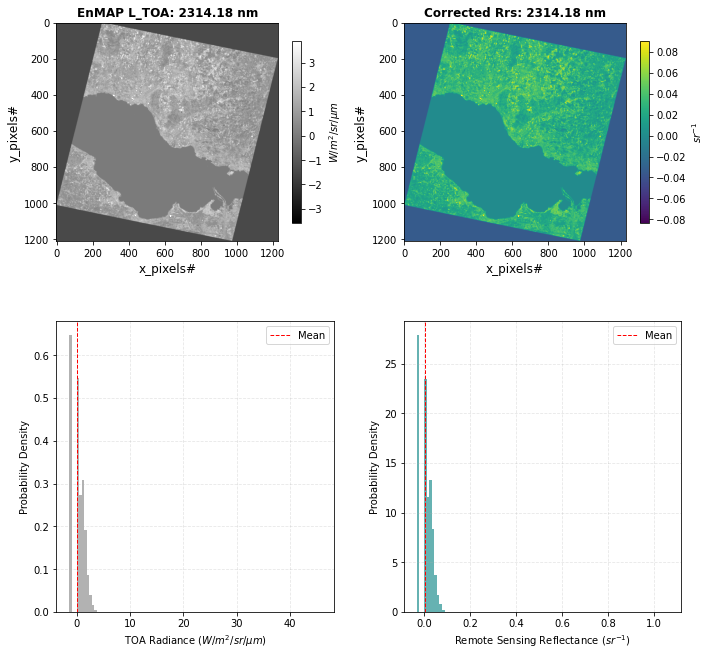

Processing band # 208
Band ID  208.0
Band wavelength center 2322.13
Band Gain  7.40445416546e-07
Band Offset  -0.00146825499573
6S params for band 208: {'spherical_albedo': 0.00132, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.9299, 'total_gaseous_transmittance': 0.78465, 'total_scattering_transmittance_upward': 0.99781, 'total_scattering_transmittance_downward': 0.99693, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 42.433, 'diffuse_solar_irradiance': 0.239}
Performing 6ABOS atmospheric correction on EnMAP band: 2322.13 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


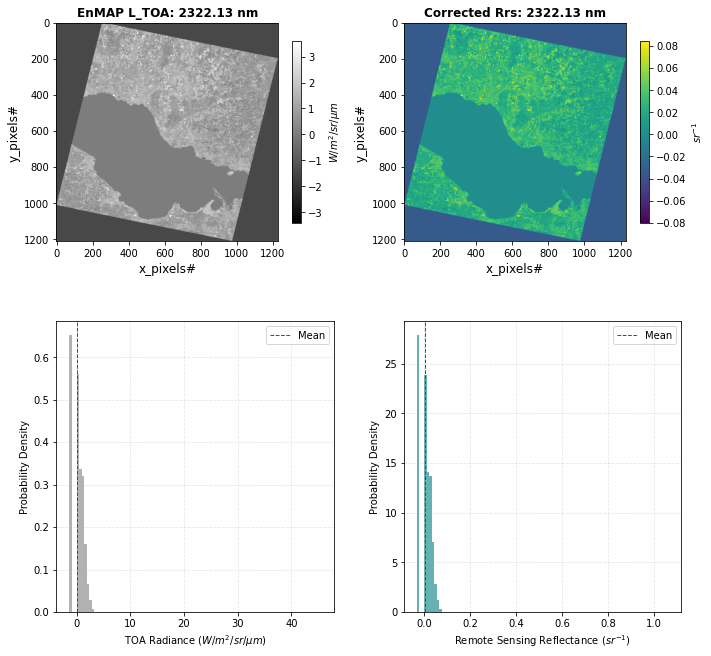

Processing band # 209
Band ID  209.0
Band wavelength center 2330.05
Band Gain  7.50016093993e-07
Band Offset  -0.00160397176971
6S params for band 209: {'spherical_albedo': 0.00132, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.96598, 'total_gaseous_transmittance': 0.86046, 'total_scattering_transmittance_upward': 0.99782, 'total_scattering_transmittance_downward': 0.99694, 'atmospheric_intrinsic_radiance': 0.004, 'direct_solar_irradiance': 44.577, 'diffuse_solar_irradiance': 0.251}
Performing 6ABOS atmospheric correction on EnMAP band: 2330.05 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


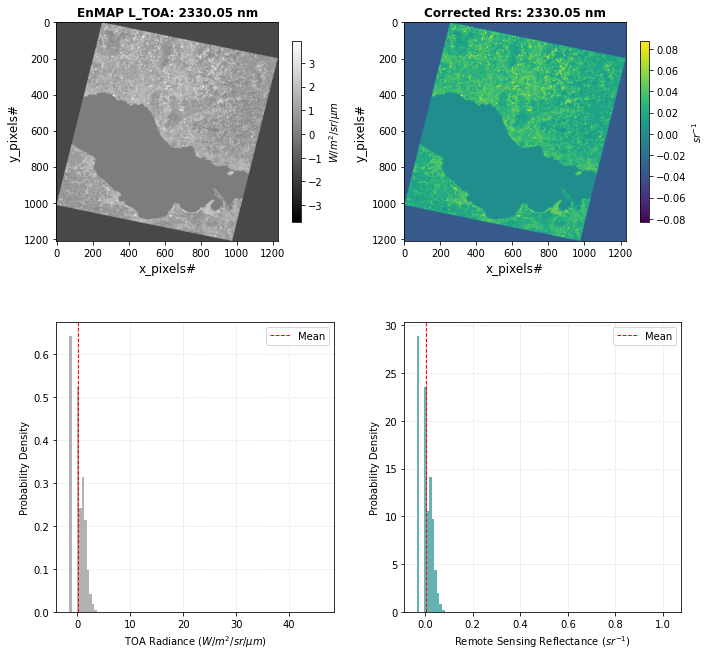

Processing band # 210
Band ID  210.0
Band wavelength center 2337.94
Band Gain  7.38177977057e-07
Band Offset  -0.00139671050717
6S params for band 210: {'spherical_albedo': 0.00131, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.92544, 'total_gaseous_transmittance': 0.77539, 'total_scattering_transmittance_upward': 0.99783, 'total_scattering_transmittance_downward': 0.99695, 'atmospheric_intrinsic_radiance': 0.003, 'direct_solar_irradiance': 41.066, 'diffuse_solar_irradiance': 0.23}
Performing 6ABOS atmospheric correction on EnMAP band: 2337.94 nm
Band with tgas > 0.75 included from surface level reflectance ρs calculation


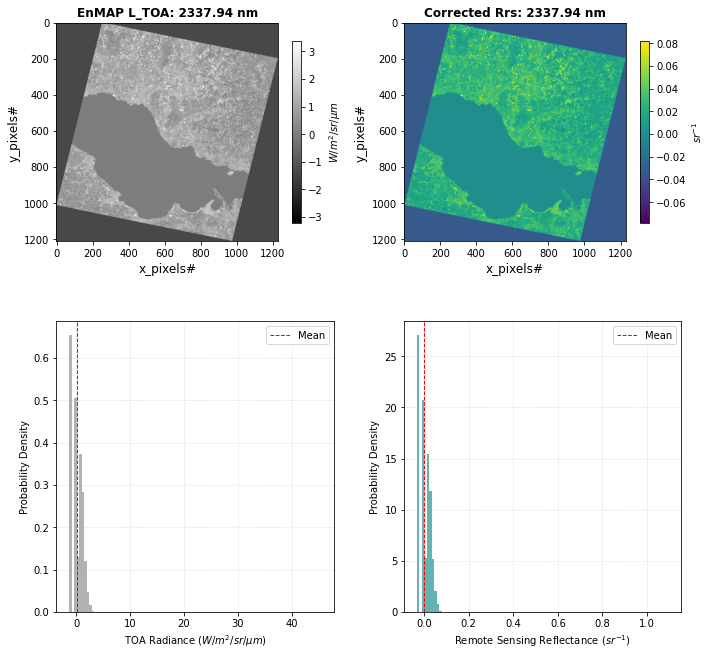

Processing band # 211
Band ID  211.0
Band wavelength center 2345.81
Band Gain  7.54270840052e-07
Band Offset  -0.00126699452954
6S params for band 211: {'spherical_albedo': 0.00131, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.84133, 'total_gaseous_transmittance': 0.68624, 'total_scattering_transmittance_upward': 0.99784, 'total_scattering_transmittance_downward': 0.99697, 'atmospheric_intrinsic_radiance': 0.003, 'direct_solar_irradiance': 36.985, 'diffuse_solar_irradiance': 0.207}
Performing 6ABOS atmospheric correction on EnMAP band: 2345.81 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 2345.81 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 212
Band ID  212.0
Band wavelength center 2353.64
Band Gain  7.93925507623e-07
Band Offset  -0.00244056337608
6S params for band 212: {'spherical_albedo': 0.00131, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.88082, 'total_gaseous

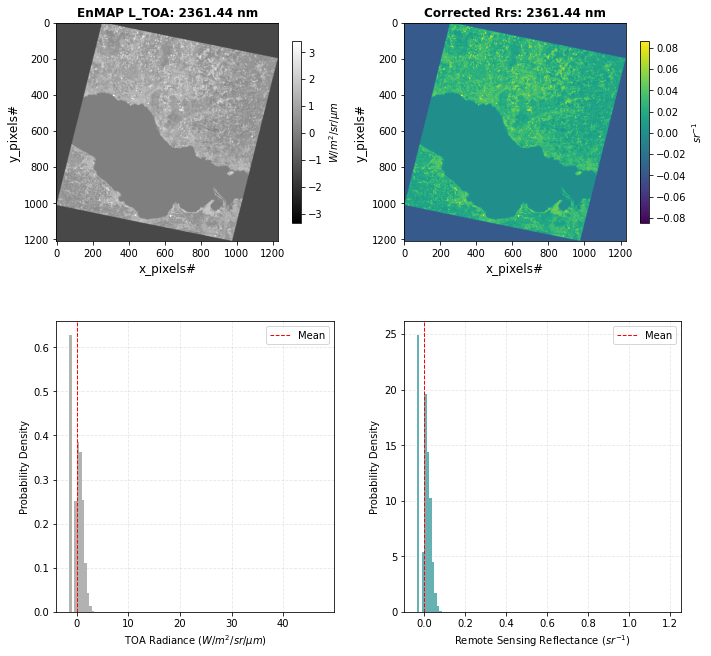

Processing band # 214
Band ID  214.0
Band wavelength center 2369.21
Band Gain  7.12652570339e-07
Band Offset  -0.00102536003559
6S params for band 214: {'spherical_albedo': 0.00131, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.85912, 'total_gaseous_transmittance': 0.63093, 'total_scattering_transmittance_upward': 0.99787, 'total_scattering_transmittance_downward': 0.99701, 'atmospheric_intrinsic_radiance': 0.003, 'direct_solar_irradiance': 33.466, 'diffuse_solar_irradiance': 0.186}
Performing 6ABOS atmospheric correction on EnMAP band: 2369.21 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 2369.21 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 215
Band ID  215.0
Band wavelength center 2376.95
Band Gain  7.32424792748e-07
Band Offset  -0.00116781197501
6S params for band 215: {'spherical_albedo': 0.0013, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.77297, 'total_gaseous_

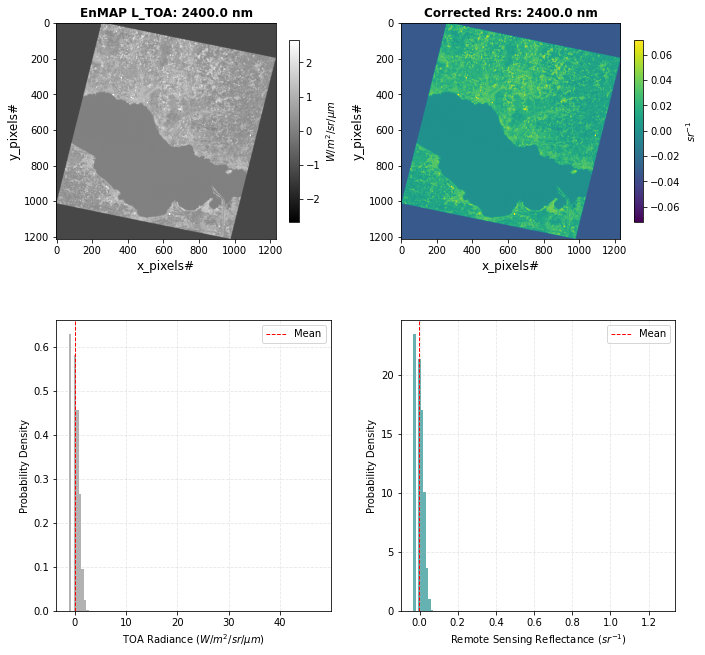

Processing band # 219
Band ID  219.0
Band wavelength center 2407.62
Band Gain  6.29440985935e-07
Band Offset  -0.000992494385794
6S params for band 219: {'spherical_albedo': 0.0013, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.67205, 'total_gaseous_transmittance': 0.64686, 'total_scattering_transmittance_upward': 0.99792, 'total_scattering_transmittance_downward': 0.99707, 'atmospheric_intrinsic_radiance': 0.003, 'direct_solar_irradiance': 31.675, 'diffuse_solar_irradiance': 0.174}
Performing 6ABOS atmospheric correction on EnMAP band: 2407.62 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 2407.62 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 220
Band ID  220.0
Band wavelength center 2415.21
Band Gain  4.69596734139e-07
Band Offset  -0.000691061816787
6S params for band 220: {'spherical_albedo': 0.0013, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.56405, 'total_gaseous

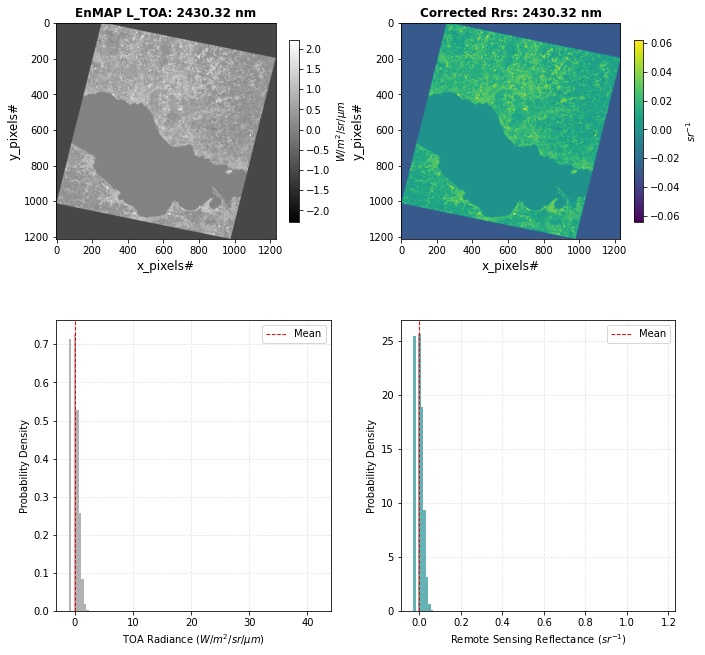

Processing band # 223
Band ID  223.0
Band wavelength center 2437.83
Band Gain  5.70093906551e-07
Band Offset  -0.00100550626746
6S params for band 223: {'spherical_albedo': 0.00129, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.61171, 'total_gaseous_transmittance': 0.59813, 'total_scattering_transmittance_upward': 0.99795, 'total_scattering_transmittance_downward': 0.99712, 'atmospheric_intrinsic_radiance': 0.003, 'direct_solar_irradiance': 27.873, 'diffuse_solar_irradiance': 0.152}
Performing 6ABOS atmospheric correction on EnMAP band: 2437.83 nm
Band with tgas < 0.75 excluded from surface level reflectance ρs calculation
Skipping plot for band 2437.83 nm: Data is all NaN (Gaseous absorption too high).
Processing band # 224
Band ID  224.0
Band wavelength center 2445.3
Band Gain  4.15321890969e-07
Band Offset  -0.000579414142747
6S params for band 224: {'spherical_albedo': 0.00129, 'ozone_transmittance_total': 1.0, 'water_transmittance_total': 0.45326, 'total_gaseous

In [28]:
# Initializing containers for atmospheric components and output products
# Open the multi-band TIFF
dataset = gdal.Open(path_to_toa_radiance, gdal.GA_ReadOnly)

if not dataset:
    print("Failed to open the file.")
else:
    # Get the total number of bands
    total_bands = dataset.RasterCount
    rows = dataset.RasterYSize
    cols = dataset.RasterXSize
    
    # Pre-allocate the 3D array to save memory 
    sixabos_3d_cube = np.empty((total_bands, rows, cols), dtype=np.float32)

    if conf['verbose']:
        print(f"Total bands found: {total_bands}")

    # Iterate through each band individually
    for i in range(1, total_bands+1):
        if conf['verbose']:
            print('Processing band #',i)
        band = dataset.GetRasterBand(i)
        
        # Read band data as a NumPy array (TOA Radiance)
        band_data = band.ReadAsArray().astype(np.float32)
        
        # Read gain and offset from the EnMAP spectral configuration dataframe
        band_scale = enmap_spectral_conf_df.iloc[i-1]['gain']
        band_offset = enmap_spectral_conf_df.iloc[i-1]['offset']
        band_id = enmap_spectral_conf_df.iloc[i-1]['band_id']
        band_wv = enmap_spectral_conf_df.iloc[i-1]['wavelength_center']
        
        if conf['verbose']:
            print('Band ID ',band_id)
            print('Band wavelength center', band_wv)
            print('Band Gain ',band_scale)
            print('Band Offset ',band_offset)
        
        # Radiance = (DN * Gain) + Offset
        array_enmap_aux = band_data*band_scale + band_offset
        
        # Access the corresponding 6S parameters from 6S dictionary
        params_6s = dictionary_enmap_6s[str(i)]
        if conf['verbose']:
            print(f"6S params for band {i}: {params_6s}")
        
        if params_6s:
            #############################################################
            # 6ABOS Atmospheric Correction
            #
            if conf['verbose']:
                print(f"\033[1mPerforming 6ABOS atmospheric correction on EnMAP band: {band_wv} nm\033[0m")
            
            # Atmospherically corrected Remote Sensing Reflectance (Rrs) 
            tgas_threshold = conf['tgas_threshold']
            rrs,p_boa,l_toa_corrected = atmospheric_correction(array_enmap_aux,params_6s,earth_sun_d,tgas_threshold)
            #
            #############################################################
            pass
            
        if conf['data plotting']: 
            # Check if the array is full of NaNs (excluded band)
            if np.isnan(rrs).all():
                print(f"Skipping plot for band {band_wv} nm: Data is all NaN (Gaseous absorption too high).")
            else:
            # Proceed with plotting only if we have valid data
                fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(10, 10), gridspec_kw={'height_ratios': [1, 0.8]})

                # Plot 1: EnMAP Top of Atmosphere (TOA) Reflectance
                vmin1, vmax1 = np.mean(l_toa_corrected)-3*np.std(l_toa_corrected), np.mean(l_toa_corrected)+3*np.std(l_toa_corrected)
                im1 = ax1.imshow(l_toa_corrected, cmap='gray', vmin=vmin1, vmax=vmax1)
                ax1.set_title(f'EnMAP L_TOA: {band_wv} nm', fontsize=12, fontweight='bold')
                ax1.set_xlabel('x_pixels#', fontsize=12)
                ax1.set_ylabel('y_pixels#', fontsize=12)
                fig.colorbar(im1, ax=ax1, shrink=0.5, pad=0.05, label='$W/m^2/sr/\mu m$')

                # Plot 2: Atmospherically Corrected Remote Sensing Reflectance (Rrs)
                vmin2, vmax2 = np.mean(rrs)-3*np.std(rrs), np.mean(rrs)+3*np.std(rrs)
                im2 = ax2.imshow(rrs, cmap='viridis', vmin=vmin2, vmax=vmax2)
                ax2.set_title(f'Corrected Rrs: {band_wv} nm', fontsize=12, fontweight='bold')
                ax2.set_xlabel('x_pixels#', fontsize=12)
                ax2.set_ylabel('y_pixels#', fontsize=12)
                fig.colorbar(im2, ax=ax2, shrink=0.5, pad=0.05, label='$sr^{-1}$')

                # Histogram 1: TOA Reflectance Distribution
                ax3.hist(l_toa_corrected.ravel(), bins=100, color='gray', alpha=0.6, density=True)
                ax3.set_xlabel('TOA Radiance ($W/m^2/sr/\mu m$)')
                ax3.set_ylabel('Probability Density')
                ax3.grid(True, alpha=0.3, linestyle='--')
                ax3.axvline(np.mean(l_toa_corrected), color='red', linestyle='dashed', linewidth=1, label='Mean')
                ax3.legend()

                # Histogram 2: Rrs Distribution
                ax4.hist(rrs.ravel(), bins=100, color='teal', alpha=0.6, density=True)
                ax4.set_xlabel('Remote Sensing Reflectance ($sr^{-1}$)')
                ax4.set_ylabel('Probability Density')
                ax4.grid(True, alpha=0.3, linestyle='--')
                ax4.axvline(np.mean(rrs), color='red', linestyle='dashed', linewidth=1, label='Mean')
                ax4.legend()

                # Final layout adjustments
                plt.tight_layout()
                plt.show()
          
        if conf['output_rrs']:
            # Storing band-wise Rrs into the pre-allocated 3D cube
            sixabos_3d_cube[i-1, :, :] = rrs.astype(np.float32)
        else:
            # Storing band-wise surface reflectance into the pre-allocated 3D cube
            sixabos_3d_cube[i-1, :, :] = p_boa.astype(np.float32)
            
    # Clean up
    dataset = None
    band = None

print('End of data processing')

print(f"Final Data Cube Shape: {sixabos_3d_cube.shape}")

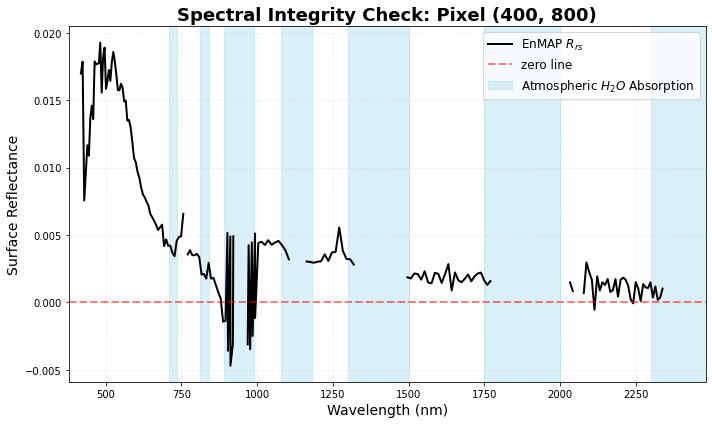

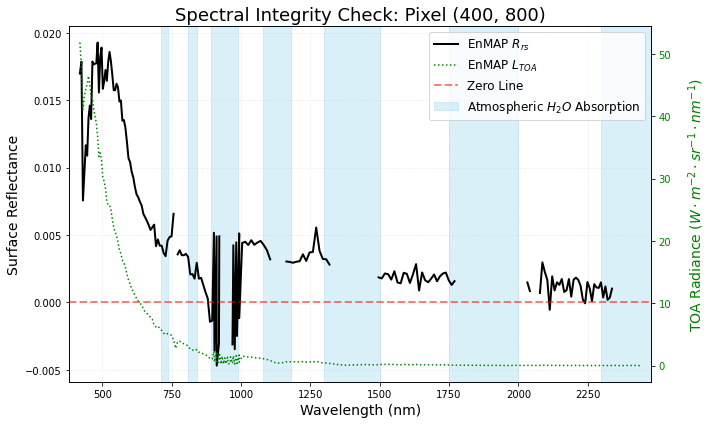

In [29]:
if conf['data plotting']:
    # RE-OPEN the LTOA dataset
    temp_ds = gdal.Open(path_to_toa_radiance, gdal.GA_ReadOnly)
    
    if not temp_ds:
        print("Error: Could not re-open dataset for plotting.")
    else:
        # Define the spectral windows for Water Vapor (H2O) absorption (nm)
        h2o_windows = [
            (710, 735), (810, 840), (890, 990), (1080, 1180), 
            (1300, 1500), (1750, 2000), (2300, 2500)
        ]

        # Extract spectrum and wavelengths
        x_coord, y_coord = 400, 800
        pixel_spectrum = sixabos_3d_cube[:, y_coord, x_coord]

        # Extracting TOA Radiance directly from the temporary dataset
        pixel_ltoa = []
        for b in range(1, total_bands + 1):
            band_obj = temp_ds.GetRasterBand(b)
            # Read only a 1x1 window at the specific coordinate
            # band_obj.ReadAsArray(x_offset, y_offset, x_size, y_size)
            val = band_obj.ReadAsArray(x_coord, y_coord, 1, 1)[0, 0]
            
            gain = enmap_spectral_conf_df.iloc[b-1]['gain']
            offset = enmap_spectral_conf_df.iloc[b-1]['offset']
            pixel_ltoa.append(val * gain + offset)
        
        pixel_ltoa = np.array(pixel_ltoa)*1000
        wavelengths = enmap_spectral_conf_df['wavelength_center'].values

    # Plotting EnMAP Rrs
    plt.figure(figsize=(10, 6))

    # Plot the valid spectrum (filtering out NaNs for a continuous line where possible)
    plt.plot(wavelengths, pixel_spectrum, color='black', lw=2, label='EnMAP $R_{rs}$')

    # Highlight Water Absorption Windows
    for i, (start, end) in enumerate(h2o_windows):
        # Only label the first one to keep the legend clean
        lbl = "Atmospheric $H_{2}O$ Absorption" if i == 0 else ""
        plt.axvspan(start, end, color='skyblue', alpha=0.3, label=lbl)

    # Scientific Styling
    plt.title(f'Spectral Integrity Check: Pixel ({x_coord}, {y_coord})', fontsize=18, fontweight='bold')
    plt.xlabel('Wavelength (nm)', fontsize=14)
    if conf['output_rrs']:
        plt.ylabel('Remote Sensing Reflectance ($sr^{-1}$)', fontsize=14)
    else: 
        plt.ylabel('Surface Reflectance', fontsize=14)
    plt.xlim(wv_min, wv_max)
    #plt.ylim(-0.0005, np.nanmax(pixel_spectrum) * 1.2) # Dynamic height
    plt.grid(True, which='both', alpha=0.2, linestyle='--')

    # Adding a zero line to detect over-correction
    plt.axhline(0, color='red', lw=2, ls='--', alpha=0.5,label='zero line')

    plt.legend(loc='upper right', frameon=True, fontsize=12)
    plt.tight_layout()
    plt.show()
    
    # Plotting EnMAP Rrs against L_TOA
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # --- Primary Y-Axis: Rrs ---
    # Plot the valid spectrum (filtering out NaNs for a continuous line where possible)
    line1, = ax1.plot(wavelengths, pixel_spectrum, color='black', lw=2, label='EnMAP $R_{rs}$')
    if conf['output_rrs']:
        ax1.set_ylabel('Remote Sensing Reflectance ($sr^{-1}$)', fontsize=14, color='black')
    else: 
        ax1.set_ylabel('Surface Reflectance', fontsize=14, color='black')

    ax1.tick_params(axis='y', labelcolor='black')

    # --- Secondary Y-Axis: L_TOA ---
    ax2 = ax1.twinx()  # Instantiate a second axes that shares the same x-axis
    line2, = ax2.plot(wavelengths, pixel_ltoa, color='green', lw=1.5, ls=':', label='EnMAP $L_{TOA}$')
    ax2.set_ylabel('TOA Radiance ($W \cdot m^{-2} \cdot sr^{-1} \cdot nm^{-1}$)', fontsize=14, color='green', labelpad=15)
    ax2.tick_params(axis='y', labelcolor='green')

    # Highlight Water Absorption Windows
    h2o_patch = None
    for i, (start, end) in enumerate(h2o_windows):
        # Only label the first one to keep the legend clean
        #lbl = "Atmospheric $H_{2}O$ Absorption" if i == 0 else ""
        h2o_patch = ax1.axvspan(start, end, color='skyblue', alpha=0.3, label=lbl)

    # Scientific Styling
    plt.title(f'Spectral Integrity Check: Pixel ({x_coord}, {y_coord})', fontsize=18)
    ax1.set_xlabel('Wavelength (nm)', fontsize=14)
    ax1.set_xlim(wv_min, wv_max)
    ax1.grid(True, which='both', alpha=0.2, linestyle='--')

    # Adding a zero line to detect over-correction
    zero_line = ax1.axhline(0, color='red', lw=2, ls='--', alpha=0.5, label='zero line')

    # --- Unified Legend Logic ---
    # Collect all handles (lines and the shaded area patch)
    handles = [line1, line2, zero_line, h2o_patch]
    labels = ['EnMAP $R_{rs}$', 'EnMAP $L_{TOA}$', 'Zero Line', 'Atmospheric $H_{2}O$ Absorption']
    #labels = [h.get_label() for h in handles]
    
    # Draw the combined legend on ax1
    ax1.legend(handles, labels, loc='upper right', frameon=True, fontsize=12)

    plt.tight_layout()
    plt.show()

    temp_ds = None

### Raster file generation

In [30]:
# Saving EnMAP datacube as TIF 
output_directory = conf['output_dir']

# Split the path into the directory and the filename
folder_path, full_filename = os.path.split(path_to_toa_radiance)

# Split the filename into the name and the extension (.TIF)
file_name, extension = os.path.splitext(full_filename)

# Define suffix based on the output type
suffix = "-rrs_6abos" if conf['output_rrs'] else "-pboa_6abos"

# Create the new filename and full output path
new_filename = f"{file_name}{suffix}{extension}"
path_to_rrs_output = os.path.join(output_directory, new_filename)

if conf['verbose']:
    print(f"Input:  {path_to_toa_radiance}")
    print(f"Output: {path_to_rrs_output}")

# Data storing logic
if conf['data storing']:
    if conf['output_rrs']:
        # Saving Remote Sensing Reflectance (Rrs)
        save_enmap_cube_to_tiff(sixabos_3d_cube, path_to_rrs_output, path_to_toa_radiance, enmap_spectral_conf_df)
    else:
        # Saving Planar BOA Reflectance (PBOA)
        save_enmap_cube_to_tiff(sixabos_3d_cube, path_to_rrs_output, path_to_toa_radiance, enmap_spectral_conf_df)

Input:  D:\EnMAP_L1\Lake_Constance\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z\ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-SPECTRAL_IMAGE.TIF
Output: d:/6ABOS/ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-SPECTRAL_IMAGE-pboa_6abos.TIF
Successfully saved EnMAP cube to: d:/6ABOS/ENMAP01-____L1C-DT0000122760_20250403T105753Z_031_V010502_20250414T203123Z-SPECTRAL_IMAGE-pboa_6abos.TIF
